<a href="https://colab.research.google.com/github/lorenzo-arcioni/Computer-Science-Sapienza/blob/main/Computer%20Vision/project/results_eda.ipynb" target="_blank"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Exploratory Data Analysis - Hyperparameter Tuning YOLOv11

## 1. Data Loading and Preprocessing

In this section, we load the results of the hyperparameter tuning experiments and their configurations. The dataset combines:
- Training/validation results for each epoch  
- Hyperparameter configurations (batch size, learning rate, optimizer, etc.)  
- Cross-validation fold information  
- Performance metrics (precision, recall, mAP50, F1-score)  

In [1]:
import pandas as pd
import numpy as np
import os
import re
import yaml
from pathlib import Path

def load_config_file(config_path):
    """
    Load a YAML configuration file.
    
    Args:
        config_path: Path to the configuration file
    
    Returns:
        dict: Dictionary with configurations
    """
    try:
        with open(config_path, 'r') as file:
            config = yaml.safe_load(file)
            return config
    except Exception as e:
        print(f"   ⚠️ Error loading config {config_path}: {e}")
        return {}

def find_config_file(run_code, configs_directory="configs"):
    """
    Find the configuration file corresponding to a run_code.
    
    Args:
        run_code: Run code (e.g., vo45708b)
        configs_directory: Directory containing config files
    
    Returns:
        str or None: Path to configuration file if found
    """
    if not os.path.exists(configs_directory):
        return None
        
    # Search for files containing the run_code
    for config_file in os.listdir(configs_directory):
        if config_file.endswith('.yaml') and run_code in config_file:
            return os.path.join(configs_directory, config_file)
    
    return None

def extract_config_info(config_data):
    """
    Extract relevant information from the config file.
    
    Args:
        config_data: Dictionary with configuration data
    
    Returns:
        dict: Dictionary with extracted information
    """
    config_info = {
        'batch_size': None,
        'dropout': None,
        'lr0': None,
        'lrf': None,
        'momentum': None,
        'optimizer': None,
        'weight_decay': None
    }
    
    if not config_data:
        return config_info
    
    # Helper function to extract value from structure {key: {value: actual_value}}
    def get_value(data, key):
        if key in data:
            if isinstance(data[key], dict) and 'value' in data[key]:
                return data[key]['value']
            else:
                return data[key]
        return None
    
    # Extract information from YAML structure with 'value'
    config_info['batch_size'] = get_value(config_data, 'batch')
    config_info['dropout'] = get_value(config_data, 'dropout')
    config_info['lr0'] = get_value(config_data, 'lr0')
    config_info['lrf'] = get_value(config_data, 'lrf')
    config_info['momentum'] = get_value(config_data, 'momentum')
    config_info['optimizer'] = get_value(config_data, 'optimizer')
    config_info['weight_decay'] = get_value(config_data, 'weight_decay')
    
    return config_info

def load_all_results_to_dataframe(base_directory="results", configs_directory="configs", models=['YOLOv11n', 'YOLOv11s']):
    """
    Load all CSVs from sweep results into a single DataFrame,
    including information from config files.
    
    Args:
        base_directory: Base directory containing model folders
        configs_directory: Directory containing YAML config files
    
    Returns:
        pandas.DataFrame: Combined DataFrame with all results and configurations
    """
    
    all_data = []
    config_data_list = []  # List for configuration data
    
    # Iterate over all model directories
    for model_dir in models:
        model_path = os.path.join(base_directory, model_dir + '/train')
        
        if not os.path.isdir(model_path):
            continue
            
        print(f"🔍 Processing model: {model_dir + '/train'}")
        
        # Iterate over all CSV files in the model directory
        csv_files = [f for f in os.listdir(model_path) if f.endswith('.csv')]
        print(f"   📁 Found {len(csv_files)} CSV files")
        
        for csv_file in csv_files:
            # Extract information from file name
            # Format: name-sweep-X_codice_foldY_log_vZ_results.csv
            match = re.match(r'(.+?)_([a-z0-9]+)_(fold\d+)_log_v\d+_results\.csv', csv_file)
            
            if not match:
                print(f"   ⚠️ Unrecognized file name format: {csv_file}")
                continue
                
            run_name = match.group(1)
            run_code = match.group(2)
            fold = match.group(3)
            
            # Load CSV
            csv_path = os.path.join(model_path, csv_file)
            try:
                df = pd.read_csv(csv_path)
                
                # Add identifying columns
                df['model'] = model_dir
                df['run_name'] = run_name
                df['run_code'] = run_code
                df['fold'] = fold
                df['fold_number'] = int(fold.replace('fold', ''))
                
                # Add to list
                all_data.append(df)
                
                print(f"   ✅ Loaded: {csv_file} ({len(df)} rows)")
                
            except Exception as e:
                print(f"   ❌ Error loading {csv_file}: {e}")
    
    if not all_data:
        print("❌ No data found!")
        return pd.DataFrame()
    
    # Combine all DataFrames
    combined_df = pd.concat(all_data, ignore_index=True)
    
    # Now load configurations and create a separate DataFrame
    print(f"\n🔧 Loading configurations...")
    unique_run_codes = combined_df['run_code'].unique()
    
    for run_code in unique_run_codes:
        config_file_path = find_config_file(run_code, configs_directory)
        if config_file_path:
            print(f"   🔧 Found config for {run_code}: {os.path.basename(config_file_path)}")
            config_data = load_config_file(config_file_path)
            config_info = extract_config_info(config_data)
            config_info['run_code'] = run_code  # Add key for join
            config_data_list.append(config_info)
        else:
            print(f"   ⚠️ Config not found for run_code: {run_code}")
            # Create empty config
            empty_config = extract_config_info({})
            empty_config['run_code'] = run_code
            config_data_list.append(empty_config)
    
    # Create configurations DataFrame
    if config_data_list:
        config_df = pd.DataFrame(config_data_list)
        
        # Merge with main DataFrame
        combined_df = combined_df.merge(config_df, on='run_code', how='left')
        
        # Reorder columns: identifiers and config first
        id_columns = ['model', 'run_name', 'run_code', 'fold', 'fold_number']
        config_columns = ['batch_size', 'dropout', 'lr0', 'lrf', 'momentum', 'optimizer', 'weight_decay']
        other_columns = [col for col in combined_df.columns if col not in id_columns + config_columns]
        combined_df = combined_df[id_columns + config_columns + other_columns]
    
    print(f"\n🎉 Combined DataFrame created!")
    print(f"   📊 Total rows: {len(combined_df)}")
    print(f"   📈 Models: {combined_df['model'].nunique()}")
    print(f"   🏃 Unique runs: {combined_df['run_code'].nunique()}")
    print(f"   📂 Folds: {sorted(combined_df['fold'].unique())}")
    print(f"   🔧 Configs loaded: {len(config_data_list)}")
    
    return combined_df

def get_summary_statistics(df):
    """
    Generate dataset summary statistics.
    
    Args:
        df: Combined DataFrame
    
    Returns:
        dict: Dictionary with statistics
    """
    
    summary = {
        'total_rows': len(df),
        'total_models': df['model'].nunique(),
        'total_runs': df['run_code'].nunique(),
        'models_list': df['model'].unique().tolist(),
        'runs_per_model': df.groupby('model')['run_code'].nunique().to_dict(),
        'epochs_per_run_fold': df.groupby(['run_code', 'fold'])['epoch'].count().describe(),
        'max_epochs': df.groupby(['run_code', 'fold'])['epoch'].max().describe()
    }
    
    # Add config statistics
    config_columns = ['batch_size', 'dropout', 'lr0', 'lrf', 'momentum', 'optimizer', 'weight_decay']
    for col in config_columns:
        if col in df.columns:
            summary[f'{col}_unique_values'] = df[col].nunique()
            summary[f'{col}_missing'] = df[col].isnull().sum()
    
    return summary

def show_config_summary(df):
    """
    Show summary of loaded configurations.
    
    Args:
        df: Combined DataFrame
    """
    config_columns = ['batch_size', 'dropout', 'lr0', 'lrf', 'momentum', 'optimizer', 'weight_decay']
    
    print(f"\n🔧 Configurations Summary:")
    for col in config_columns:
        if col in df.columns:
            unique_values = df[col].dropna().unique()
            missing_count = df[col].isnull().sum()
            print(f"   {col}:")
            print(f"      Unique values: {len(unique_values)} ({list(unique_values)[:5]}{'...' if len(unique_values) > 5 else ''})")
            print(f"      Missing values: {missing_count}/{len(df)} ({missing_count/len(df)*100:.1f}%)")

# Load all data
df = load_all_results_to_dataframe("results", "configs", ['YOLOv11n', 'YOLOv11s'])

if not df.empty:
    # Show basic info
    print(f"\n📋 DataFrame structure:")
    print(f"   Shape: {df.shape}")
    print(f"   Columns: {list(df.columns)}")
    
    # Show config summary
    show_config_summary(df)
    
    # Show some examples
    print(f"\n🔍 First 5 rows:")
    print(df.head())

    # Summary statistics
    print(f"\n📊 Statistics by model:")
    print(df.groupby(['model', 'run_name', 'fold']).size().head(10))
    
    # Save combined DataFrame
    output_path = "combined_results_with_configs.csv"
    df.to_csv(output_path, index=False)
    print(f"\n💾 DataFrame saved to: {output_path}")
    
    # Generate statistics
    stats = get_summary_statistics(df)
    print(f"\n📈 Summary statistics:")
    for key, value in stats.items():
        if key not in ['epochs_per_run_fold', 'max_epochs']:
            print(f"   {key}: {value}")

🔍 Processing model: YOLOv11n/train
   📁 Found 240 CSV files
   ✅ Loaded: flowing-sweep-48_m9c9yb9y_fold3_log_v227_results.csv (76 rows)
   ✅ Loaded: flowing-sweep-48_m9c9yb9y_fold0_log_v220_results.csv (82 rows)
   ✅ Loaded: charmed-sweep-27_uobcxhx2_fold1_log_v195_results.csv (61 rows)
   ✅ Loaded: magic-sweep-55_lxlf0mcb_fold1_log_v237_results.csv (79 rows)
   ✅ Loaded: woven-sweep-34_wwulck5e_fold0_log_v199_results.csv (61 rows)
   ✅ Loaded: sunny-sweep-22_0pynpe1t_fold3_log_v192_results.csv (58 rows)
   ✅ Loaded: gallant-sweep-13_1xk0qyct_fold1_log_v182_results.csv (71 rows)
   ✅ Loaded: revived-sweep-30_c9k2stbs_fold1_log_v198_results.csv (33 rows)
   ✅ Loaded: magic-sweep-1_u9nd9ik8_fold1_log_v170_results.csv (56 rows)
   ✅ Loaded: unique-sweep-43_hkwhta6n_fold1_log_v217_results.csv (100 rows)
   ✅ Loaded: serene-sweep-58_5ttawjzz_fold1_log_v242_results.csv (47 rows)
   ✅ Loaded: dainty-sweep-57_5jlj3fla_fold1_log_v289_results.csv (68 rows)
   ✅ Loaded: revived-sweep-30_c9k2stbs_

In [2]:
# Show all rows
pd.set_option("display.max_rows", 1000)

# Show all columns
pd.set_option("display.max_columns", 27)

df["time"]

0          34.1361
1          66.0887
2          98.2525
3         130.7190
4         162.6060
           ...    
33750    1743.3200
33751    1778.7300
33752    1815.7600
33753    1851.0700
33754    1889.4900
Name: time, Length: 33755, dtype: float64

In [3]:
df.columns

Index(['model', 'run_name', 'run_code', 'fold', 'fold_number', 'batch_size',
       'dropout', 'lr0', 'lrf', 'momentum', 'optimizer', 'weight_decay',
       'epoch', 'time', 'train/box_loss', 'train/cls_loss', 'train/dfl_loss',
       'metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)',
       'metrics/mAP50-95(B)', 'val/box_loss', 'val/cls_loss', 'val/dfl_loss',
       'lr/pg0', 'lr/pg1', 'lr/pg2'],
      dtype='object')

In [4]:
df.head()

,model,run_name,run_code,fold,fold_number,batch_size,dropout,lr0,lrf,momentum,optimizer,weight_decay,epoch,time,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,YOLOv11n,flowing-sweep-48,m9c9yb9y,fold3,3,32,0.050944,0.00277,0.01517,0.963658,auto,0.004117,1,34.1361,2.54977,4.15259,1.87560,0.00213,0.24146,0.01951,0.00616,2.28132,3.64782,1.69492,0.000466,0.000466,0.000466
1,YOLOv11n,flowing-sweep-48,m9c9yb9y,fold3,3,32,0.050944,0.00277,0.01517,0.963658,auto,0.004117,2,66.0887,2.29962,2.98995,1.67534,0.73187,0.04755,0.11638,0.04403,2.31149,3.26340,1.87583,0.000933,0.000933,0.000933
2,YOLOv11n,flowing-sweep-48,m9c9yb9y,fold3,3,32,0.050944,0.00277,0.01517,0.963658,auto,0.004117,3,98.2525,2.27174,2.78311,1.70944,0.24389,0.23193,0.14105,0.04515,2.45745,3.17165,1.84297,0.001391,0.001391,0.001391
3,YOLOv11n,flowing-sweep-48,m9c9yb9y,fold3,3,32,0.050944,0.00277,0.01517,0.963658,auto,0.004117,4,130.7190,2.27434,2.62030,1.71004,0.23354,0.20377,0.15636,0.06117,2.45152,2.84509,1.88864,0.001387,0.001387,0.001387
4,YOLOv11n,flowing-sweep-48,m9c9yb9y,fold3,3,32,0.050944,0.00277,0.01517,0.963658,auto,0.004117,5,162.6060,2.24571,2.42655,1.67250,0.19635,0.24962,0.17456,0.06841,2.27697,2.76169,1.79139,0.001373,0.001373,0.001373


### Metrics Preprocessing

We apply some transformations to improve the analysis:
- **Epoch normalization**: To compare runs with different durations  
- **F1-score calculation**: Computed from precision and recall if not already available  
- **Handling infinite values**: Replaced with local averages to stabilize the loss  
- **Training time per epoch**: Calculated as the difference between consecutive timestamps  

In [5]:
def replace_inf_with_local_mean(df, cols):
    """
    Replace inf or -inf values in a DataFrame with the mean of neighboring values
    (previous and next). If a neighbor does not exist, use the available one.
    If no valid neighbor is found, replace with 0.
    
    Args:
        df (pd.DataFrame): DataFrame to process
        cols (list): List of columns to handle
    Returns:
        pd.DataFrame: Updated DataFrame
    """
    df = df.copy()
    
    for col in cols:
        if col not in df.columns:
            continue

        # Identify inf/-inf values
        mask_inf = df[col].isin([np.inf, -np.inf])
        inf_indices = np.where(mask_inf)[0]

        for idx in inf_indices:
            prev_val = df[col].iloc[idx-1] if idx > 0 else np.nan
            next_val = df[col].iloc[idx+1] if idx < len(df[col])-1 else np.nan

            # If both neighbors are valid, compute the mean; otherwise use the available one
            neighbors = [v for v in [prev_val, next_val] if pd.notna(v) and not np.isinf(v)]
            if neighbors:
                df.at[idx, col] = np.mean(neighbors)
            else:
                # If no valid neighbor, replace with 0
                df.at[idx, col] = 0

    return df

# === Normalize epochs per run and fold ===
df['normalized_epoch'] = df.groupby(['run_code', 'fold'])['epoch'].transform(
    lambda x: (x - x.min()) / (x.max() - x.min()) if x.max() > x.min() else 0
)

# === Actual training time per epoch ===
df['training_time'] = df.groupby(['run_code', 'fold'])['time'].diff().fillna(df['time'])

# === Calculate F1-score if not present ===
if 'metrics/f1(B)' not in df.columns:
    df['metrics/f1(B)'] = 2 * (df['metrics/precision(B)'].astype(float) * df['metrics/recall(B)'].astype(float)) / \
                              (df['metrics/precision(B)'].astype(float) + df['metrics/recall(B)'].astype(float) + 1e-8)

# === All loss columns to process ===
loss_cols = [c for c in df.columns if 'loss' in c]

# Replace any inf values in loss columns
df = replace_inf_with_local_mean(df, loss_cols)

# Define key metrics
key_metrics = [metric for metric in df.columns if metric.startswith('metrics/')]
models = list(df.model.unique())
optimizers = list(df.optimizer.unique())

### Let's Start the Exploratory Data Analysis

First, we import the necessary libraries and define some constants and utility functions.  

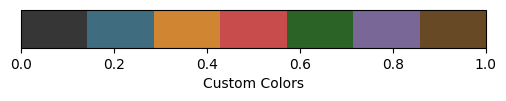

In [33]:
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
from matplotlib.colors import ListedColormap
from matplotlib.lines import Line2D
from scipy.stats import gaussian_kde
import seaborn as sns

COLORS = {
    "gray": "#363636",
    "blue": "#406c80",
    "orange": "#cf8532",
    "red": "#c94c4c",
    "green": "#2B6327",
    "purple": "#786797",
    "brown": "#684925"
}

# Define the custom colormap
custom_cmap = ListedColormap([COLORS['gray'], COLORS['blue'], COLORS['orange'],
                              COLORS['red'], COLORS['green'], COLORS['purple'],
                              COLORS['brown']],
                             name='custom_colors')

# Visualize the color map
fig, ax = plt.subplots(figsize=(6, 1))
fig.subplots_adjust(bottom=0.5)

cb = plt.colorbar(plt.cm.ScalarMappable(cmap=custom_cmap),
                  cax=ax, orientation='horizontal')
cb.set_label('Custom Colors')
plt.show()

def print_color(text, color="green"):
    colors = {
        "green": "\033[92m",
        "red": "\033[91m",
        "blue": "\033[94m",
        "yellow": "\033[93m"
    }
    print(f"{colors.get(color, '')}{text}\033[0m")

## 2. Hyperparameter Distribution

### 2.1 Batch Size Distribution per Model

We analyze how batch size values are distributed across different runs and models.  
This chart shows the number of experiments conducted for each combination of model and batch size.  

📌 Plot saved to results/images/batch_distribution_bar.png


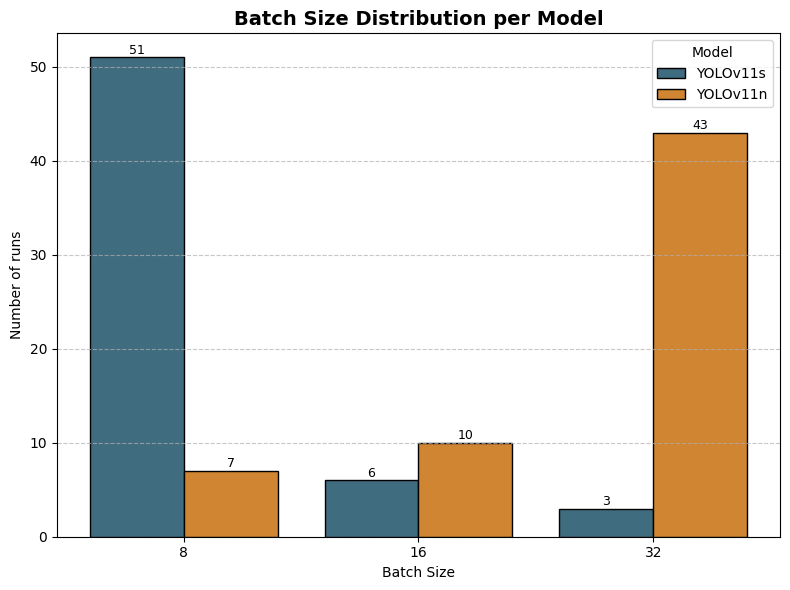

In [7]:
def plot_batch_distribution_bar_multiple(df):
    """
    Show the distribution of 'batch_size' as a grouped bar chart.
    
    Each bar represents a model for a given batch size, with the number of runs
    displayed above each bar.
    
    Args:
        df (pd.DataFrame): Must contain the columns ['run_code', 'model', 'batch_size']
    """
    
    # Take the last batch value for each run
    run_batch = df.groupby(["run_code", "model"], as_index=False)["batch_size"].last()

    # List of unique batch sizes, sorted
    batch_sizes = sorted(run_batch["batch_size"].unique())
    models = run_batch["model"].unique()
    n_models = len(models)
    x = range(len(batch_sizes))
    width = 0.8 / n_models  # width of grouped bars

    fig, ax = plt.subplots(figsize=(8, 6))

    # Cyclic colors for models
    color_list = [COLORS["blue"], COLORS["orange"], COLORS["red"], COLORS["green"], COLORS["gray"]]
    
    for i, model in enumerate(models):
        model_data = run_batch[run_batch["model"] == model]
        counts = model_data["batch_size"].value_counts().reindex(batch_sizes, fill_value=0)

        bars = ax.bar(
            [pos + i*width for pos in x],
            counts.values,
            width=width,
            color=color_list[i % len(color_list)],
            edgecolor="black",
            label=model
        )

        # Numbers above the bars
        for bar in bars:
            height = bar.get_height()
            ax.text(bar.get_x() + bar.get_width()/2, height + 0.05, f"{int(height)}",
                    ha="center", va="bottom", fontsize=9)

    # Center X-axis labels
    ax.set_xticks([pos + width*(n_models/2 - 0.5) for pos in x])
    ax.set_xticklabels(batch_sizes)
    ax.set_xlabel("Batch Size")
    ax.set_ylabel("Number of runs")
    ax.set_title("Batch Size Distribution per Model", fontsize=14, fontweight="bold")
    ax.grid(axis="y", linestyle="--", alpha=0.7)
    ax.legend(title="Model")

    plt.tight_layout()

    # Save plot as PNG at 300 dpi
    output_path = "results/images/batch_distribution_bar.png"
    fig.savefig(output_path, dpi=300)
    print(f"📌 Plot saved to {output_path}")

    plt.show()

# --- Example usage ---
plot_batch_distribution_bar_multiple(df)

### 2.2 Optimizer Distribution per Model

We visualize the distribution of optimizers used in the experiments.  
Each bar represents the number of runs that used a particular optimizer for each model.  

📌 Plot saved to results/images/optimizer_distribution_grouped.png


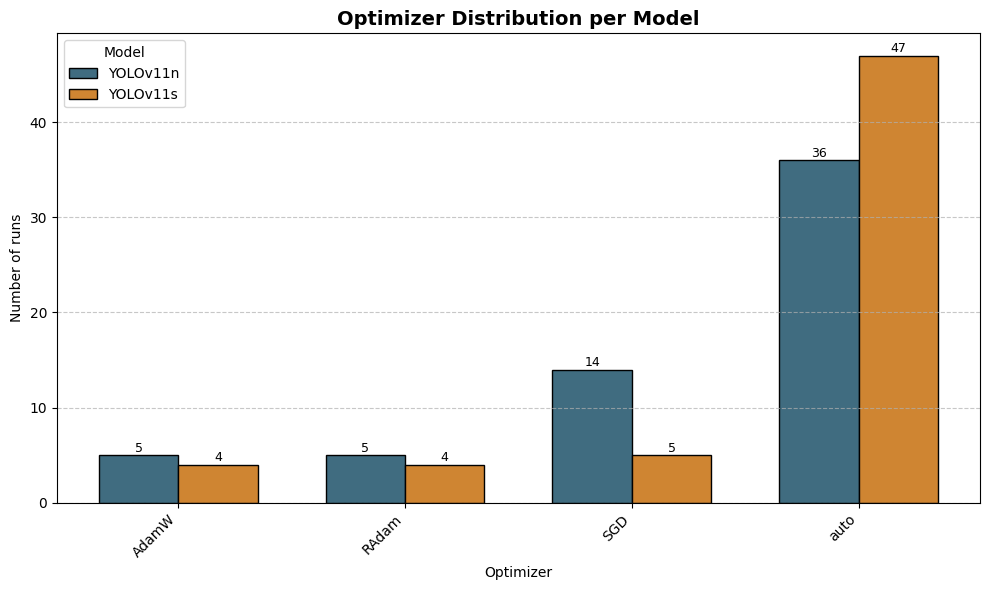

In [12]:
def plot_optimizer_distribution_grouped(df):
    """
    Show the distribution of optimizers as a grouped bar chart,
    with blue and orange bars for each model and numbers displayed above each bar.
    
    Args:
        df (pd.DataFrame): Must contain ['run_code', 'model', 'optimizer']
    """
    # Take the last optimizer used for each run
    run_opts = df.groupby(["run_code", "model"], as_index=False)["optimizer"].last()

    # Pivot table: optimizer x model
    counts = run_opts.groupby(["optimizer", "model"]).size().unstack(fill_value=0)

    optimizers = counts.index
    models = counts.columns
    x = range(len(optimizers))
    width = 0.35  # width of bars

    fig, ax = plt.subplots(figsize=(10, 6))

    # Draw grouped bars (blue and orange for models)
    colors = [COLORS["blue"], COLORS["orange"]]
    for i, model in enumerate(models):
        bars = ax.bar(
            [pos + i * width for pos in x],
            counts[model],
            width=width,
            label=model,
            color=colors[i % 2],
            edgecolor="black"
        )
        # Numbers above each bar
        for bar in bars:
            height = bar.get_height()
            ax.text(
                bar.get_x() + bar.get_width()/2,
                height + 0.05,
                f"{int(height)}",
                ha="center", va="bottom", fontsize=9
            )

    # Center X-axis labels
    ax.set_xticks([pos + width / 2 for pos in x])
    ax.set_xticklabels(optimizers, rotation=45, ha="right")

    # Title and axes labels
    ax.set_title("Optimizer Distribution per Model", fontsize=14, fontweight="bold")
    ax.set_xlabel("Optimizer")
    ax.set_ylabel("Number of runs")
    ax.grid(axis="y", linestyle="--", alpha=0.7)

    # Legend
    ax.legend(title="Model")

    plt.tight_layout()

    # Save plot as PNG at 300 dpi
    fig.savefig("results/images/optimizer_distribution_grouped.png", dpi=300)
    print("📌 Plot saved to results/images/optimizer_distribution_grouped.png")

    plt.show()

# --- Example usage ---
plot_optimizer_distribution_grouped(df)

### 2.3 Learning Rate Distribution (lr0 and lrf)

The boxplots show the distribution of initial learning rate (lr0) and final learning rate (lrf) for each model.  
The boxes represent the quartiles, green dots indicate the mean, and the black line marks the median.  

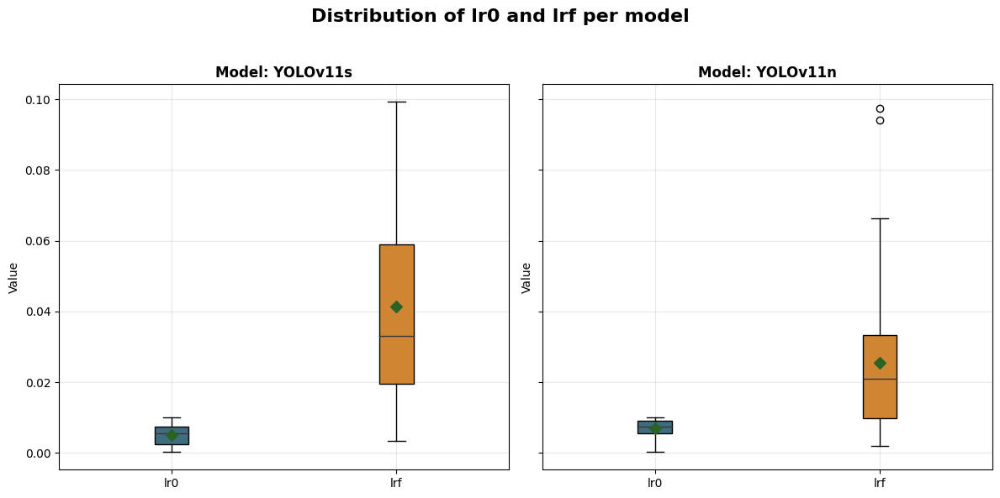

In [13]:
def plot_lr0_lrf_distribution_per_model(df):
    """
    Boxplot showing the distribution of lr0 and lrf for each model.
    Groups by run to avoid duplicates (values repeated across epochs).

    Args:
        df (pd.DataFrame): DataFrame containing ['run_code', 'model', 'lr0', 'lrf']
    """
    # Collapse per run: take one value per run (here using last, first would also work)
    run_lrs = df.groupby(["run_code", "model"], as_index=False)[["lr0", "lrf"]].last()

    models = run_lrs["model"].unique()
    n_models = len(models)

    fig, axes = plt.subplots(1, n_models, figsize=(6 * n_models, 6), sharey=True)

    if n_models == 1:
        axes = [axes]  # if there is only one model, keep as a list for iteration

    for ax, model in zip(axes, models):
        model_data = run_lrs[run_lrs["model"] == model]

        data = [model_data["lr0"].dropna().values,
                model_data["lrf"].dropna().values]

        labels = ["lr0", "lrf"]
        colors = [COLORS["blue"], COLORS["orange"]]

        # Boxplot
        bp = ax.boxplot(data, labels=labels, patch_artist=True,
                        medianprops=dict(color=COLORS["gray"], linewidth=1))

        # Color the boxes
        for patch, color in zip(bp["boxes"], colors):
            patch.set_facecolor(color)

        # Mean (green diamond)
        means = [d.mean() for d in data]
        ax.scatter(range(1, len(means)+1), means, color=COLORS["green"], marker="D", s=50, zorder=3)

        # Title and grid
        ax.set_title(f"Model: {model}", fontsize=12, fontweight="bold")
        ax.set_ylabel("Value")
        ax.grid(True, alpha=0.3)

    plt.suptitle("Distribution of lr0 and lrf per model", fontsize=16, fontweight="bold")
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()


# --- Example usage ---
plot_lr0_lrf_distribution_per_model(df)

### 2.4 Distribution of Other Hyperparameters

We analyze the distribution of dropout, weight decay, and momentum using both boxplots and violin plots for a more complete visualization of the probability density.  

📌 Plot saved to results/images/hyperparams_all_box.png


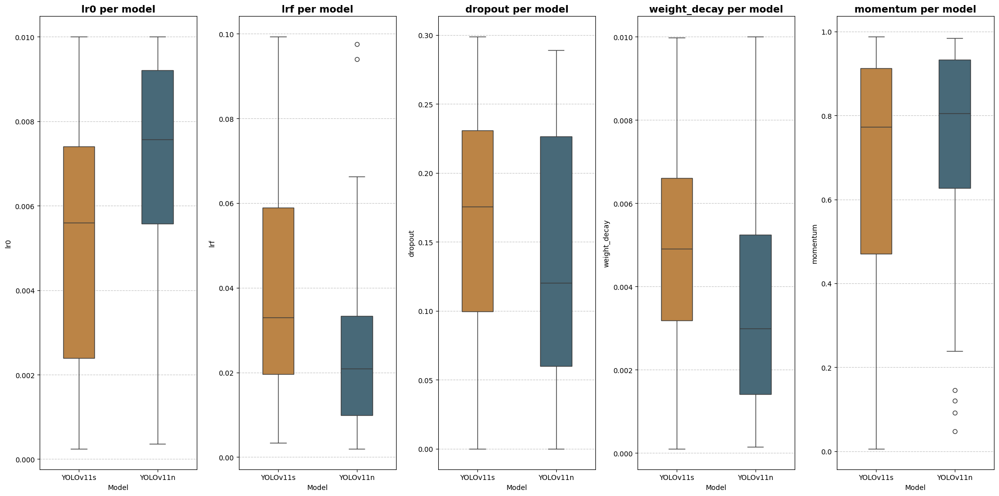

📌 Plot saved to results/images/hyperparams_all_violin.png


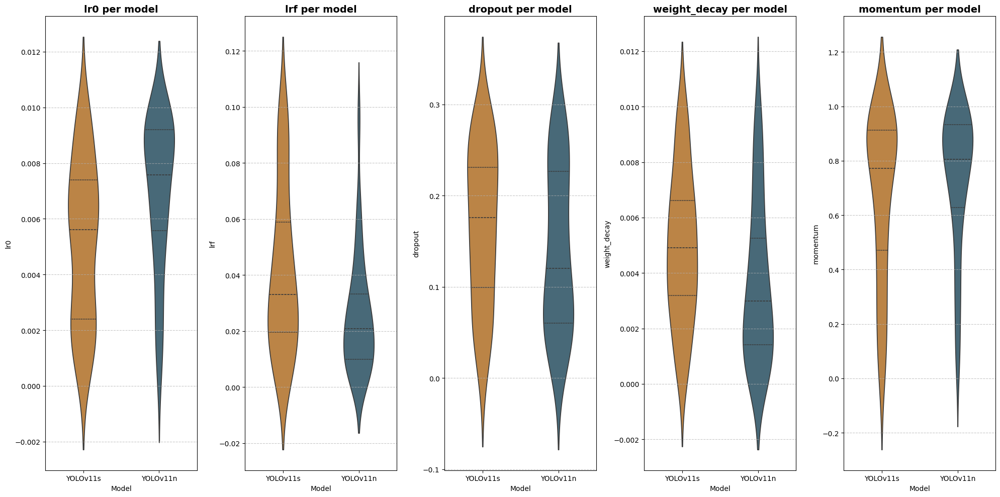

In [14]:
def plot_hyperparams_all(df, params=["lr0", "lrf", "dropout", "weight_decay", "momentum"], kind="box"):
    """
    Show the distribution of multiple hyperparameters per model
    in a single figure with subplots, with taller and narrower figure
    and thinner boxplots.
    
    Args:
        df (pd.DataFrame): Must contain ['run_code', 'model'] + params
        params (list of str): Names of the hyperparameter columns
        kind (str): "box" or "violin"
    """
    n_params = len(params)
    # Taller and narrower figure
    fig, axes = plt.subplots(1, n_params, figsize=(4*n_params, 10), sharey=False)
    
    # Ensure axes is always a list even if n_params=1
    if n_params == 1:
        axes = [axes]
    
    models = df["model"].unique()
    color_list = [COLORS["blue"], COLORS["orange"], COLORS["red"], COLORS["green"], COLORS["gray"]]
    palette = {model: color_list[i % len(color_list)] for i, model in enumerate(models)}
    
    for ax, param in zip(axes, params):
        run_param = df.groupby(["run_code", "model"], as_index=False)[param].last()
        
        if kind == "box":
            sns.boxplot(
                data=run_param,
                x="model",
                y=param,
                hue="model",
                palette=palette,
                legend=False,
                ax=ax,
                width=0.4  # thinner boxes
            )
        elif kind == "violin":
            sns.violinplot(
                data=run_param,
                x="model",
                y=param,
                hue="model",
                palette=palette,
                legend=False,
                ax=ax,
                inner="quartile",
                width=0.4  # thinner violins
            )
        else:
            raise ValueError("kind must be 'box' or 'violin'")
        
        ax.set_title(f"{param} per model", fontsize=14, fontweight="bold")
        ax.set_xlabel("Model")
        ax.set_ylabel(param)
        ax.grid(axis="y", linestyle="--", alpha=0.7)
    
    plt.tight_layout()
    
    # Save plot as PNG at 300 dpi
    filename = f"results/images/hyperparams_all_{kind}.png"
    fig.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")
    
    plt.show()

# --- Example usage ---
plot_hyperparams_all(df, kind="box")
plot_hyperparams_all(df, kind="violin")


### 2.5 Univariate Distributions

1D visualizations with kernel density estimation to better understand the shape of hyperparameter distributions.  
Black and green dots indicate the mean and median, respectively.  

📌 Plot saved to results/images/momentum_distribution.png


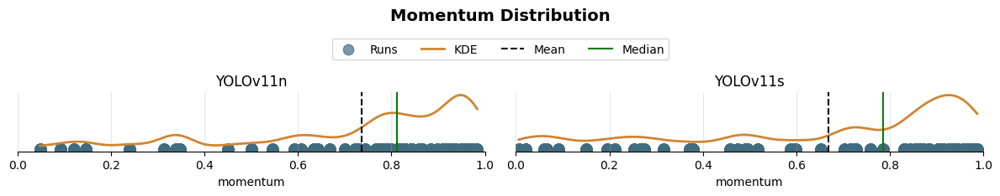

📌 Plot saved to results/images/weight_decay_distribution.png


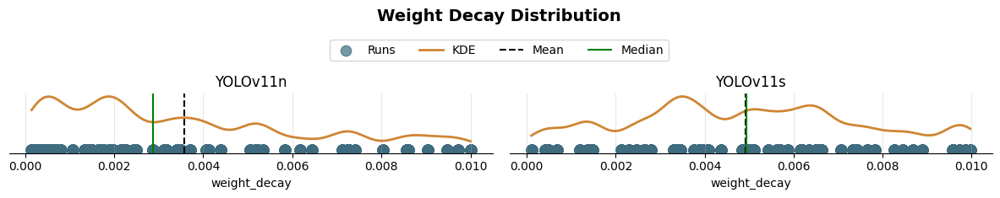

📌 Plot saved to results/images/lr0_distribution.png


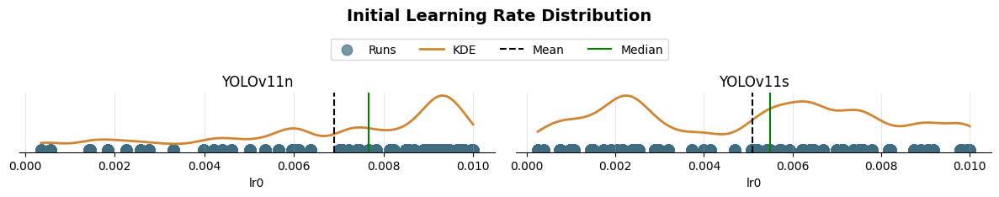

📌 Plot saved to results/images/lrf_distribution.png


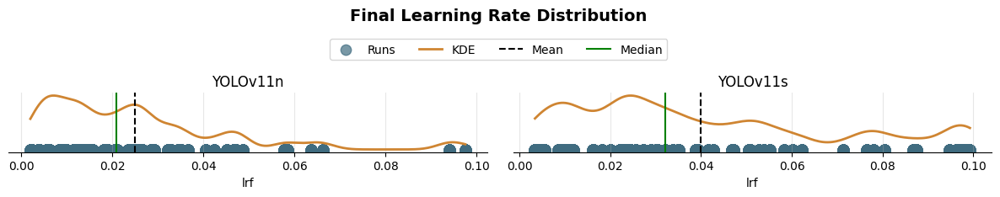

📌 Plot saved to results/images/dropout_distribution.png


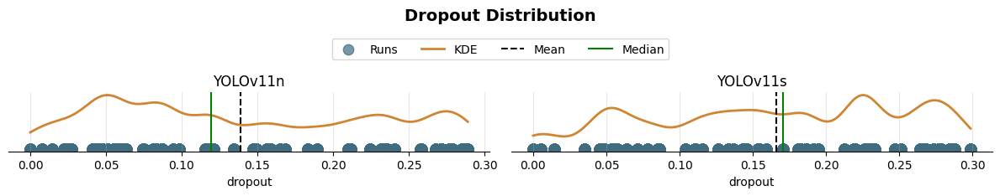

In [15]:
def plot_distribution_1d(df, model_col, value_col, title="Distribution", xlim=None):
    """
    Plot a 1D distribution of a variable for each model (or category) with an overlaid KDE.
    All points are plotted on the x-axis (y=0). Removes subplot borders except for the x-axis.

    Args:
        df (pd.DataFrame): DataFrame with at least two columns: one for models/categories and one for values
        model_col (str): Name of the column containing models/categories
        value_col (str): Name of the column containing the values to plot
        title (str): Overall plot title
        xlim (tuple, optional): Tuple (xmin, xmax) to set x-axis limits, default is None
    """
    models = df[model_col].unique()

    fig, axes = plt.subplots(1, len(models), figsize=(6*len(models), 2), sharey=True)
    if len(models) == 1:
        axes = [axes]

    for ax, model in zip(axes, models):
        values = df[df[model_col] == model][value_col].values

        ax.scatter(values, np.zeros_like(values), color=COLORS['blue'], s=80, alpha=0.7, label='Runs')

        if len(values) > 1:
            kde = gaussian_kde(values)
            x_grid = np.linspace(values.min(), values.max(), 200)
            density = kde(x_grid)
            density = density / density.max() * 0.2
            ax.plot(x_grid, density, color=COLORS['orange'], lw=2, label='KDE')

        ax.axvline(values.mean(), color='black', linestyle='--', lw=1.5, label='Mean')
        ax.axvline(np.median(values), color='green', linestyle='-', lw=1.5, label='Median')

        ax.set_yticks([])
        ax.set_xlabel(value_col)
        ax.set_title(f'{model}')
        ax.grid(True, alpha=0.3)

        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['left'].set_visible(False)
        ax.spines['bottom'].set_visible(True)

        if xlim is not None:
            ax.set_xlim(xlim)

    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', ncol=4, bbox_to_anchor=(0.5, 1.0))
    
    plt.suptitle(title, fontsize=14, fontweight='bold', y=1.15)
    plt.tight_layout()

    # Save plot as PNG at 300 dpi
    filename = f"results/images/{value_col}_distribution.png"
    fig.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")
    
    plt.show()

# --- Example usage ---
plot_distribution_1d(df, model_col='model', value_col='momentum', title="Momentum Distribution", xlim=(0, 1))
plot_distribution_1d(df, model_col='model', value_col='weight_decay', title="Weight Decay Distribution")
plot_distribution_1d(df, model_col='model', value_col='lr0', title="Initial Learning Rate Distribution")
plot_distribution_1d(df, model_col='model', value_col='lrf', title="Final Learning Rate Distribution")
plot_distribution_1d(df, model_col='model', value_col='dropout', title="Dropout Distribution")

## 3. Temporal Analysis of Training

### 3.1 Average Number of Epochs per Fold

This chart shows the average number of epochs required for each fold and model, providing insights into training stability across folds.  

In [13]:
def desaturate_hex(hex_color: str, amount: float) -> str:
    """
    Desatura un colore hex interpolando verso il grigio.
    
    amount = 0   → colore originale
    amount = 1   → completamente grigio
    """
    # Rimuovi il simbolo #
    hex_color = hex_color.lstrip('#')
    
    # Converti in RGB (0–255)
    r = int(hex_color[0:2], 16)
    g = int(hex_color[2:4], 16)
    b = int(hex_color[4:6], 16)

    # Calcolo grigio secondo luminanza percettiva
    gray = int(0.299*r + 0.587*g + 0.114*b)

    # Interpolazione verso il grigio
    r2 = int(r + (gray - r) * amount)
    g2 = int(g + (gray - g) * amount)
    b2 = int(b + (gray - b) * amount)

    # Ritorna nuovo hex
    return f"#{r2:02X}{g2:02X}{b2:02X}"

📌 Plot saved to results/images/mean_epochs_per_fold.png


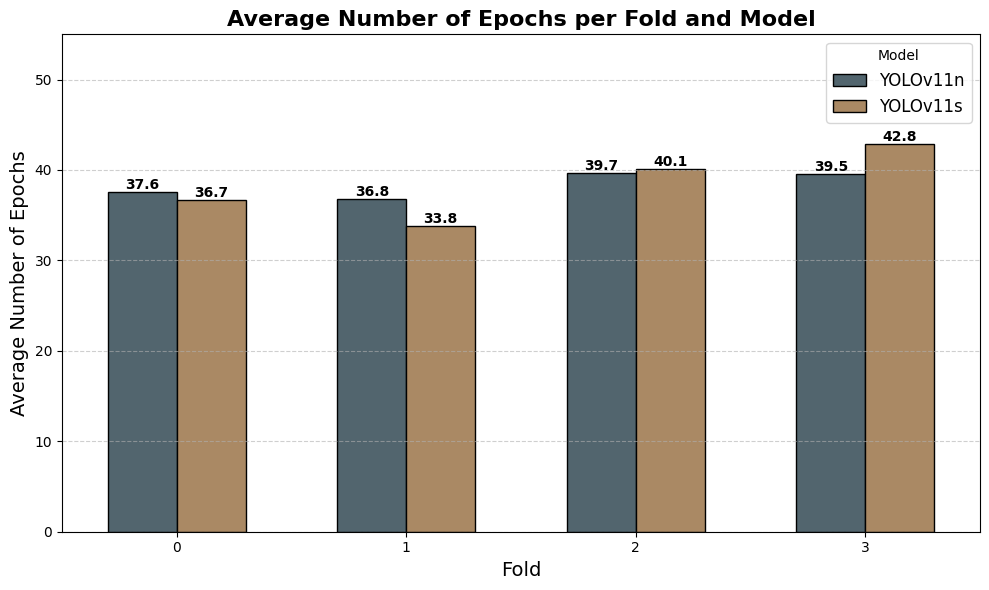

In [16]:
def plot_mean_epochs_per_fold(df):
    """
    Create a bar plot showing the average number of epochs per fold and model.
    Expects df to have the columns: ['model', 'fold_number', 'epoch'].

    Args:
        df (pd.DataFrame): Input dataframe
    """
    # Compute mean number of epochs per fold and model
    mean_epochs = (
        df.groupby(['model', 'fold_number'])['epoch']
        .mean()
        .reset_index()
    )

    plt.figure(figsize=(10,6))
    sns.barplot(
        data=mean_epochs,
        x='fold_number',
        y='epoch',
        hue='model',
        palette=[desaturate_hex(COLORS['blue'], amount=0.4) , desaturate_hex(COLORS['orange'], amount=0.4)],
        edgecolor='black',
        width=0.6  # slightly narrower bars
    )

    # Beautification
    plt.title("Average Number of Epochs per Fold and Model", fontsize=16, fontweight="bold")
    plt.xlabel("Fold", fontsize=14)
    plt.ylabel("Average Number of Epochs", fontsize=14)
    plt.grid(axis='y', linestyle='--', alpha=0.6)
    plt.legend(title="Model", fontsize=12)

    # Numeric labels above bars
    for p in plt.gca().patches:
        if p.get_height() > 0.0:
            plt.gca().annotate(
                f"{p.get_height():.1f}",
                (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='bottom',
                fontsize=10, fontweight='bold'
            )
    
    plt.ylim(0, 55)
    plt.tight_layout()

    # Save plot as PNG at 300 dpi
    filename = "results/images/mean_epochs_per_fold.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()

# --- Example usage ---
plot_mean_epochs_per_fold(df)

### 3.2 Training Time per Configuration

We analyze the total training time as a function of optimizer and batch size.  
The time is aggregated by summing all folds for each hyperparameter combination.  

📌 Plot saved to results/images/training_time_by_optimizer_and_batch.png


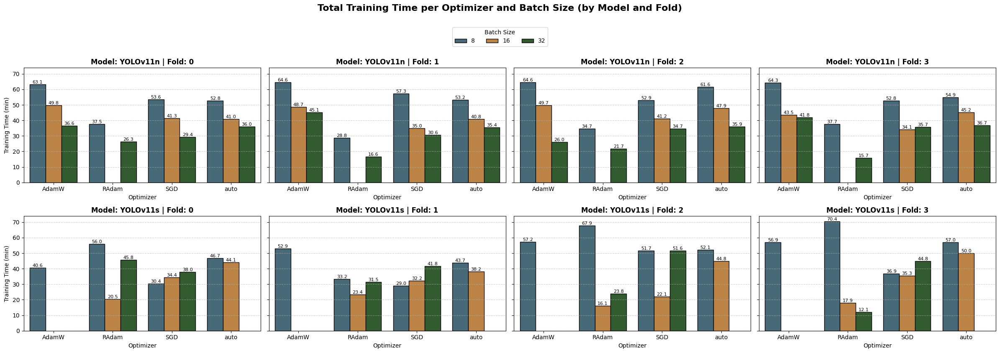

In [17]:
def plot_training_time_by_optimizer_and_batch(df):
    """
    Create a grid of subplots (models x folds).
    In each subplot, the X-axis shows optimizers and the Y-axis shows total training time (in minutes).
    Each optimizer has multiple bars representing different batch sizes.
    """
    # --- Step 1: extract the final epoch time for each run ---
    run_last = df.sort_values("epoch").groupby(["model", "run_name", "fold_number"]).tail(1)
    run_last = run_last.assign(training_time_min=run_last["time"] / 60.0)

    # --- Step 2: aggregate ---
    grouped = (
        run_last.groupby(['model', 'fold_number', 'optimizer', 'batch_size'])['training_time_min']
        .mean()
        .reset_index()
    )

    models = sorted(grouped['model'].unique())
    folds = sorted(grouped['fold_number'].unique())

    n_rows = len(models)
    n_cols = len(folds)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(6*n_cols, 4*n_rows), sharey=True)

    # Handle axes shape
    if n_rows == 1 and n_cols == 1:
        axes = np.array([[axes]])
    elif n_rows == 1:
        axes = np.array([axes])
    elif n_cols == 1:
        axes = np.array([[ax] for ax in axes])

    palette = [COLORS['blue'], COLORS['orange'], COLORS['green']]

    for i, model in enumerate(models):
        for j, fold in enumerate(folds):
            ax = axes[i, j]
            data_sub = grouped[(grouped['model'] == model) & (grouped['fold_number'] == fold)]

            if data_sub.empty:
                ax.set_visible(False)
                continue

            sns.barplot(
                data=data_sub,
                x='optimizer',
                y='training_time_min',
                hue='batch_size',
                palette=palette,
                ax=ax,
                edgecolor="black"
            )

            # Remove internal legend
            ax.get_legend().remove()

            ax.set_title(f"Model: {model} | Fold: {fold}", fontsize=12, fontweight="bold")
            ax.set_xlabel("Optimizer")
            if j == 0:
                ax.set_ylabel("Training Time (min)")
            else:
                ax.set_ylabel("")
            ax.grid(axis='y', linestyle='--', alpha=0.6)

            # Numeric labels above bars
            for p in ax.patches:
                height = p.get_height()
                if height > 0:
                    ax.annotate(
                        f"{height:.1f}",
                        (p.get_x() + p.get_width()/2., height),
                        ha='center', va='bottom',
                        fontsize=8
                    )

    # Single legend
    handles, labels = axes[0,0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', ncol=len(palette), title="Batch Size", bbox_to_anchor=(0.5, 0.99))

    plt.suptitle("Total Training Time per Optimizer and Batch Size (by Model and Fold)",
                 fontsize=16, fontweight="bold", y=1.05)
    plt.tight_layout(rect=[0, 0, 1, 0.95])

    # Save figure as PNG
    filename = "results/images/training_time_by_optimizer_and_batch.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()

# --- Example usage ---
plot_training_time_by_optimizer_and_batch(df)

📌 Plot saved to results/images/training_time_by_model_optimizer_batch.png


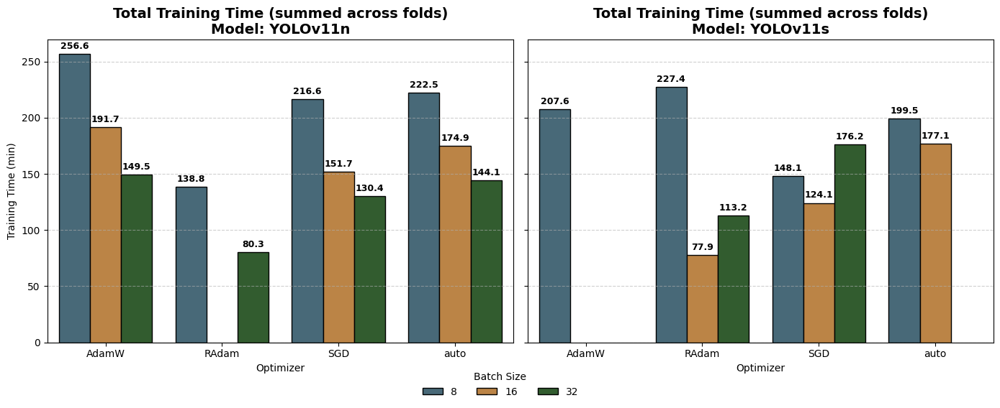

In [18]:
def plot_training_time_by_model_optimizer_batch(df):
    """
    Create two subplots (one per model) with bars showing 
    total training time (in minutes) per optimizer and batch size,
    summing the average times across all folds.
    """
    # --- Step 1: extract the final epoch time for each run ---
    run_last = df.sort_values("epoch").groupby(["model", "run_name", "fold_number"]).tail(1)
    run_last = run_last.assign(training_time_min=run_last["time"] / 60.0)

    # --- Step 2: aggregate per fold ---
    agg_df = (
        run_last.groupby(['model', 'optimizer', 'batch_size', 'fold_number'])['training_time_min']
        .mean()
        .reset_index()
    )
    # --- Step 3: sum times across folds ---
    agg_df = (
        agg_df.groupby(['model', 'optimizer', 'batch_size'])['training_time_min']
        .sum()
        .reset_index()
    )

    # --- Define custom colors ---
    unique_batches = sorted(agg_df['batch_size'].unique())
    color_map = {
        b: c for b, c in zip(unique_batches, [COLORS['blue'], COLORS['orange'], COLORS['green']])
    }

    # --- Plot ---
    models = sorted(agg_df['model'].unique())
    fig, axes = plt.subplots(1, len(models), figsize=(7 * len(models), 6), sharey=True)
    if len(models) == 1:
        axes = [axes]

    for ax, model in zip(axes, models):
        sub = agg_df[agg_df['model'] == model]

        sns.barplot(
            data=sub,
            x='optimizer', y='training_time_min', hue='batch_size',
            palette=[color_map[b] for b in sub['batch_size'].unique()],
            ax=ax, edgecolor='black'
        )
        
        ax.set_title(f"Total Training Time (summed across folds)\nModel: {model}", fontsize=14, fontweight="bold")
        ax.set_xlabel("Optimizer")
        ax.set_ylabel("Training Time (min)" if ax == axes[0] else "")
        ax.grid(axis='y', linestyle='--', alpha=0.6)
        ax.legend_.remove()
        
        # --- Annotate bar values ---
        for p in ax.patches:
            height = p.get_height()
            if np.isnan(height) or height <= 0:
                continue
            ax.annotate(
                f"{height:.1f}",
                (p.get_x() + p.get_width() / 2., height),
                ha='center', va='bottom',
                fontsize=9, fontweight='bold',
                xytext=(0, 3), textcoords='offset points'
            )
    
    # External legend
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, title="Batch Size", loc='lower center', ncol=len(labels), frameon=False, bbox_to_anchor=(0.5, -0.05))
    
    plt.tight_layout(rect=[0, 0, 1, 0.9])

    # --- Save figure ---
    filename = "results/images/training_time_by_model_optimizer_batch.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()

# --- Example usage ---
plot_training_time_by_model_optimizer_batch(df)


## 4. Analysis of Training Curves

### 4.1 Evolution of Losses During Training

We visualize the trends of the different loss components (box, classification, DFL) for both training and validation, aggregating runs by hyperparameter configuration.  

📌 Plot saved to results/images/YOLOv11n_cols_dynamic_grid.png


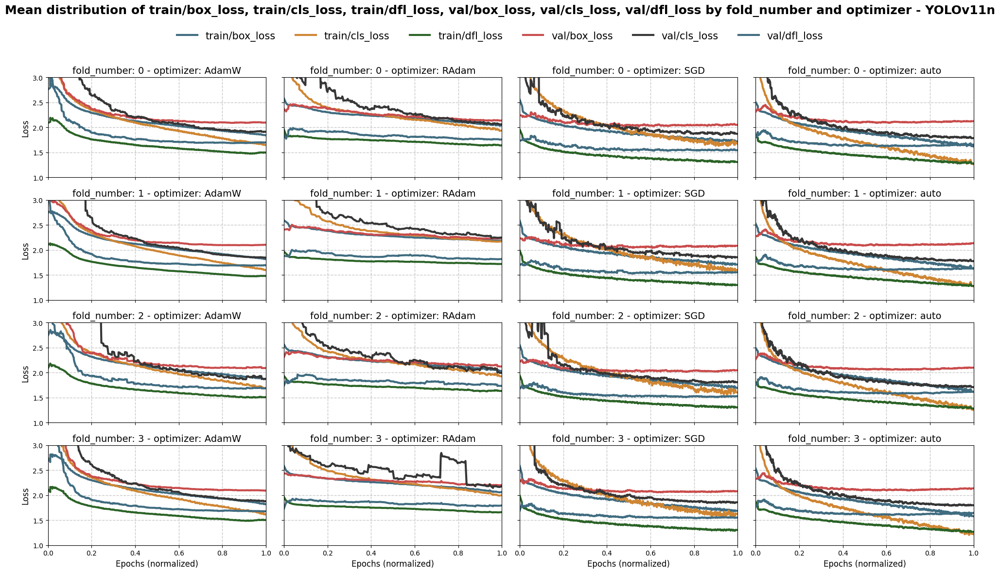

In [19]:
def plot_model_cols_dynamic_grid(
    df, 
    model_name, 
    cols, 
    row_var="fold_number", 
    col_var="optimizer", 
    smoothing_window=5, 
    y_label="Loss",
    y_limits=None  # New parameter: tuple (ymin, ymax)
):
    """
    Plot selected columns (losses or metrics) for a specific model, applying smoothing,
    with a subplot grid defined by two chosen variables.
    """
    # Filter for the specified model
    df_model = df[df["model"] == model_name]

    rows = sorted(df_model[row_var].unique())
    cols_unique = sorted(df_model[col_var].unique())

    n_rows = len(rows)
    n_cols = len(cols_unique)

    fig, axes = plt.subplots(n_rows, n_cols, figsize=(5*n_cols, 3*n_rows), sharex=True, sharey=True)

    # Handle single subplot case
    if n_rows == 1 and n_cols == 1:
        axes = np.array([[axes]])
    elif n_rows == 1:
        axes = np.array([axes])
    elif n_cols == 1:
        axes = np.array([[ax] for ax in axes])

    color_list = [COLORS["blue"], COLORS["orange"], COLORS["green"], COLORS["red"], COLORS["gray"]]

    for i, r in enumerate(rows):
        for j, c in enumerate(cols_unique):
            ax = axes[i, j]
            df_sub = df_model[(df_model[row_var] == r) & (df_model[col_var] == c)]

            if df_sub.empty:
                ax.set_visible(False)
                continue

            grouped = df_sub.groupby("normalized_epoch")[cols].mean()
            grouped_smooth = grouped.rolling(window=smoothing_window, min_periods=1).mean()

            for k, col_name in enumerate(cols):
                color = color_list[k % len(color_list)]
                ax.plot(grouped_smooth.index, grouped_smooth[col_name], label=col_name, color=color, linewidth=3.0)

            ax.set_title(f"{row_var}: {r} - {col_var}: {c}", fontsize=14)
            if i == n_rows-1:
                ax.set_xlabel("Epochs (normalized)", fontsize=12)
            if j == 0:
                ax.set_ylabel(y_label, fontsize=12)
            ax.grid(True, linestyle="--", linewidth=1.0, alpha=0.7)
            ax.set_xlim(0, 1)
            if y_limits is not None:
                ax.set_ylim(y_limits)

    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', ncol=len(cols), fontsize=15, frameon=False, bbox_to_anchor=(0.5, 0.95))

    plt.suptitle(f"Mean distribution of {', '.join(cols)} by {row_var} and {col_var} - {model_name}",
                 fontsize=18, fontweight="bold")
    plt.tight_layout(rect=[0, 0, 1, 0.92])

    # --- Save figure ---
    filename = f"results/images/{model_name}_cols_dynamic_grid.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()

# --- Example usage ---
plot_model_cols_dynamic_grid(df, model_name="YOLOv11n", 
                             cols=[
                                     'train/box_loss', 
                                     'train/cls_loss', 
                                     'train/dfl_loss',
                                     'val/box_loss', 
                                     'val/cls_loss', 
                                     'val/dfl_loss'
                                 ],
                             row_var='fold_number',
                             col_var='optimizer',
                             smoothing_window=20,
                             y_label='Loss',
                             y_limits=(1, 3)
)

📌 Plot saved to results/images/YOLOv11s_cols_dynamic_grid.png


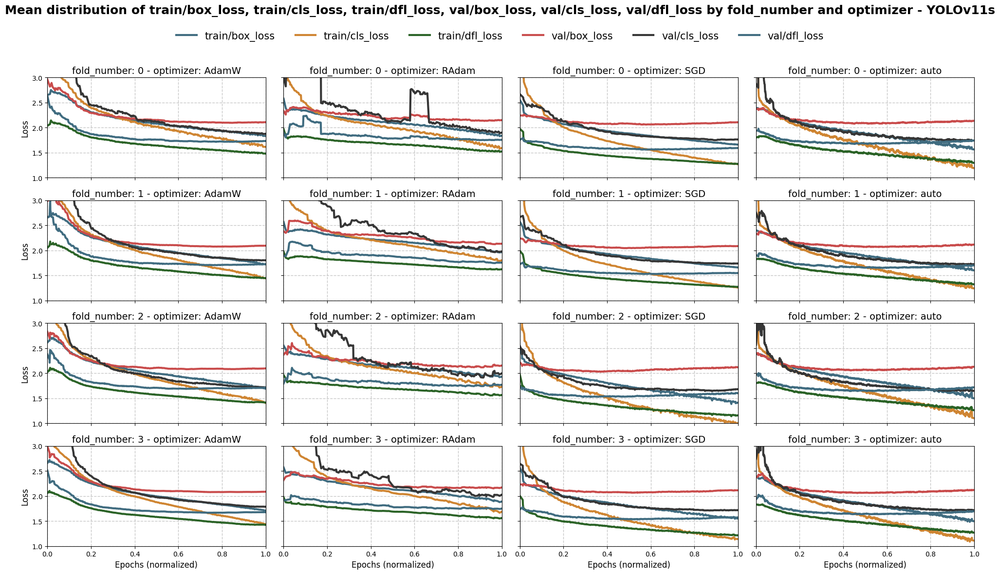

In [20]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11s", 
                             cols=[
                                     'train/box_loss', 
                                     'train/cls_loss', 
                                     'train/dfl_loss',
                                     'val/box_loss', 
                                     'val/cls_loss', 
                                     'val/dfl_loss'
                                 ],
                             row_var='fold_number',
                             col_var='optimizer',
                             smoothing_window=20,
                             y_label='Loss',
                             y_limits=(1, 3)
)

📌 Plot saved to results/images/YOLOv11n_cols_dynamic_grid.png


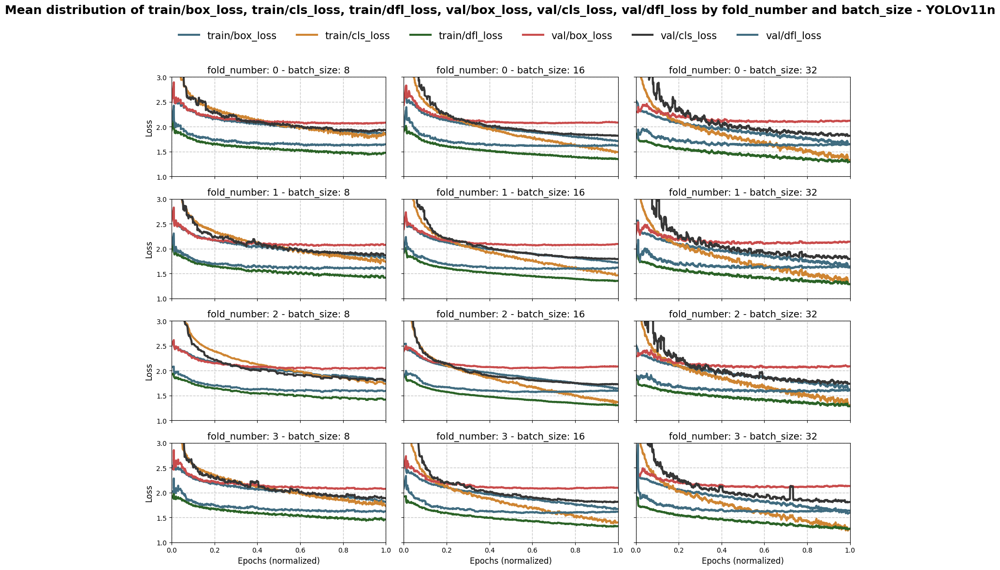

In [21]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11n", 
                             cols=[
                                     'train/box_loss', 
                                     'train/cls_loss', 
                                     'train/dfl_loss',
                                     'val/box_loss', 
                                     'val/cls_loss', 
                                     'val/dfl_loss'
                                 ],
                             row_var='fold_number',
                             col_var='batch_size',
                             smoothing_window=20,
                             y_label='Loss',
                             y_limits=(1, 3)
)

📌 Plot saved to results/images/YOLOv11s_cols_dynamic_grid.png


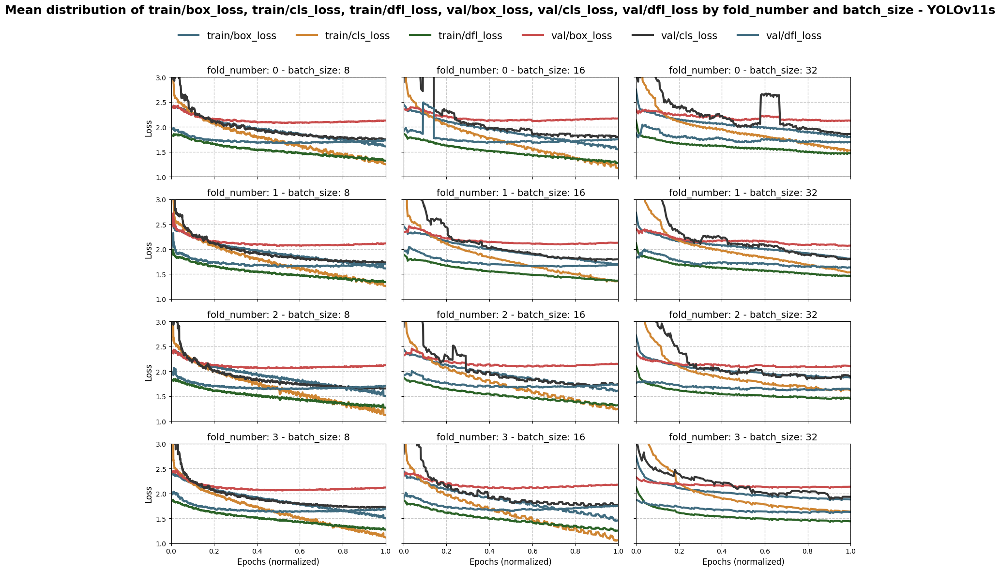

In [22]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11s", 
                             cols=[
                                     'train/box_loss', 
                                     'train/cls_loss', 
                                     'train/dfl_loss',
                                     'val/box_loss', 
                                     'val/cls_loss', 
                                     'val/dfl_loss'
                                 ],
                             row_var='fold_number',
                             col_var='batch_size',
                             smoothing_window=20,
                             y_label='Loss',
                             y_limits=(1, 3)
)

📌 Plot saved to results/images/YOLOv11n_cols_dynamic_grid.png


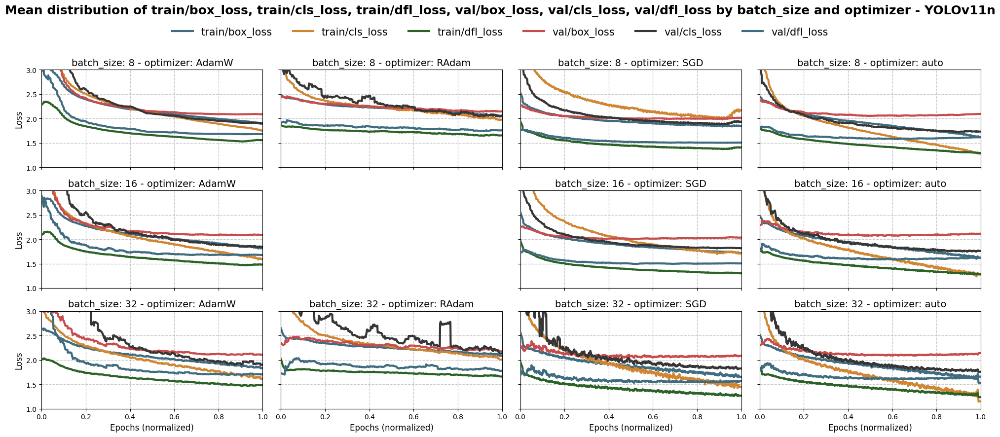

In [23]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11n", 
                             cols=[
                                     'train/box_loss', 
                                     'train/cls_loss', 
                                     'train/dfl_loss',
                                     'val/box_loss', 
                                     'val/cls_loss', 
                                     'val/dfl_loss'
                                 ],
                             row_var='batch_size',
                             col_var='optimizer',
                             smoothing_window=20,
                             y_label='Loss',
                             y_limits=(1, 3)
)

📌 Plot saved to results/images/YOLOv11s_cols_dynamic_grid.png


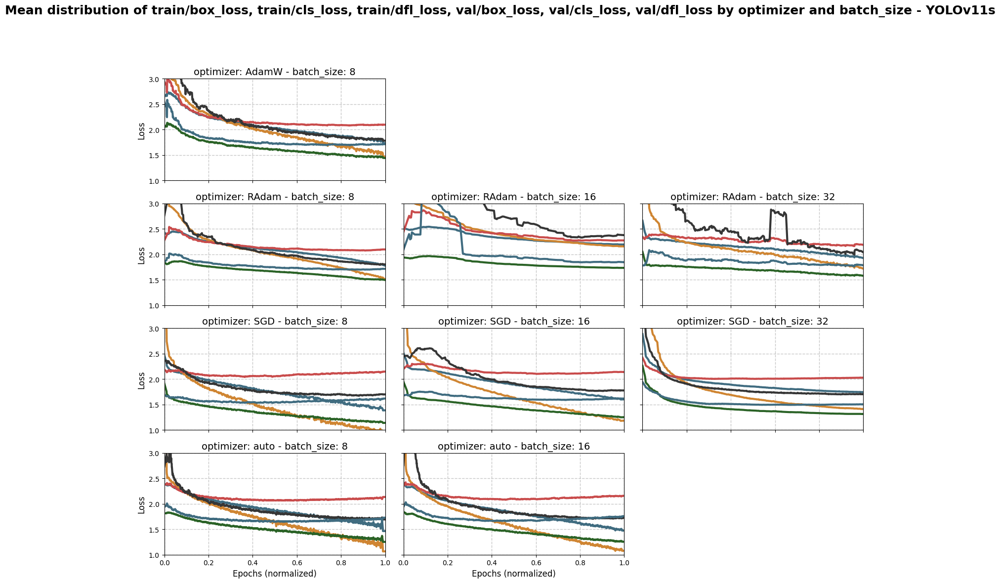

In [24]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11s", 
                             cols=[
                                     'train/box_loss', 
                                     'train/cls_loss', 
                                     'train/dfl_loss',
                                     'val/box_loss', 
                                     'val/cls_loss', 
                                     'val/dfl_loss'
                                 ],
                             row_var='optimizer',
                             col_var='batch_size',
                             smoothing_window=20,
                             y_label='Loss',
                             y_limits=(1, 3)
)

### 4.2 Evolution of Metrics During Training

We analyze the evolution of performance metrics (precision, recall, mAP50) during training to identify patterns and convergence.  

📌 Plot saved to results/images/YOLOv11n_cols_dynamic_grid.png


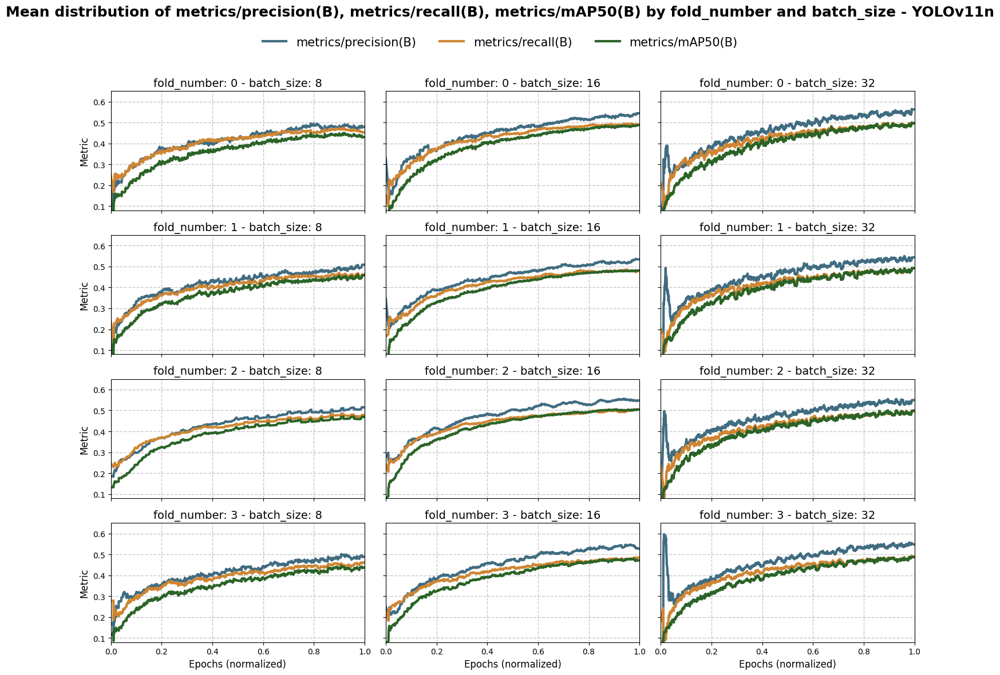

In [25]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11n", 
                             cols=[
                                 'metrics/precision(B)', 
                                 'metrics/recall(B)', 
                                 'metrics/mAP50(B)'
                                 ],
                             row_var='fold_number',
                             col_var='batch_size',
                             smoothing_window=20,
                             y_label='Metric',
                             y_limits=(0.08, 0.65)
)

📌 Plot saved to results/images/YOLOv11s_cols_dynamic_grid.png


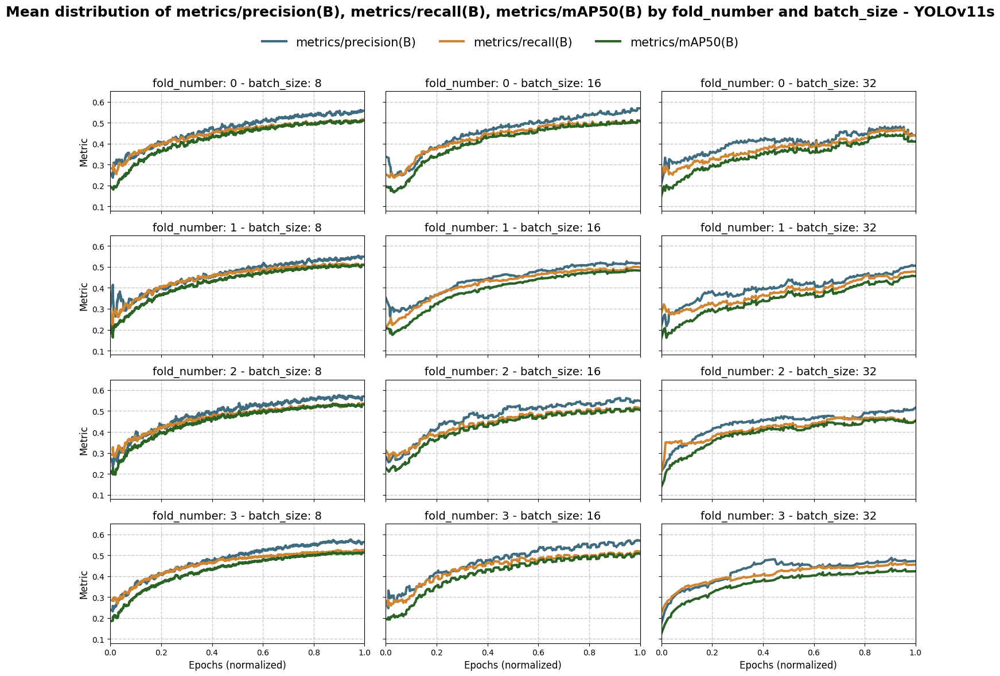

In [26]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11s", 
                             cols=[
                                 'metrics/precision(B)', 
                                 'metrics/recall(B)', 
                                 'metrics/mAP50(B)'
                                 ],
                             row_var='fold_number',
                             col_var='batch_size',
                             smoothing_window=20,
                             y_label='Metric',
                             y_limits=(0.08, 0.65)
)

📌 Plot saved to results/images/YOLOv11n_cols_dynamic_grid.png


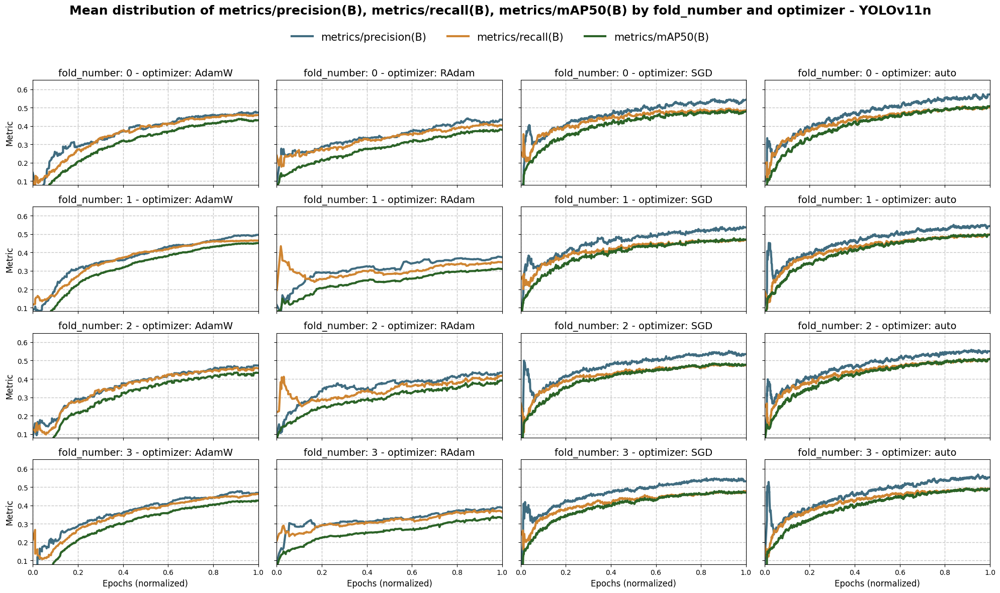

In [27]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11n", 
                             cols=[
                                 'metrics/precision(B)', 
                                 'metrics/recall(B)', 
                                 'metrics/mAP50(B)'
                                 ],
                             row_var='fold_number',
                             col_var='optimizer',
                             smoothing_window=20,
                             y_label='Metric',
                             y_limits=(0.08, 0.65)
)

📌 Plot saved to results/images/YOLOv11s_cols_dynamic_grid.png


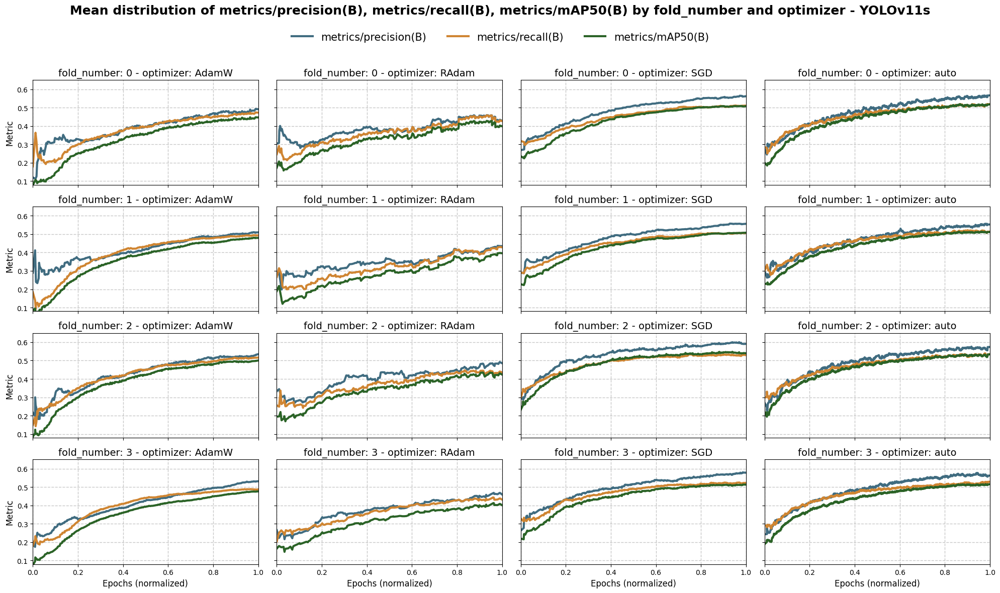

In [28]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11s", 
                             cols=[
                                 'metrics/precision(B)', 
                                 'metrics/recall(B)', 
                                 'metrics/mAP50(B)'
                                 ],
                             row_var='fold_number',
                             col_var='optimizer',
                             smoothing_window=20,
                             y_label='Metric',
                             y_limits=(0.08, 0.65)
)

📌 Plot saved to results/images/YOLOv11n_cols_dynamic_grid.png


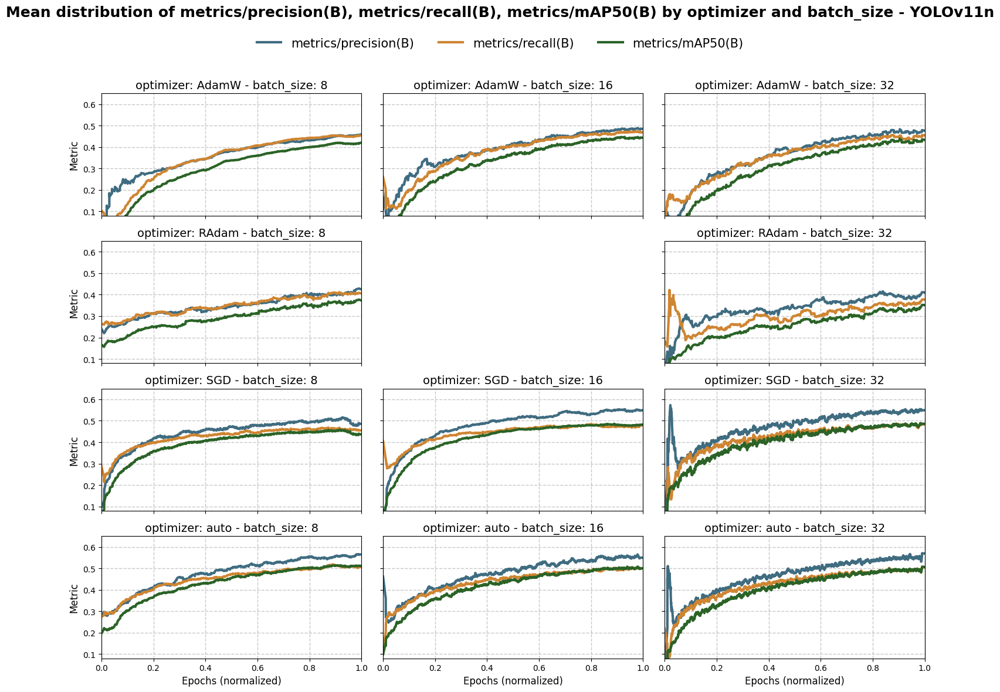

In [29]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11n", 
                             cols=[
                                 'metrics/precision(B)', 
                                 'metrics/recall(B)', 
                                 'metrics/mAP50(B)'
                                 ],
                             row_var='optimizer',
                             col_var='batch_size',
                             smoothing_window=20,
                             y_label='Metric',
                             y_limits=(0.08, 0.65)
)

📌 Plot saved to results/images/YOLOv11s_cols_dynamic_grid.png


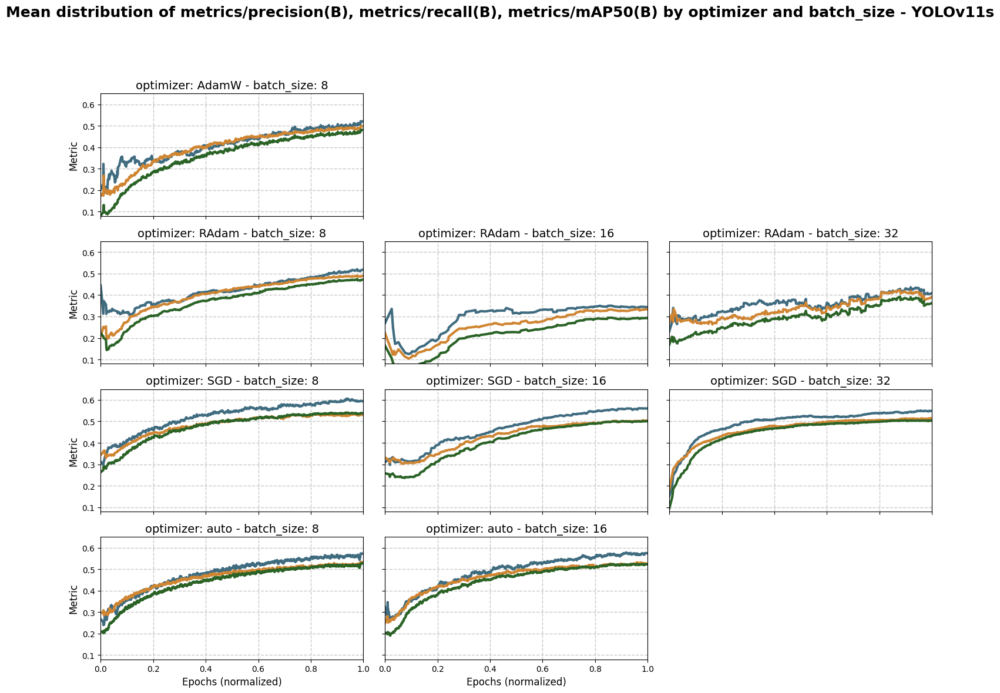

In [30]:
plot_model_cols_dynamic_grid(df, model_name="YOLOv11s", 
                             cols=[
                                 'metrics/precision(B)', 
                                 'metrics/recall(B)', 
                                 'metrics/mAP50(B)'
                                 ],
                             row_var='optimizer',
                             col_var='batch_size',
                             smoothing_window=20,
                             y_label='Metric',
                             y_limits=(0.08, 0.65)
)

## 5. Analysis of Final Performance

### 5.1 Aggregation by Fold

We visualize the average trend of metrics by aggregating all runs while keeping the folds separate.  
Each fold has its own curve with a confidence band.  

📌 Plot saved to results/images/YOLOv11n_aggregates_by_fold.png


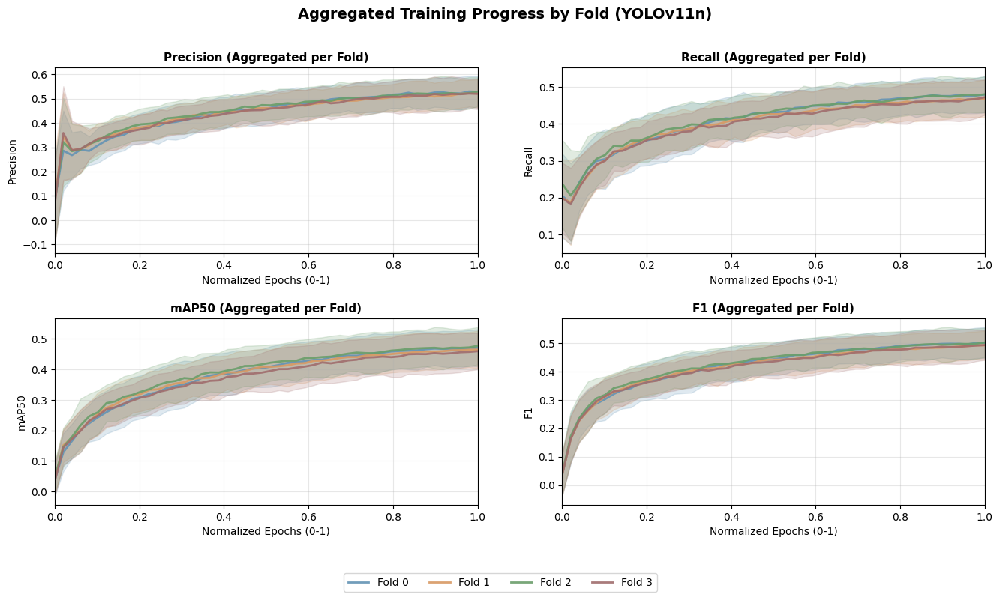

In [31]:
def plot_model_aggregates_by_fold(df, model_name=None, figsize=(16, 8), common_points=50):
    """
    Create a 2x2 plot of metrics by aggregating ALL runs of a model,
    while keeping folds separate (each fold has its own mean ± std curve).

    Args:
        df (pd.DataFrame): input DataFrame containing training logs
        model_name (str, optional): if provided, filter data for this model
        figsize (tuple): size of the entire figure
        common_points (int): number of normalized points to interpolate curves onto
    """
    if model_name:
        df = df[df["model"] == model_name]
        if df.empty:
            print(f"❌ No data found for model {model_name}")
            return

    metrics = {
        "Precision": "metrics/precision(B)",
        "Recall": "metrics/recall(B)",
        "mAP50": "metrics/mAP50(B)",
        "F1": "metrics/f1(B)"
    }

    fig, axes = plt.subplots(2, 2, figsize=figsize)
    axes = axes.flatten()
    fold_colors = ["#6393b4", "#d89963", "#6a9e6a", "#A06D6D", "#b47ba1", "#c2b06d"]  # more folds → more colors
    common_epochs = np.linspace(0, 1, common_points)

    handles, labels = [], []

    for idx, (metric_name, metric_col) in enumerate(metrics.items()):
        if metric_col not in df.columns:
            continue
        ax = axes[idx]

        for fold, fold_data_all in df.groupby("fold_number"):
            fold_curves = []

            for run_code, fold_data in fold_data_all.groupby("run_code"):
                fold_data = fold_data.sort_values("epoch")
                values = fold_data[metric_col].astype(float).dropna().values
                if values.size == 0:
                    continue

                epochs = fold_data["epoch"].values
                norm_epochs = (epochs - epochs.min()) / (epochs.ptp() if epochs.ptp() else 1)

                interp_values = np.interp(common_epochs, norm_epochs, values)
                fold_curves.append(interp_values)

            if fold_curves:
                fold_curves = np.vstack(fold_curves)
                mean, std = np.nanmean(fold_curves, 0), np.nanstd(fold_curves, 0)

                line, = ax.plot(common_epochs, mean,
                                color=fold_colors[fold % len(fold_colors)],
                                lw=2, alpha=0.9)
                ax.fill_between(common_epochs, mean-std, mean+std,
                                color=fold_colors[fold % len(fold_colors)],
                                alpha=0.2)

                if idx == 0:
                    handles.append(line)
                    labels.append(f"Fold {fold}")

        ax.set_title(f"{metric_name} (Aggregated per Fold)", fontsize=11, fontweight="bold")
        ax.set_xlabel("Normalized Epochs (0-1)")
        ax.set_ylabel(metric_name)
        ax.set_xlim(0, 1)
        ax.grid(alpha=0.3)

    for i in range(len(metrics), 4):
        axes[i].set_visible(False)

    fig.legend(handles, labels, loc="lower center", ncol=len(labels), fontsize=10)
    plt.subplots_adjust(hspace=0.35, bottom=0.15)
    plt.suptitle(f"Aggregated Training Progress by Fold ({model_name})",
                 fontsize=14, fontweight="bold")

    # --- Save figure ---
    filename = f"results/images/{model_name}_aggregates_by_fold.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()


# --- Example usage ---
plot_model_aggregates_by_fold(df, "YOLOv11n")

📌 Plot saved to results/images/YOLOv11s_aggregates_by_fold.png


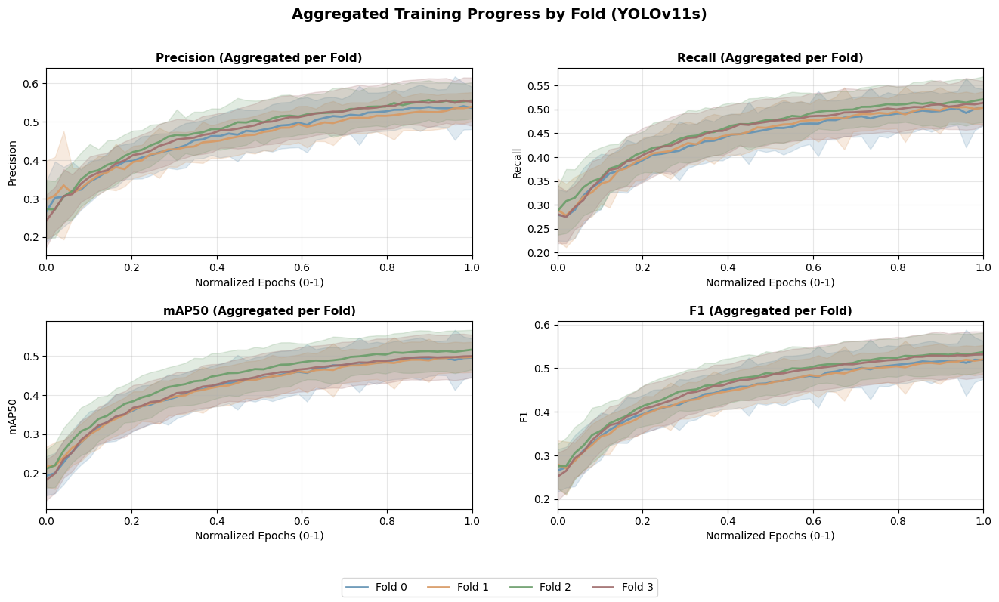

In [32]:
plot_model_aggregates_by_fold(df, "YOLOv11s")

### 5.2 Best Runs per Metric

We identify and visualize the runs with the best performance for each metric, showing their evolution during training.  

🏆 Best Precision: YOLOv11n (run sa6u00f0) score=0.5871
Run: sa6u00f0 | Total training time: 5829.52 min
Configuration:
  model: YOLOv11n
  run_name: firm-sweep-53
  run_code: sa6u00f0
  batch_size: 32
  dropout: 0.18965491538171533
  lr0: 0.006096902598742384
  lrf: 0.01393078223909792
  momentum: 0.8415351664060702
  optimizer: SGD
  weight_decay: 0.00221980374187851
  train/box_loss: 2.61222
  train/cls_loss: 4.526
  train/dfl_loss: 1.99237
  val/box_loss: 2.32155
  val/cls_loss: 3.94019
  val/dfl_loss: 1.80531
  lr/pg0: 0.0693511
  lr/pg1: 0.00198996
  lr/pg2: 0.00198996
  training_time: 34.1375
Epochs per fold:
  fold0: 60
  fold1: 86
  fold2: 73
  fold3: 77
Aggregated metrics (mean of last epoch per fold):
  metrics/precision(B): 0.5871
  metrics/recall(B): 0.4953
  metrics/mAP50(B): 0.5062
  metrics/mAP50-95(B): 0.2184
  metrics/f1(B): 0.5369
--------------------------------------------------
🏆 Best Recall: YOLOv11n (run m1mlqwvc) score=0.5159
Run: m1mlqwvc | Total training time:

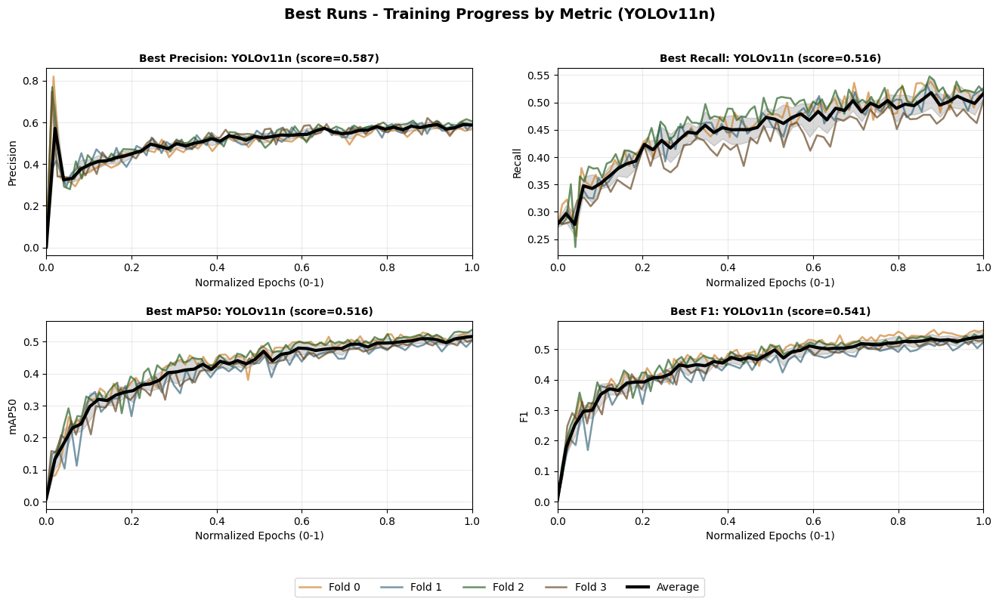

In [37]:
def find_best_run(df, metric, model_name=None, mode="last"):
    """
    Find the run with the best final average performance for a given metric.
    """
    if metric not in df.columns:
        raise ValueError(f"The metric '{metric}' does not exist in the DataFrame.")

    if model_name is not None:
        df = df[df["model"] == model_name]
        if df.empty:
            return None

    def get_value(fold):
        vals = fold[metric].dropna()
        if vals.empty:
            return np.nan
        if mode == "last":
            return vals.iloc[-1]
        elif mode == "max":
            return vals.max()
        elif mode == "min":
            return vals.min()

    group_cols = ["run_code", "model", "fold_number"]
    value_cols = [c for c in df.columns if c not in group_cols]

    scores = (
        df.groupby(group_cols, group_keys=False)[value_cols]
        .apply(get_value)
        .groupby(["run_code", "model"])
        .mean()
    )

    if scores.empty:
        return None

    best_idx = scores.idxmax()
    best_run_data = df[df["run_code"] == best_idx[0]].iloc[0].to_dict()

    return {
        "run_code": best_idx[0],
        "model": best_idx[1],
        "score": scores.max(),
        "full_config": best_run_data
    }


def print_run_summary(run_df):
    """Print aggregated config, epochs per fold, total training time, metrics."""
    exclude_cols = ["fold", "fold_number", "normalized_epoch", "epoch", "time"]
    config_cols = [c for c in run_df.columns if c not in exclude_cols and not c.startswith("metrics/")]
    run_config = run_df.iloc[0][config_cols].to_dict()

    epochs_per_fold = {
        f"fold{fold}": fold_data["epoch"].max()
        for fold, fold_data in run_df.groupby("fold_number")
    }

    total_time_min = run_df["time"].sum() / 60.0

    metric_cols = [c for c in run_df.columns if c.startswith("metrics/")]
    metrics = {
        col: run_df.groupby("fold_number")[col].last().mean()
        for col in metric_cols
    }

    print(f"Run: {run_df['run_code'].iloc[0]} | Total training time: {total_time_min:.2f} min")
    print("Configuration:")
    for k, v in run_config.items():
        print(f"  {k}: {v}")
    print("Epochs per fold:")
    for k, v in epochs_per_fold.items():
        print(f"  {k}: {v}")
    print("Aggregated metrics (mean of last epoch per fold):")
    for k, v in metrics.items():
        print(f"  {k}: {v:.4f}")
    print("-" * 50)


def plot_best_runs(df, model_name=None, figsize=(16, 8), common_points=50, mode='last'):
    """
    Plot 2x2 metrics for the best run of a model, showing folds and mean ± std curves.
    Prints a clean run-level summary for each best run, including epochs per fold and total training time.
    """
    if model_name:
        df = df[df["model"] == model_name]
        if df.empty:
            print(f"❌ No data found for model {model_name}")
            return

    metrics = {
        "Precision": "metrics/precision(B)",
        "Recall": "metrics/recall(B)",
        "mAP50": "metrics/mAP50(B)",
        "F1": "metrics/f1(B)"
    }

    best_runs = {name: (col, find_best_run(df, col, model_name, mode))
                 for name, col in metrics.items() if col in df.columns}
    best_runs = {k: v for k, v in best_runs.items() if v[1]}
    if not best_runs:
        print("❌ No runs found.")
        return

    for name, (_, br) in best_runs.items():
        print(f"🏆 Best {name}: {br['model']} (run {br['run_code'][:8]}) score={br['score']:.4f}")
        run_df = df[df["run_code"] == br['run_code']]
        print_run_summary(run_df)

    fig, axes = plt.subplots(2, 2, figsize=figsize)
    axes = axes.flatten()
    colors = [COLORS['orange'], COLORS['blue'], COLORS['green'], COLORS['brown']]
    common_epochs = np.linspace(0, 1, common_points)

    handles, labels = [], []

    for idx, (metric_name, (metric_col, best_run)) in enumerate(best_runs.items()):
        if idx >= 4: break

        ax = axes[idx]
        run_data = df[df["run_code"] == best_run["run_code"]]
        fold_curves = []

        for fold, fold_data in run_data.groupby("fold_number"):
            fold_data = fold_data.sort_values("epoch")
            values = fold_data[metric_col].astype(float).dropna().values
            if values.size == 0: continue

            epochs = fold_data["epoch"].values
            norm_epochs = (epochs - epochs.min()) / (np.ptp(epochs) if np.ptp(epochs) else 1)

            line, = ax.plot(norm_epochs, values, color=colors[fold % len(colors)], alpha=0.7, lw=1.8)
            fold_curves.append(np.interp(common_epochs, norm_epochs, values))
            if idx == 0:
                handles.append(line)
                labels.append(f"Fold {fold}")

        if fold_curves:
            fold_stack = np.vstack(fold_curves)
            mean, std = np.nanmean(fold_stack, 0), np.nanstd(fold_stack, 0)
            line_avg, = ax.plot(common_epochs, mean, color="black", lw=3)
            ax.fill_between(common_epochs, mean-std, mean+std, color="black", alpha=0.15)
            if idx == 0:
                handles.append(line_avg)
                labels.append("Average")

        ax.set_title(f"Best {metric_name}: {best_run['model']} (score={best_run['score']:.3f})",
                     fontsize=10, fontweight="bold")
        ax.set_xlabel("Normalized Epochs (0-1)")
        ax.set_ylabel(metric_name)
        ax.set_xlim(0, 1)
        ax.grid(alpha=0.25)

    for i in range(len(best_runs), 4):
        axes[i].set_visible(False)

    fig.legend(handles, labels, loc='lower center', ncol=len(labels), fontsize=10)
    plt.subplots_adjust(hspace=0.35, bottom=0.15)
    plt.suptitle(f"Best Runs - Training Progress by Metric" + (f" ({model_name})" if model_name else ""),
                 fontsize=14, fontweight="bold")

    # --- Save figure ---
    filename = f"results/images/{model_name}_best_runs.png" if model_name else "results/images/best_runs.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()


# --- Example usage ---
plot_best_runs(df, "YOLOv11n")

🏆 Best Precision: YOLOv11s (run o5ddl1i7) score=0.5820
Run: o5ddl1i7 | Total training time: 2328.86 min
Configuration:
  model: YOLOv11s
  run_name: fiery-sweep-17
  run_code: o5ddl1i7
  batch_size: 8
  dropout: 0.19138083468834063
  lr0: 0.007139568513089312
  lrf: 0.09926366177432318
  momentum: 0.3784435936626483
  optimizer: SGD
  weight_decay: 0.004954167427521621
  train/box_loss: 2.47416
  train/cls_loss: 3.71517
  train/dfl_loss: 1.94495
  val/box_loss: 2.17769
  val/cls_loss: 2.32865
  val/dfl_loss: 1.71443
  lr/pg0: 0.0692103
  lr/pg1: 0.00236726
  lr/pg2: 0.00236726
  training_time: 43.3312
Epochs per fold:
  fold0: 37
  fold1: 36
  fold2: 47
  fold3: 40
Aggregated metrics (mean of last epoch per fold):
  metrics/precision(B): 0.5820
  metrics/recall(B): 0.5112
  metrics/mAP50(B): 0.5205
  metrics/mAP50-95(B): 0.2302
  metrics/f1(B): 0.5440
--------------------------------------------------
🏆 Best Recall: YOLOv11s (run s0t8ne2r) score=0.5454
Run: s0t8ne2r | Total training ti

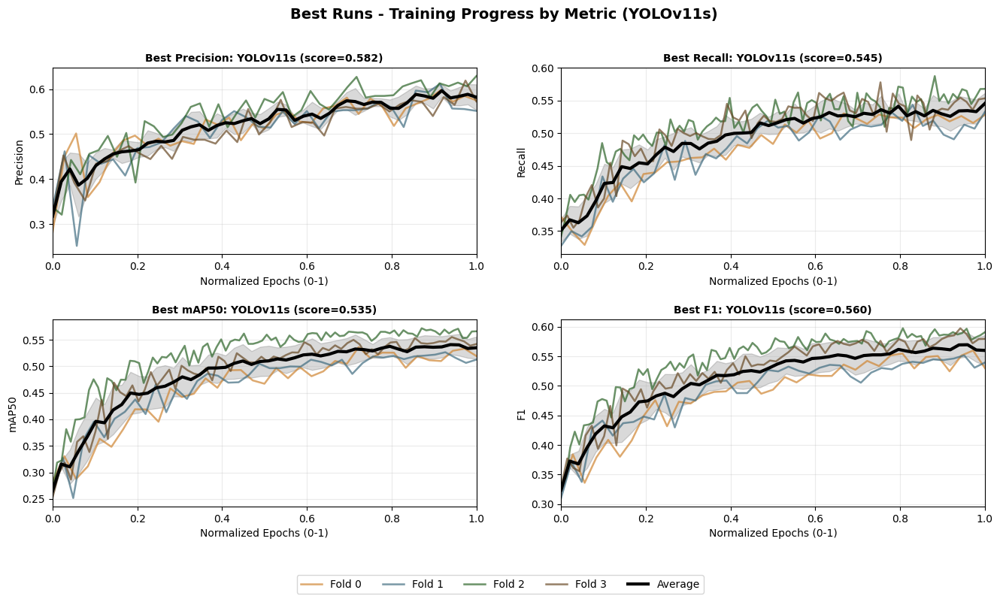

In [38]:
plot_best_runs(df, "YOLOv11s")

### 5.3 Loss Curves for the Best Runs

We analyze in detail the loss curves (training and validation) for the runs with the best precision performance.  

🏆 Best run for metric metrics/precision(B): YOLOv11n (run sa6u00f0) score=0.5871
Full configuration & metrics:
Run: sa6u00f0 | Total training time: 5829.52 min
Configuration:
  model: YOLOv11n
  run_name: firm-sweep-53
  run_code: sa6u00f0
  batch_size: 32
  dropout: 0.18965491538171533
  lr0: 0.006096902598742384
  lrf: 0.01393078223909792
  momentum: 0.8415351664060702
  optimizer: SGD
  weight_decay: 0.00221980374187851
  train/box_loss: 2.61222
  train/cls_loss: 4.526
  train/dfl_loss: 1.99237
  val/box_loss: 2.32155
  val/cls_loss: 3.94019
  val/dfl_loss: 1.80531
  lr/pg0: 0.0693511
  lr/pg1: 0.00198996
  lr/pg2: 0.00198996
  training_time: 34.1375
Epochs per fold:
  fold0: 60
  fold1: 86
  fold2: 73
  fold3: 77
Aggregated metrics (mean of last epoch per fold):
  metrics/precision(B): 0.5871
  metrics/recall(B): 0.4953
  metrics/mAP50(B): 0.5062
  metrics/mAP50-95(B): 0.2184
  metrics/f1(B): 0.5369
--------------------------------------------------
--------------------------------

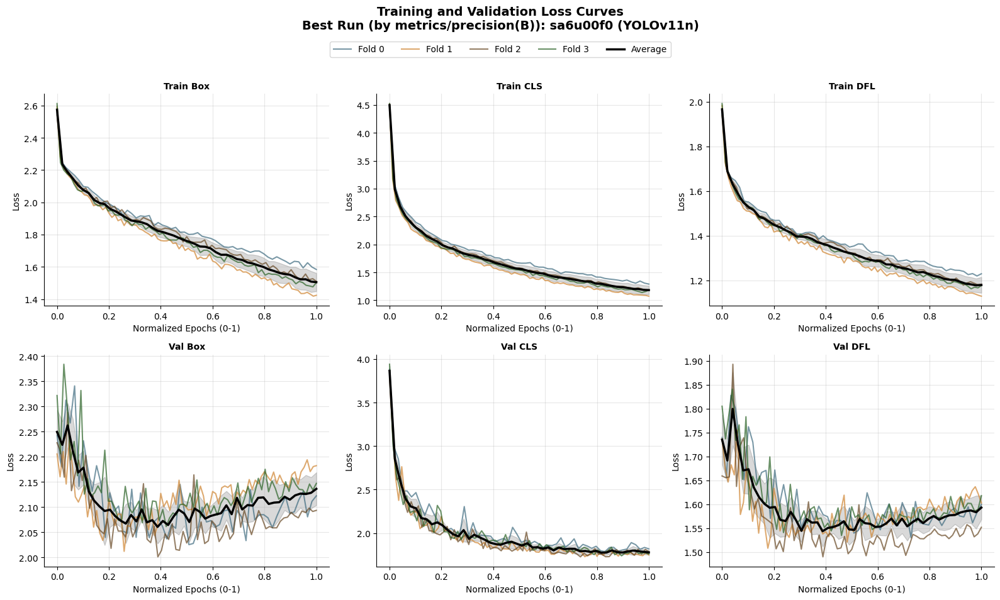

🏆 Best run for metric metrics/precision(B): YOLOv11s (run o5ddl1i7) score=0.5820
Full configuration & metrics:
Run: o5ddl1i7 | Total training time: 2328.86 min
Configuration:
  model: YOLOv11s
  run_name: fiery-sweep-17
  run_code: o5ddl1i7
  batch_size: 8
  dropout: 0.19138083468834063
  lr0: 0.007139568513089312
  lrf: 0.09926366177432318
  momentum: 0.3784435936626483
  optimizer: SGD
  weight_decay: 0.004954167427521621
  train/box_loss: 2.47416
  train/cls_loss: 3.71517
  train/dfl_loss: 1.94495
  val/box_loss: 2.17769
  val/cls_loss: 2.32865
  val/dfl_loss: 1.71443
  lr/pg0: 0.0692103
  lr/pg1: 0.00236726
  lr/pg2: 0.00236726
  training_time: 43.3312
Epochs per fold:
  fold0: 37
  fold1: 36
  fold2: 47
  fold3: 40
Aggregated metrics (mean of last epoch per fold):
  metrics/precision(B): 0.5820
  metrics/recall(B): 0.5112
  metrics/mAP50(B): 0.5205
  metrics/mAP50-95(B): 0.2302
  metrics/f1(B): 0.5440
--------------------------------------------------
-----------------------------

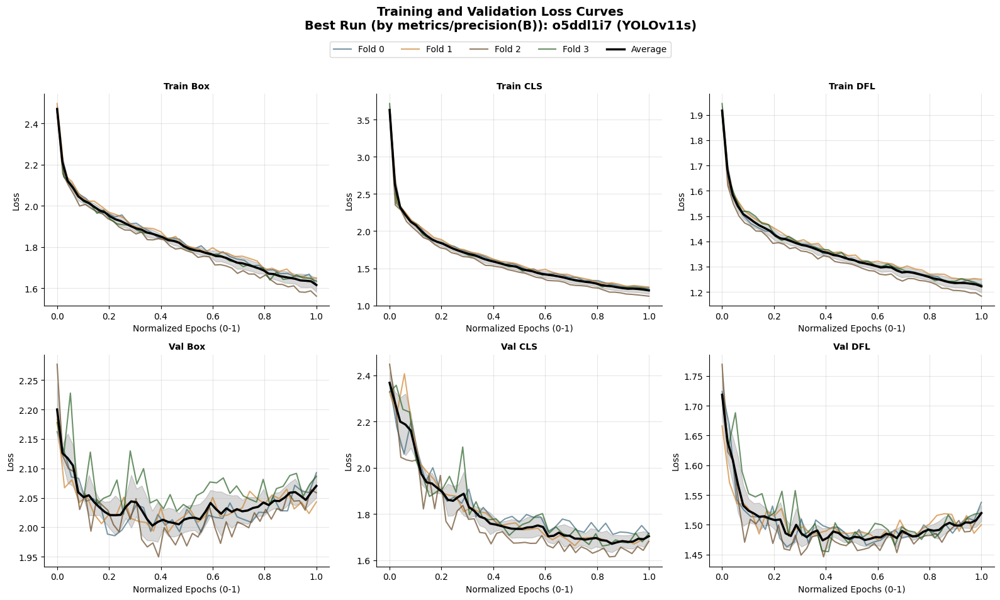

In [41]:
def plot_loss_curves(df, metric='metrics/precision(B)', model_name=None, figsize=(16,10), common_points=50, mode='last'):
    """
    Plot loss curves for the **best run** according to a specific metric.
    Shows 6 subplots (3 train + 3 validation) with individual folds and average curve.
    Also prints full configuration & metrics of the best run.
    """
    # Find the best run
    best_run = find_best_run(df, metric, model_name=model_name, mode=mode)
    if not best_run:
        print("❌ No run found.")
        return

    # --- Print full configuration & metrics ---
    print(f"🏆 Best run for metric {metric}: {best_run['model']} (run {best_run['run_code'][:8]}) score={best_run['score']:.4f}")
    print("Full configuration & metrics:")
    print_run_summary(df[df['run_code'] == best_run['run_code']])
    print("-" * 60)

    df_run = df[df['run_code'] == best_run['run_code']]

    loss_cols = ['train/box_loss', 'train/cls_loss', 'train/dfl_loss',
                 'val/box_loss', 'val/cls_loss', 'val/dfl_loss']
    loss_names = ['Train Box', 'Train CLS', 'Train DFL', 'Val Box', 'Val CLS', 'Val DFL']
    colors = [COLORS['blue'], COLORS['orange'], COLORS['brown'], COLORS['green']]

    fig, axes = plt.subplots(2, 3, figsize=figsize)
    axes = axes.flatten()

    for idx, (col, name) in enumerate(zip(loss_cols, loss_names)):
        ax = axes[idx]
        all_fold_interp = []

        for fold_idx, fold in enumerate(sorted(df_run['fold_number'].unique())):
            fold_data = df_run[df_run['fold_number'] == fold].sort_values('epoch')
            if fold_data.empty or col not in fold_data.columns:
                continue

            values = fold_data[col].astype(float).values
            if np.all(np.isnan(values)):
                continue

            epochs = fold_data['epoch'].values
            norm_epochs = (epochs - epochs.min()) / (epochs.max() - epochs.min()) if len(epochs) > 1 else np.zeros_like(epochs)

            # Individual fold curve
            ax.plot(
                norm_epochs, values,
                color=colors[fold_idx % len(colors)],
                alpha=0.7, linewidth=1.5,
                label=f"Fold {fold_idx}" if idx == 0 else None  # label SOLO per il primo subplot
            )

            # Interpolation for mean
            if len(norm_epochs) > 1 and np.sum(~np.isnan(values)) >= 2:
                interp_vals = np.interp(np.linspace(0,1,common_points), norm_epochs, values)
                all_fold_interp.append(interp_vals)

        # Plot average ± std
        if all_fold_interp:
            all_fold_interp = np.vstack(all_fold_interp)
            mean_curve = np.nanmean(all_fold_interp, axis=0)
            std_curve = np.nanstd(all_fold_interp, axis=0)
            x_common = np.linspace(0,1,common_points)
            ax.plot(x_common, mean_curve, color='black', linewidth=2.5, label='Average')
            ax.fill_between(x_common, mean_curve-std_curve, mean_curve+std_curve, color='black', alpha=0.15)

        ax.set_title(name, fontsize=10, fontweight='bold')
        ax.set_xlabel('Normalized Epochs (0-1)')
        ax.set_ylabel('Loss')
        ax.grid(True, alpha=0.3)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)

    # Hide unused subplots
    for i in range(len(loss_cols), len(axes)):
        axes[i].set_visible(False)

    # Global legend
    handles, labels = axes[0].get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper center', ncol=len(labels), bbox_to_anchor=(0.5, 0.95))

    title = f"Training and Validation Loss Curves\nBest Run (by {metric}): {best_run['run_code']}"
    if model_name:
        title += f" ({model_name})"
    plt.suptitle(title, fontsize=14, fontweight='bold', y=1.0)
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])

    # --- Save figure ---
    filename = f"results/images/{model_name}_loss_curves.png" if model_name else "results/images/loss_curves.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()


# --- Example usage ---
plot_loss_curves(df, metric='metrics/precision(B)', model_name="YOLOv11n")
plot_loss_curves(df, metric='metrics/precision(B)', model_name="YOLOv11s")

🏆 Best run for metric metrics/recall(B): YOLOv11n (run m1mlqwvc) score=0.5159
Full configuration & metrics:
Run: m1mlqwvc | Total training time: 9416.47 min
Configuration:
  model: YOLOv11n
  run_name: dainty-sweep-37
  run_code: m1mlqwvc
  batch_size: 8
  dropout: 0.04267915038160699
  lr0: 0.00226438260555459
  lrf: 0.02098797235846839
  momentum: 0.592205003581577
  optimizer: auto
  weight_decay: 0.003494998274662436
  train/box_loss: 2.47526
  train/cls_loss: 3.85338
  train/dfl_loss: 1.8131
  val/box_loss: 2.41258
  val/cls_loss: 2.96454
  val/dfl_loss: 1.7119
  lr/pg0: 0.000473813
  lr/pg1: 0.000473813
  lr/pg2: 0.000473813
  training_time: 43.9011
Epochs per fold:
  fold0: 90
  fold1: 84
  fold2: 96
  fold3: 65
Aggregated metrics (mean of last epoch per fold):
  metrics/precision(B): 0.5499
  metrics/recall(B): 0.5159
  metrics/mAP50(B): 0.5071
  metrics/mAP50-95(B): 0.2251
  metrics/f1(B): 0.5320
--------------------------------------------------
------------------------------

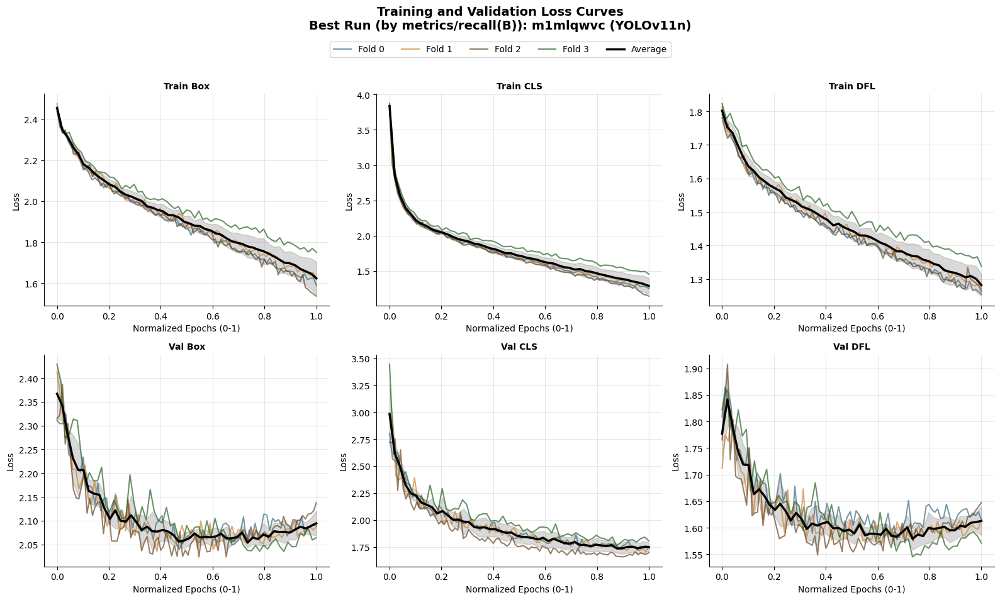

🏆 Best run for metric metrics/recall(B): YOLOv11s (run s0t8ne2r) score=0.5454
Full configuration & metrics:
Run: s0t8ne2r | Total training time: 5683.08 min
Configuration:
  model: YOLOv11s
  run_name: clear-sweep-1
  run_code: s0t8ne2r
  batch_size: 8
  dropout: 0.1947711018009392
  lr0: 0.0057080521453789215
  lrf: 0.08671072594513467
  momentum: 0.8832256222304963
  optimizer: SGD
  weight_decay: 0.0021360564522182046
  train/box_loss: 2.45849
  train/cls_loss: 3.61555
  train/dfl_loss: 1.90984
  val/box_loss: 2.13716
  val/cls_loss: 2.25924
  val/dfl_loss: 1.69273
  lr/pg0: 0.0687357
  lr/pg1: 0.00189262
  lr/pg2: 0.00189262
  training_time: 42.5501
Epochs per fold:
  fold0: 37
  fold1: 42
  fold2: 94
  fold3: 70
Aggregated metrics (mean of last epoch per fold):
  metrics/precision(B): 0.5755
  metrics/recall(B): 0.5454
  metrics/mAP50(B): 0.5349
  metrics/mAP50-95(B): 0.2367
  metrics/f1(B): 0.5599
--------------------------------------------------
--------------------------------

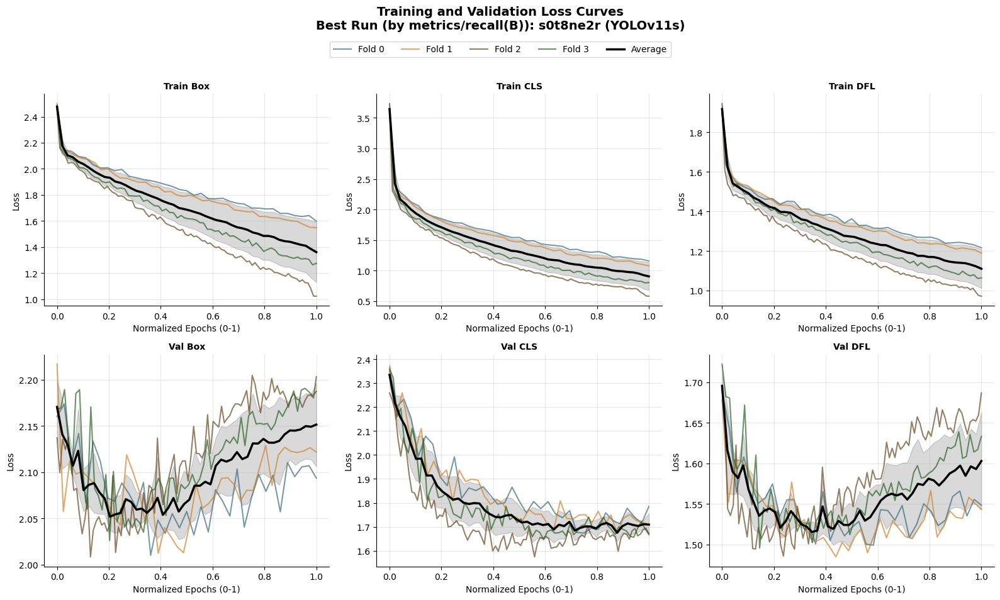

In [42]:
plot_loss_curves(df, metric='metrics/recall(B)', model_name="YOLOv11n")
plot_loss_curves(df, metric='metrics/recall(B)', model_name="YOLOv11s")

## 6. Parametric Comparison of Performance

### 6.1 Distribution of Final Metrics

Boxplots of final performance grouped by different hyperparameters.  
Performance is calculated as the average of the last value of each fold for each run.  

📌 Plot saved to results/images/boxplots_by_optimizer.png


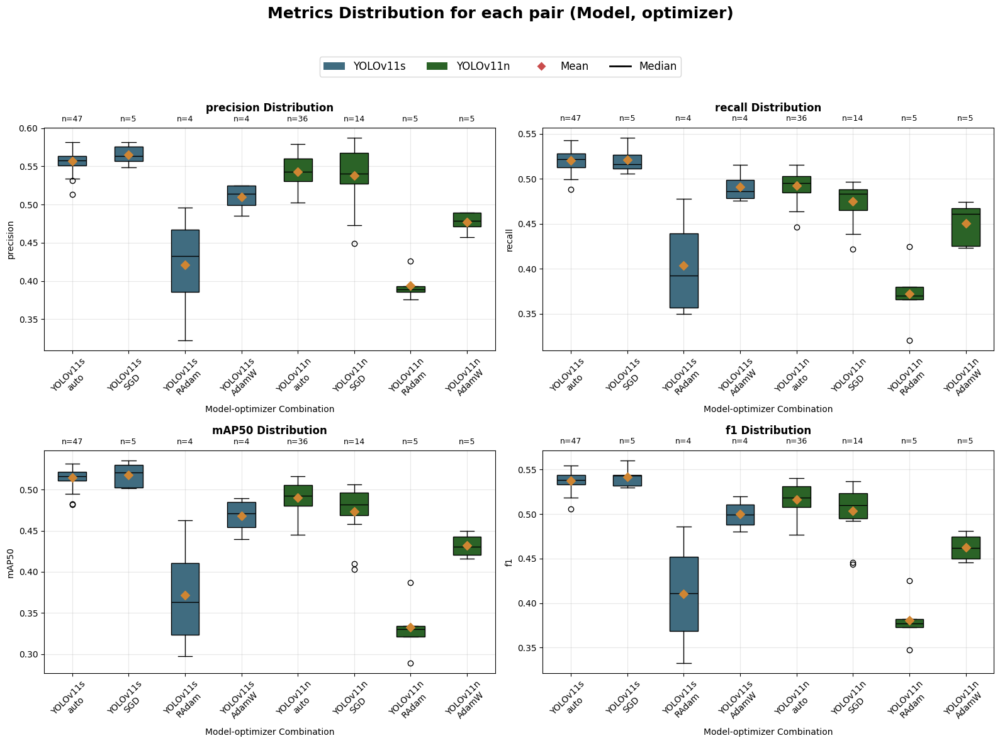

In [20]:
def prepare_final_metrics(df, split_col, metrics=None):
    """
    Extract the last value of each metric per fold and run, 
    then compute the mean per run (for boxplots or configuration comparison).

    Args:
        df (pd.DataFrame): DataFrame containing run data.
        split_col (str): Categorical column to split by (batch_size, optimizer, fold_number, etc.)
        metrics (list[str], optional): List of metric columns to consider. 
                                       Default: ['metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/f1(B)']

    Returns:
        pd.DataFrame: Aggregated DataFrame with mean metrics per run.
    """
    if metrics is None:
        metrics = ['metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)', 'metrics/f1(B)']

    # Extract last value per fold
    fold_df = (
        df.groupby(['run_code', 'model', split_col, 'fold_number'], as_index=False)[metrics]
          .last()
    )

    # Compute mean per run (aggregating folds)
    run_means = fold_df.groupby(['run_code', 'model', split_col], as_index=False).mean(numeric_only=True)
    return run_means


def plot_boxplots(final_metrics, split_col, metrics=None):
    """
    Create boxplots for each model-<split_col> combination showing number of runs,
    with a global legend (model, mean, median).
    Only uses colors defined in COLORS (blue, orange).
    """
    if metrics is None:
        metrics = ["metrics/precision(B)", "metrics/recall(B)", "metrics/mAP50(B)", "metrics/f1(B)"]

    models = final_metrics["model"].unique()
    split_values = final_metrics[split_col].unique()

    # Alternate colors only between blue and green
    palette = [COLORS["blue"], COLORS["green"]]
    model_colors = {model: palette[i % 2] for i, model in enumerate(models)}

    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    axes = axes.flatten()

    for i, metric in enumerate(metrics):
        ax = axes[i]
        plot_data, labels, n_runs = [], [], []

        for model in models:
            for val in split_values:
                data = final_metrics[(final_metrics["model"] == model) &
                                     (final_metrics[split_col] == val)][metric]
                if not data.empty:
                    plot_data.append(data.values)
                    labels.append(f"{model}\n{val}")
                    n_runs.append(len(data))

        # Boxplot
        bp = ax.boxplot(plot_data, tick_labels=labels, patch_artist=True,
                        medianprops=dict(color='black', linewidth=1))

        # Set box colors by model
        for patch, lbl in zip(bp["boxes"], labels):
            model_name = lbl.split("\n")[0]
            patch.set_facecolor(model_colors.get(model_name, "lightgray"))

        # Plot means (red diamond)
        means = [np.mean(d) for d in plot_data]
        ax.scatter(range(1, len(means)+1), means, color=COLORS['orange'],
                   marker="D", s=50, zorder=3)

        # Display number of runs above each box
        ylim_top = ax.get_ylim()[1]
        for x, n in enumerate(n_runs, start=1):
            ax.text(x, ylim_top * 1.01, f"n={n}", ha="center", va="bottom", fontsize=9)

        # Titles and axis labels
        ax.set_title(metric.split("/")[-1].replace("(B)", "") + " Distribution",
                     fontsize=12, fontweight="bold", y=1.05)
        ax.set_xlabel(f"Model-{split_col} Combination")
        ax.set_ylabel(metric.split("/")[-1].replace("(B)", ""))
        ax.tick_params(axis="x", rotation=45)
        ax.grid(True, alpha=0.3)

    # Hide unused subplots
    for j in range(len(metrics), len(axes)):
        axes[j].set_visible(False)

    # Global legend
    legend_elements = [mpatches.Patch(facecolor=color, label=model)
                       for model, color in model_colors.items()]
    legend_elements += [
        Line2D([0], [0], marker='D', color='w', label='Mean',
               markerfacecolor=COLORS['red'], markersize=8),
        Line2D([0], [0], marker='_', color='black', label='Median',
               markersize=12, lw=2)
    ]
    plt.suptitle(f"Metrics Distribution for each pair (Model, {split_col})",
                 fontsize=18, fontweight="bold")

    fig.legend(handles=legend_elements,
               loc='upper center',
               ncol=4,
               fontsize=12,
               bbox_to_anchor=(0.5, 0.92))

    plt.tight_layout(rect=[0, 0, 1, 0.9])

    # --- Save figure ---
    filename = f"results/images/boxplots_by_{split_col}.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()

# --- Example usage ---
split_col_name = 'optimizer'  # could be 'batch_size', 'optimizer', etc.
final_metrics = prepare_final_metrics(df, split_col=split_col_name)
plot_boxplots(final_metrics, split_col=split_col_name)

📌 Plot saved to results/images/boxplots_by_batch_size.png


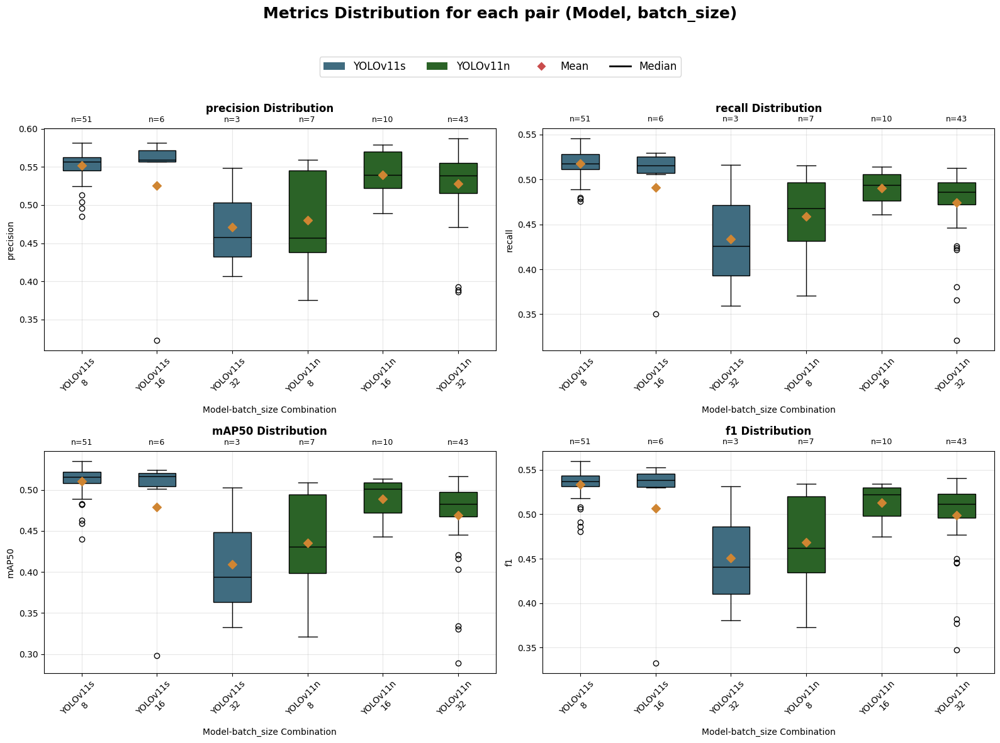

In [21]:
split_col_name = 'batch_size'  # o 'batch_size', 'optimizer', ecc.
final_metrics = prepare_final_metrics(df, split_col=split_col_name)
plot_boxplots(final_metrics, split_col=split_col_name)

📌 Plot saved to results/images/boxplots_by_fold.png


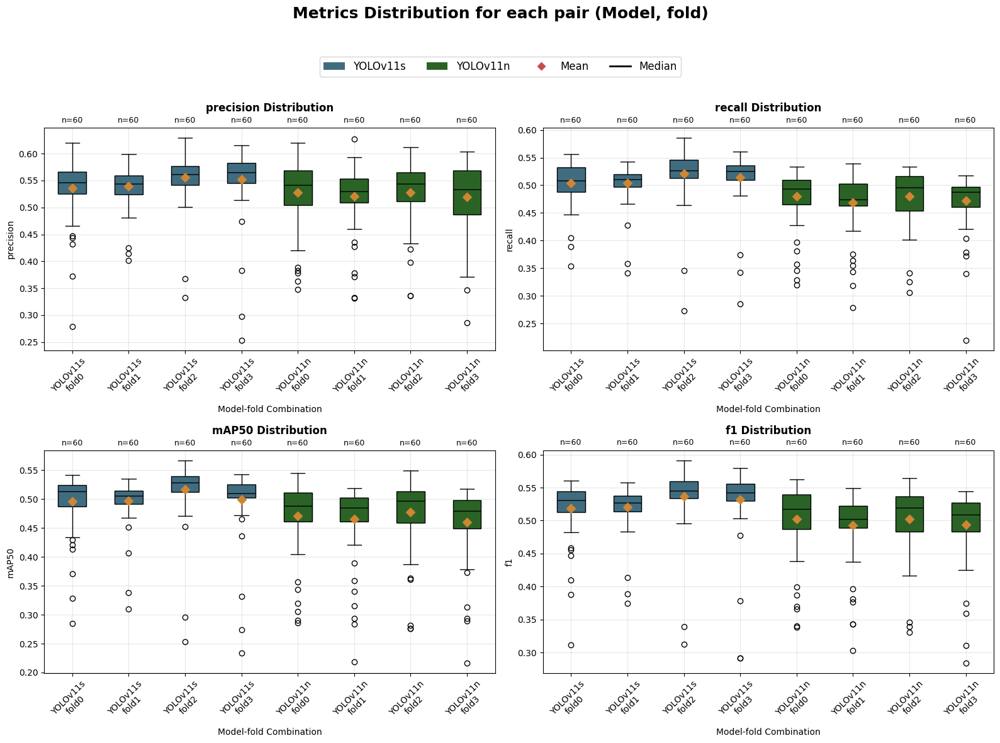

In [22]:
split_col_name = 'fold'
final_metrics = prepare_final_metrics(df, split_col=split_col_name)
plot_boxplots(final_metrics, split_col=split_col_name)

### 6.2 Comparison of Average Performance

Bar charts comparing the final average performance for different hyperparameter groupings.  
The golden bars indicate the best configuration.

📌 Plot saved to results/images/comparison_by_optimizer_mean_multi_model.png


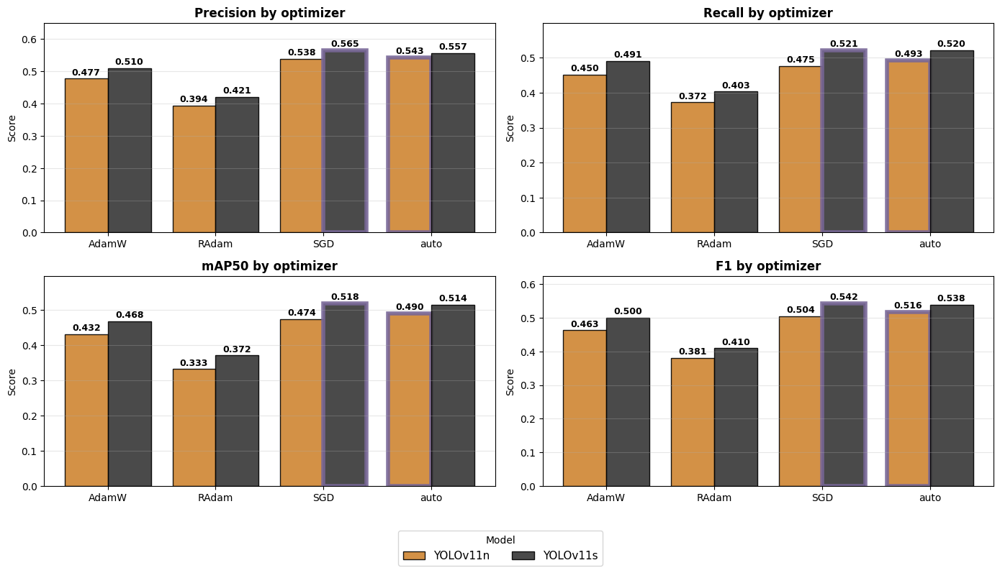

In [40]:
def final_score_parametric(df, metric, group_value, group_col="optimizer", mode="mean", model=None):
    """
    Compute a reference metric for a specific group value using a chosen aggregation mode,
    optionally filtered by a specific model.

    Args:
        df (pd.DataFrame): Data containing runs and folds.
        metric (str): Metric column to aggregate.
        group_value: Value of the categorical column to aggregate.
        group_col (str): Name of the categorical column (e.g., optimizer, batch_size, fold_number).
        mode (str): Aggregation mode: "mean" (average of all runs),
                    "max" (best run among all runs), "min" (worst run among all runs).
        model (str, optional): If specified, only include runs for this model.

    Returns:
        float: Aggregated metric for the group value.
    """
    if model:
        df = df[df["model"] == model].copy()
        if df.empty:
            return None

    df[group_col] = df[group_col].astype(str)
    group_value = str(group_value)

    runs = df[df[group_col] == group_value]['run_code'].unique()
    run_scores = []

    for run in runs:
        sub = df[(df['run_code'] == run) & (df[group_col] == group_value)]
        fold_scores = []
        for fold, fd in sub.groupby("fold_number"):
            if not fd.empty:
                fold_scores.append(fd[metric].iloc[-1])  # last epoch per fold
        if fold_scores:
            run_scores.append(np.mean(fold_scores))  # average over folds for this run

    if not run_scores:
        return None

    if mode == "mean":
        return np.mean(run_scores)   # average across all runs
    elif mode == "max":
        return np.max(run_scores)    # best run
    elif mode == "min":
        return np.min(run_scores)    # worst run
    else:
        raise ValueError(f"Invalid mode '{mode}', choose from ['mean', 'max', 'min'].")


def plot_comparison_multi_model(df, group_col="optimizer", mode="mean", figsize=(14, 8)):
    """
    Barplot comparativo per più modelli: ogni gruppo (es. optimizer) mostra i punteggi dei diversi modelli.
    Evidenzia la barra più alta di ciascun modello per ogni grafico, aumenta il limite y e sposta la legenda in basso al centro.
    
    Args:
        df (pd.DataFrame): Data contenente runs, metrics e modello.
        group_col (str): Colonna categorica da confrontare.
        mode (str): Aggregazione: "mean", "max", "min".
        figsize (tuple): Dimensione della figura.
    """
    df[group_col] = df[group_col].astype(str)
    metrics = {
        'Precision': 'metrics/precision(B)',
        'Recall': 'metrics/recall(B)',
        'mAP50': 'metrics/mAP50(B)',
        'F1': 'metrics/f1(B)'
    }
    
    models = sorted(df['model'].unique())
    group_values = sorted(df[group_col].unique())
    
    # Palette colori per modelli
    base_colors = [COLORS['orange'], COLORS['gray']]
    model_colors = {model: base_colors[i % len(base_colors)] for i, model in enumerate(models)}
    
    n_metrics = len(metrics)
    nrows, ncols = 2, 2
    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)
    axes = axes.flatten()
    
    for i, (metric_name, metric_col) in enumerate(metrics.items()):
        ax = axes[i]
        width = 0.8 / len(models)  # larghezza barre per modello
        x = np.arange(len(group_values))
        
        # Disegna le barre per ogni modello
        for j, model in enumerate(models):
            scores = [final_score_parametric(df, metric_col, val, group_col, mode=mode, model=model) for val in group_values]
            scores = [s if s is not None else 0 for s in scores]
            
            bars = ax.bar(x + j*width, scores, width=width, color=model_colors[model], alpha=0.9, edgecolor='black', label=model)
            
            # Evidenzia la barra più alta di questo modello
            max_idx = np.argmax(scores)
            bars[max_idx].set_edgecolor(COLORS['purple'])
            bars[max_idx].set_linewidth(4)
            
            # Annotazioni sopra ogni barra
            for k, (bar, s) in enumerate(zip(bars, scores)):
                if s > 0:
                    ax.text(bar.get_x() + bar.get_width()/2, s * 1.01, f"{s:.3f}", ha='center', va='bottom', fontsize=9, fontweight='bold')
        
        # Asse X
        ax.set_xticks(x + width*(len(models)-1)/2)
        ax.set_xticklabels(group_values)
        ax.set_title(f"{metric_name} by {group_col}", fontsize=12, fontweight="bold")
        ax.set_ylabel("Score")
        ax.grid(axis='y', alpha=0.3)
        # Limite Y aumentato del 15%
        all_scores = [final_score_parametric(df, metric_col, val, group_col, mode=mode, model=m) or 0
                      for val in group_values for m in models]
        ax.set_ylim(0, max(all_scores) * 1.15)
    
    # Legenda globale in basso al centro
    handles, labels = ax.get_legend_handles_labels()
    fig.legend(handles, labels, title="Model", loc='lower center', ncol=len(models), fontsize=11, bbox_to_anchor=(0.5, -0.05))
    
    plt.tight_layout(rect=[0, 0.05, 1, 0.95])
    
    # Salvataggio automatico
    filename = f"results/images/comparison_by_{group_col}_{mode}_multi_model.png"
    plt.savefig(filename, dpi=300, bbox_inches='tight')
    print(f"📌 Plot saved to {filename}")
    
    plt.show()

# --- Example usage ---
plot_comparison_multi_model(df, group_col='optimizer', mode='mean')

📌 Plot saved to results/images/comparison_by_optimizer_max_multi_model.png


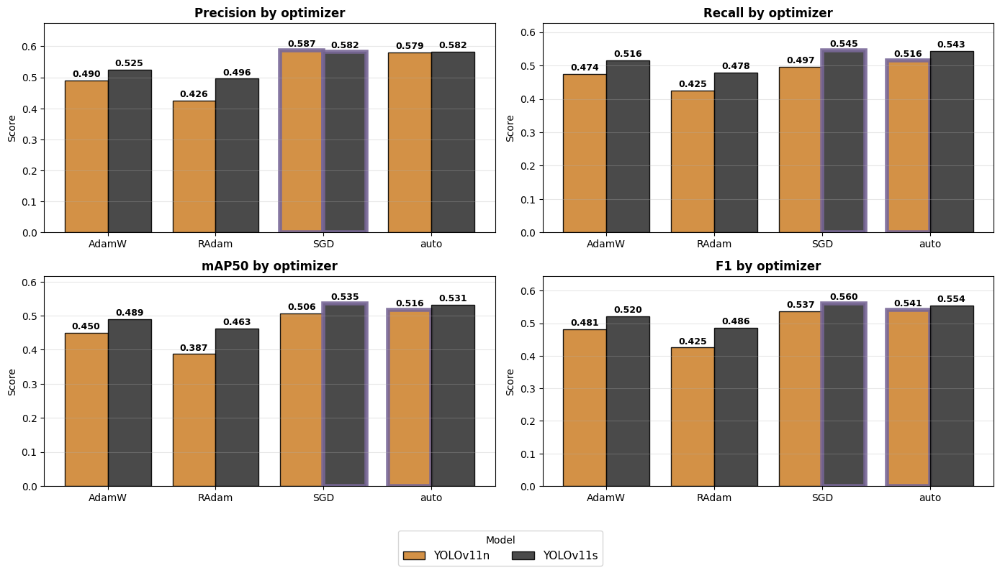

In [42]:
plot_comparison_multi_model(df, group_col='optimizer', mode='max')

📌 Plot saved to results/images/comparison_by_batch_size_mean_multi_model.png


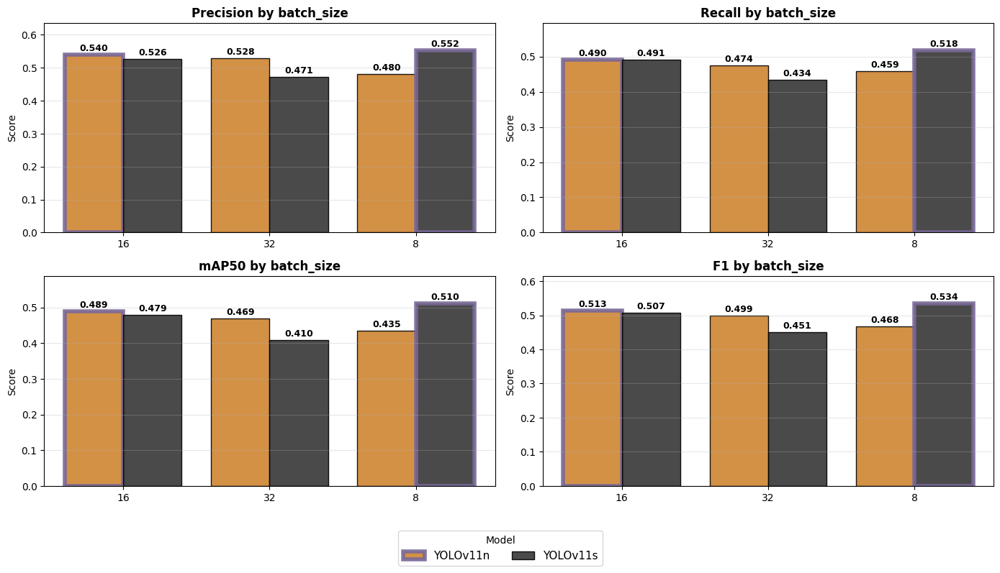

In [43]:
plot_comparison_multi_model(df, group_col='batch_size', mode='mean')

📌 Plot saved to results/images/comparison_by_batch_size_max_multi_model.png


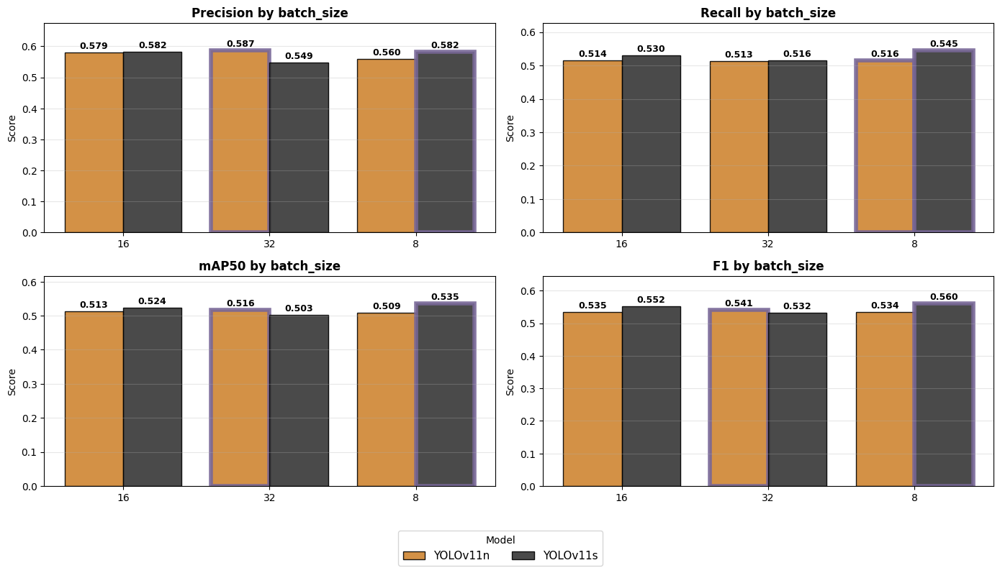

In [44]:
plot_comparison_multi_model(df, group_col='batch_size', mode='max')

📌 Plot saved to results/images/comparison_by_fold_mean_multi_model.png


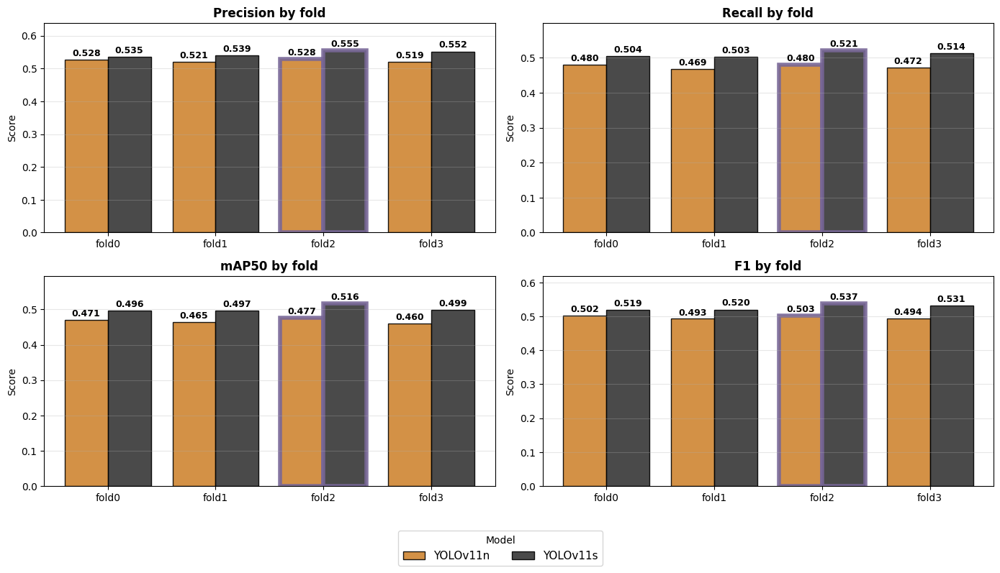

In [45]:
plot_comparison_multi_model(df, group_col='fold', mode='mean')

📌 Plot saved to results/images/comparison_by_fold_max_multi_model.png


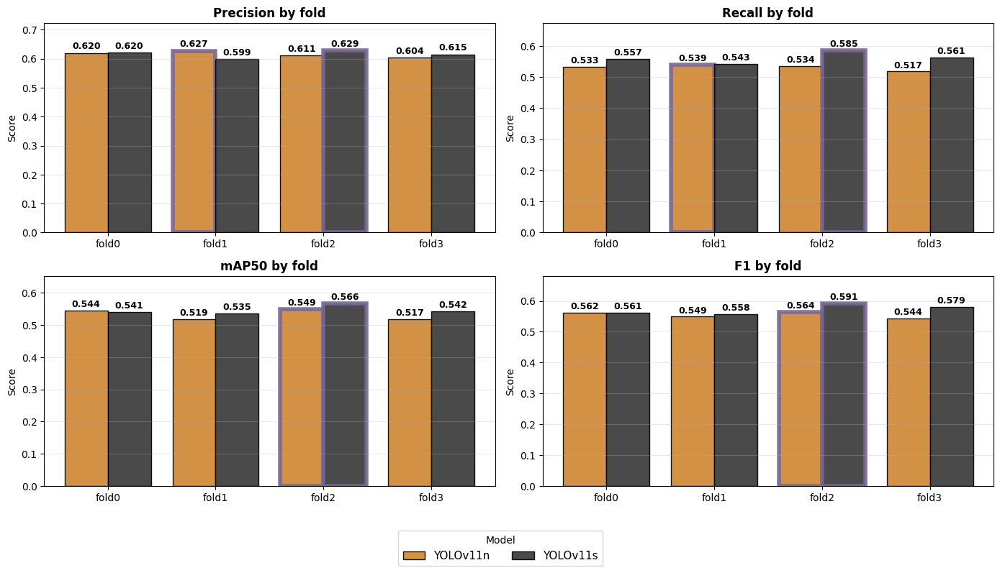

In [46]:
plot_comparison_multi_model(df, group_col='fold', mode='max')

### 6.3 Training Curves by Category

We visualize the average evolution of metrics grouped by hyperparameter categories, with standard deviation bands.  

📌 Plot saved to results/images/categorical_curves_by_optimizer_mean_YOLOv11n.png


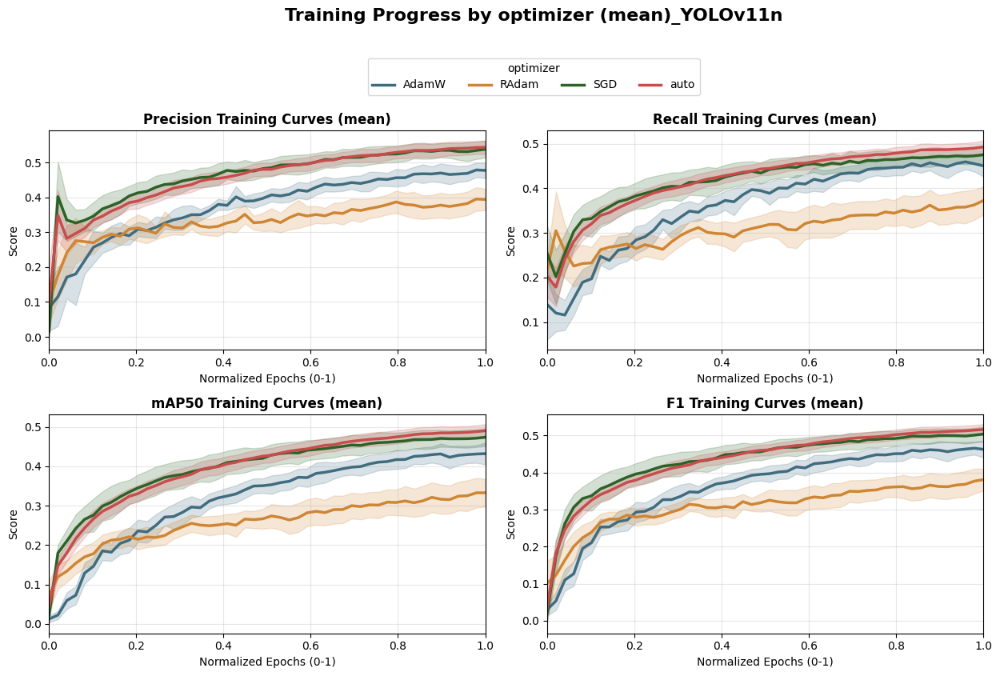

📌 Plot saved to results/images/categorical_curves_by_optimizer_mean_YOLOv11s.png


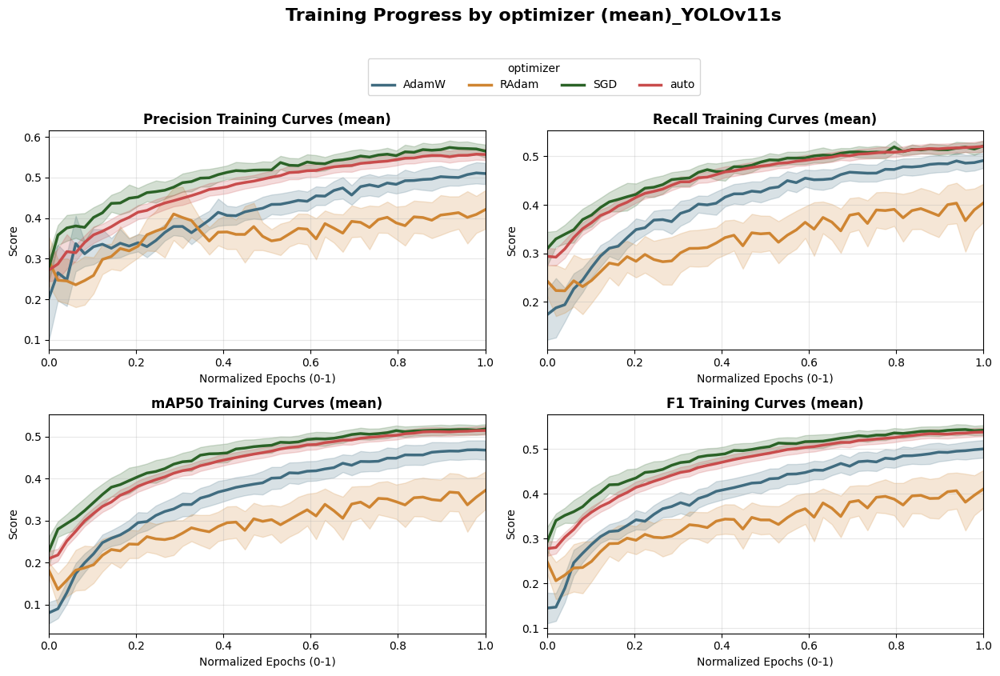

In [47]:
def plot_categorical_curves(df, category_col="optimizer", model=None, figsize=(14, 8), mode="mean"):
    """
    Plot normalized training curves for each value of a categorical column 
    (e.g., optimizer, batch_size, fold), showing mean ± std deviation.
    User can choose whether to aggregate all runs or use best/worst run per category.
    Uses `normalized_epoch` column if present.
    Can filter by a specific model.

    Args:
        df (pd.DataFrame): Data containing 'run_code', 'fold_number', 'normalized_epoch', and metric columns.
        category_col (str): Categorical column to split curves by.
        model (str, optional): Filter to a specific model if provided.
        figsize (tuple): Figure size.
        mode (str): "mean" (average all runs), "max" (best run), "min" (worst run) per category value.
    """
    if model:
        df = df[df["model"] == model].copy()
        if df.empty:
            print(f"❌ No data found for model {model}")
            return

    df[category_col] = df[category_col].astype(str)
    
    metrics = {
        'Precision': 'metrics/precision(B)',
        'Recall': 'metrics/recall(B)',
        'mAP50': 'metrics/mAP50(B)',
        'F1': 'metrics/f1(B)'
    }

    cat_values = sorted(df[category_col].unique())
    base_colors = [COLORS['blue'], COLORS['orange'], COLORS['green'], COLORS['red'], COLORS['gray']]
    colors = [base_colors[i % len(base_colors)] for i in range(len(cat_values))]

    fig, axes = plt.subplots(2, 2, figsize=figsize)
    axes = axes.flatten()

    legend_handles = []

    for i, (name, col) in enumerate(metrics.items()):
        ax = axes[i]
        for val, color in zip(cat_values, colors):
            curves = []

            subset = df[df[category_col] == val]

            # Determine which runs to use based on mode
            runs_to_use = []
            if mode == "mean":
                runs_to_use = subset['run_code'].unique()
            elif mode in ["max", "min"]:
                run_scores = {}
                for run, run_df in subset.groupby('run_code'):
                    fold_scores = []
                    for _, fd in run_df.groupby('fold_number'):
                        if col in fd.columns:
                            fold_scores.append(fd[col].iloc[-1])
                    if fold_scores:
                        run_scores[run] = np.mean(fold_scores)
                if run_scores:
                    if mode == "max":
                        runs_to_use = [max(run_scores, key=run_scores.get)]
                    else:  # min
                        runs_to_use = [min(run_scores, key=run_scores.get)]

            # Collect curves per run and fold
            for run in runs_to_use:
                run_df = subset[subset['run_code'] == run]
                for (r, fold), fd in run_df.groupby(['run_code', 'fold_number']):
                    if len(fd) > 1 and 'normalized_epoch' in fd.columns:
                        fd = fd.sort_values("normalized_epoch")
                        x_vals = fd["normalized_epoch"].values
                        y_vals = fd[col].values
                        curves.append(np.interp(np.linspace(0,1,50), x_vals, y_vals))

            if curves:
                curves = np.vstack(curves)
                mean, std = curves.mean(0), curves.std(0)
                x = np.linspace(0,1,50)
                line, = ax.plot(x, mean, color=color, lw=2.5, label=val)
                ax.fill_between(x, mean-std/2, mean+std/2, color=color, alpha=0.2)

                if i == 0:
                    legend_handles.append(line)

        ax.set_title(f"{name} Training Curves ({mode})", fontsize=12, fontweight="bold")
        ax.set_xlabel("Normalized Epochs (0-1)")
        ax.set_ylabel("Score")
        ax.set_xlim(0,1)
        ax.grid(alpha=0.3)

    fig.legend(
        handles=legend_handles,
        labels=cat_values,
        title=category_col,
        loc='upper center',
        ncol=len(cat_values),
        bbox_to_anchor=(0.48, 0.98)
    )

    model_suffix = f"_{model}" if model else ""
    filename = f"results/images/categorical_curves_by_{category_col}_{mode}{model_suffix}.png"

    plt.suptitle(f"Training Progress by {category_col} ({mode}){model_suffix}", fontsize=16, fontweight="bold", x=0.48, y=1.05)
    plt.tight_layout(rect=[0,0,0.9,0.95])

    # --- Save figure ---
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot saved to {filename}")

    plt.show()

plot_categorical_curves(df, category_col='optimizer', mode='mean', model='YOLOv11n')
plot_categorical_curves(df, category_col='optimizer', mode='mean', model='YOLOv11s')

📌 Plot saved to results/images/categorical_curves_by_optimizer_max_YOLOv11n.png


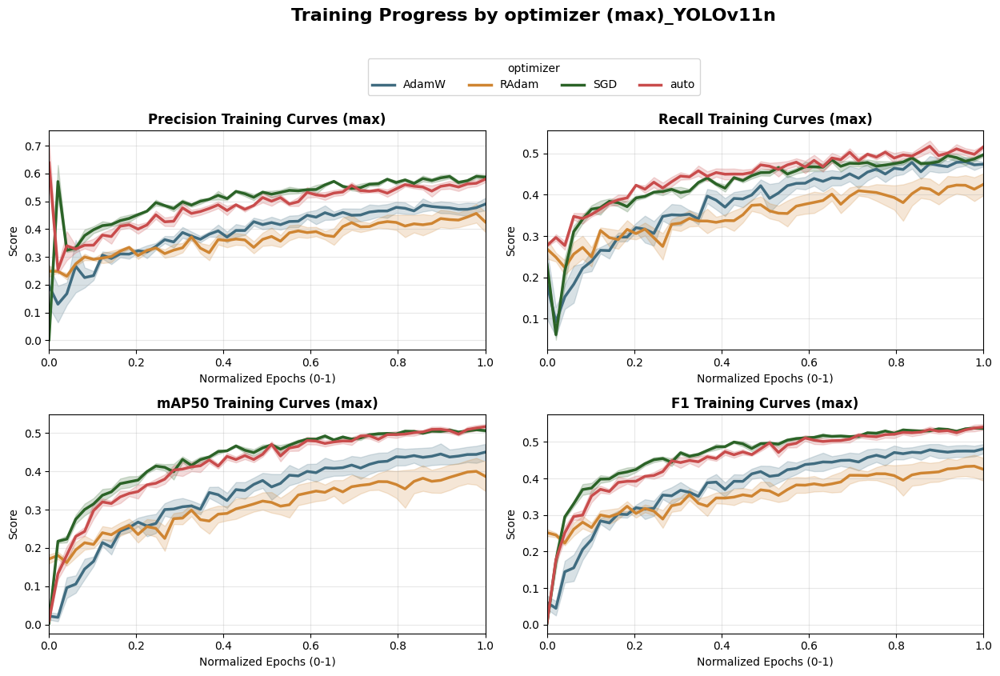

📌 Plot saved to results/images/categorical_curves_by_optimizer_max_YOLOv11s.png


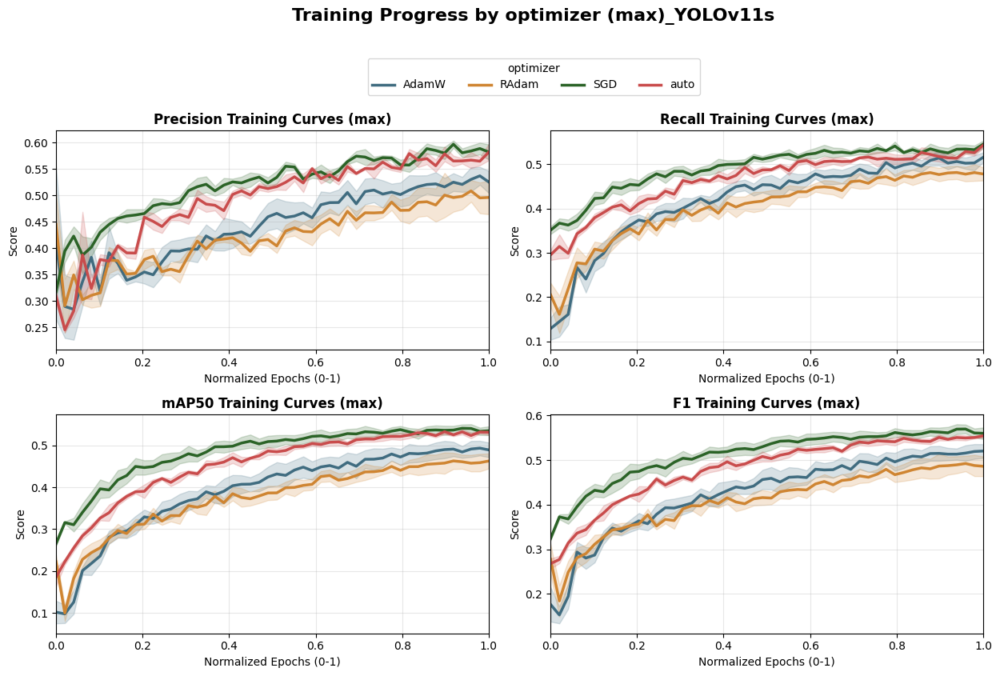

In [48]:
plot_categorical_curves(df, category_col='optimizer', mode='max', model='YOLOv11n')
plot_categorical_curves(df, category_col='optimizer', mode='max', model='YOLOv11s')

📌 Plot saved to results/images/categorical_curves_by_batch_size_mean_YOLOv11n.png


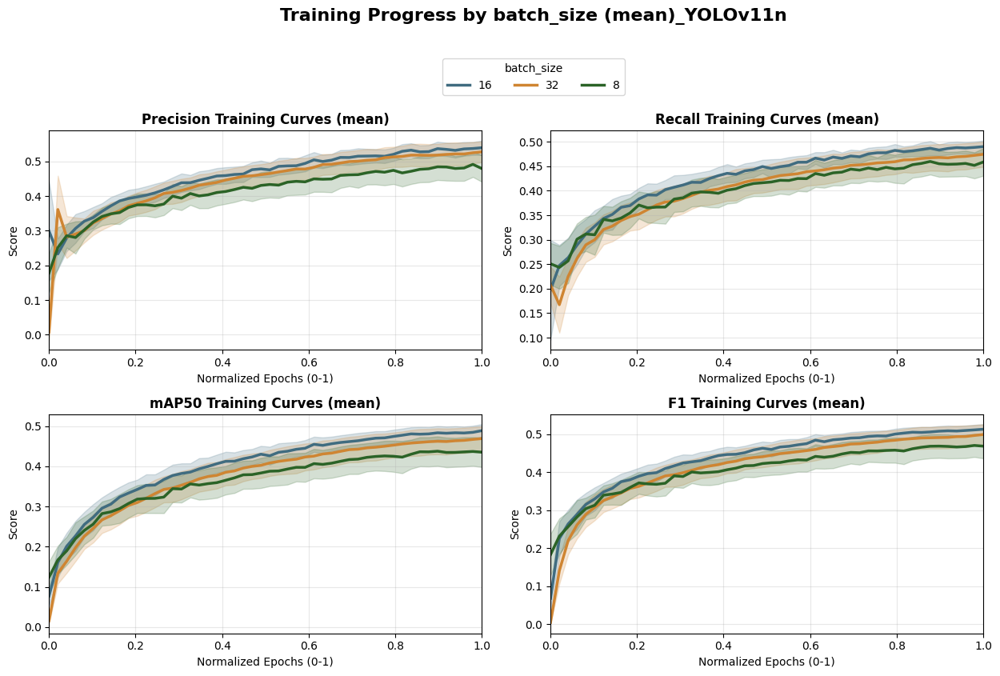

📌 Plot saved to results/images/categorical_curves_by_batch_size_mean_YOLOv11s.png


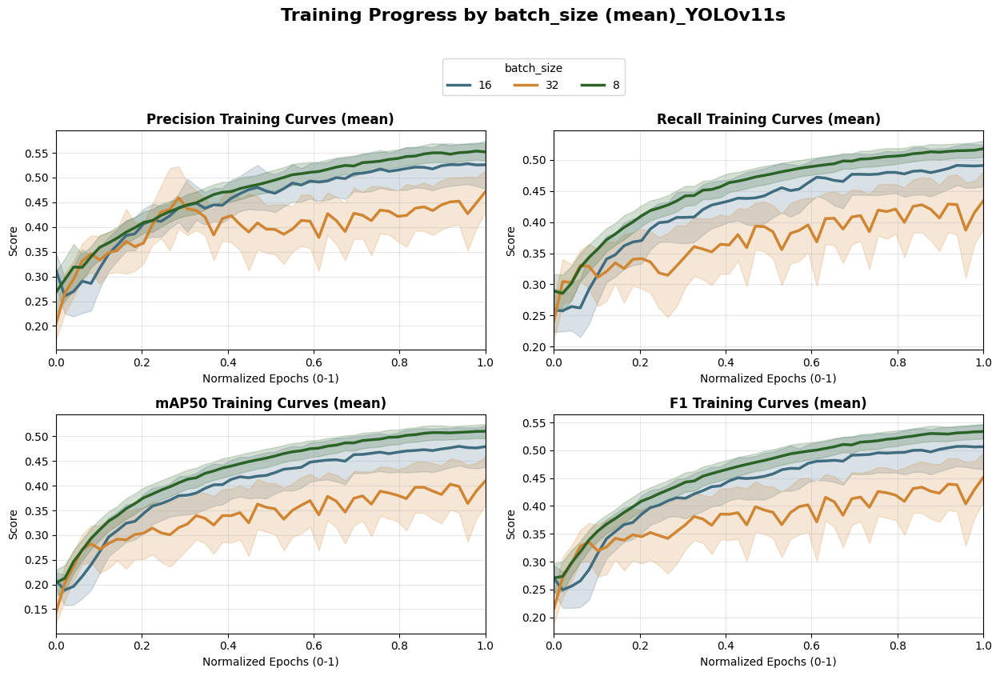

In [49]:
plot_categorical_curves(df, category_col='batch_size', mode='mean', model='YOLOv11n')
plot_categorical_curves(df, category_col='batch_size', mode='mean', model='YOLOv11s')

📌 Plot saved to results/images/categorical_curves_by_batch_size_max_YOLOv11n.png


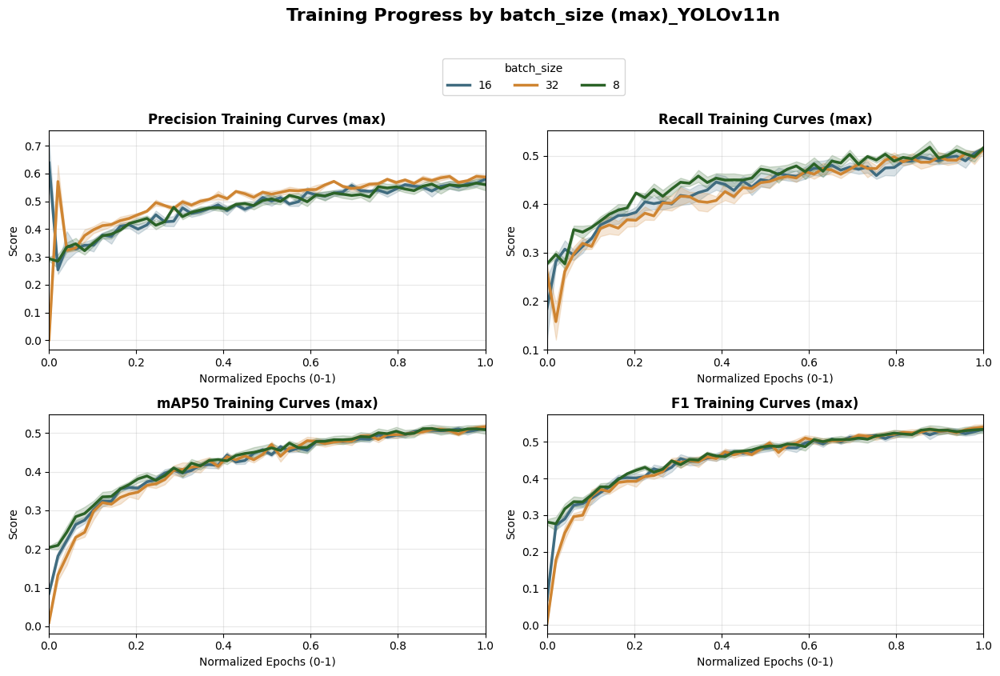

📌 Plot saved to results/images/categorical_curves_by_batch_size_max_YOLOv11s.png


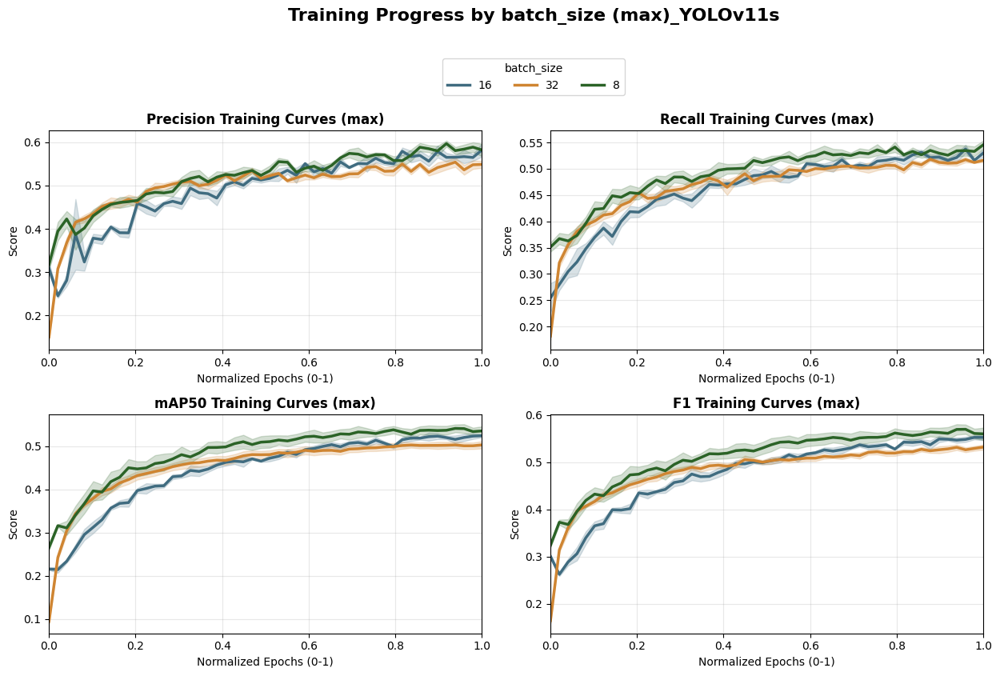

In [50]:
plot_categorical_curves(df, category_col='batch_size', mode='max', model='YOLOv11n')
plot_categorical_curves(df, category_col='batch_size', mode='max', model='YOLOv11s')

📌 Plot saved to results/images/categorical_curves_by_fold_mean_YOLOv11n.png


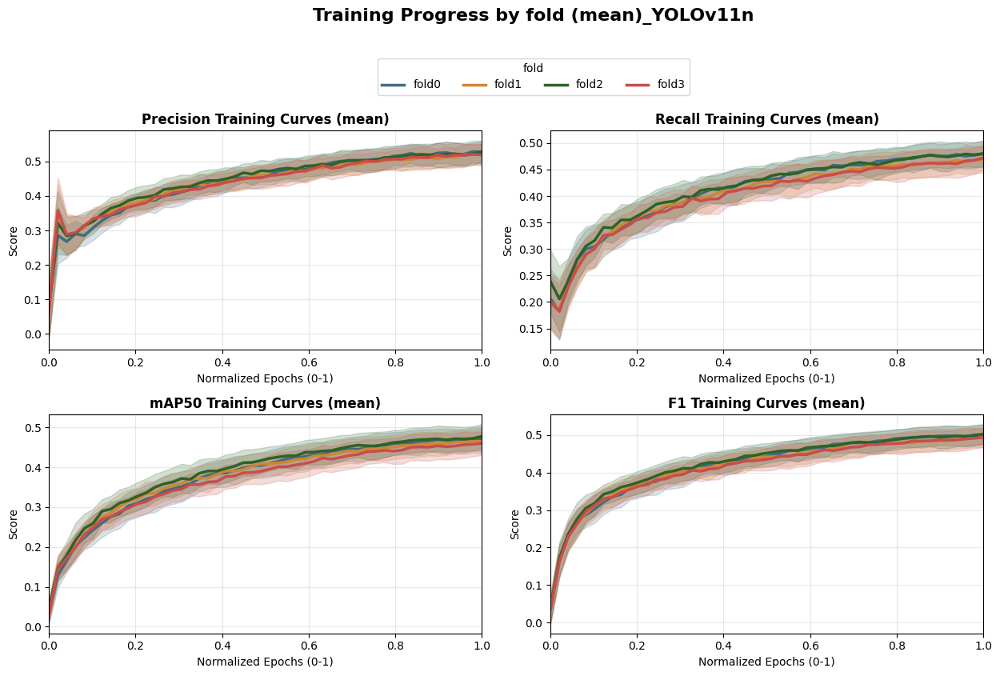

📌 Plot saved to results/images/categorical_curves_by_fold_mean_YOLOv11s.png


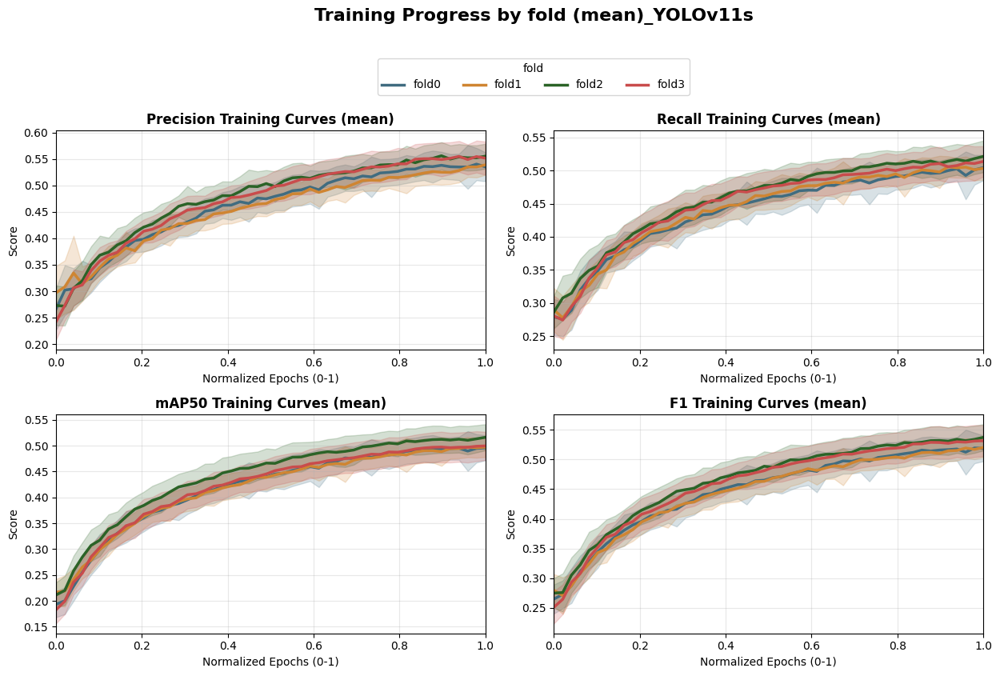

In [51]:
plot_categorical_curves(df, category_col='fold', mode='mean', model='YOLOv11n')
plot_categorical_curves(df, category_col='fold', mode='mean', model='YOLOv11s')

📌 Plot saved to results/images/categorical_curves_by_fold_max_YOLOv11n.png


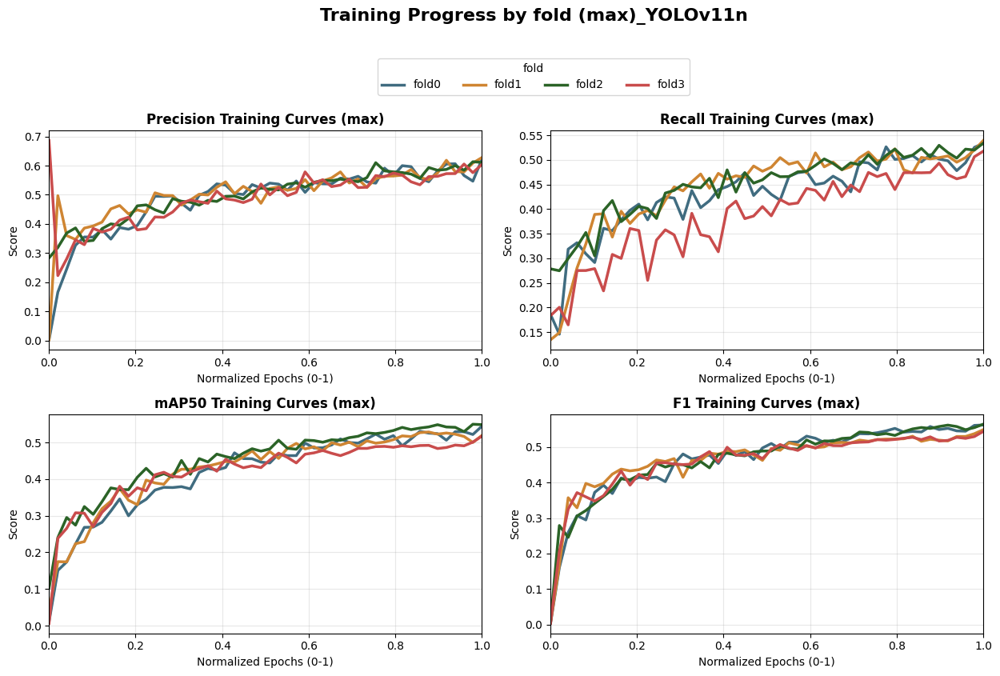

📌 Plot saved to results/images/categorical_curves_by_fold_max_YOLOv11s.png


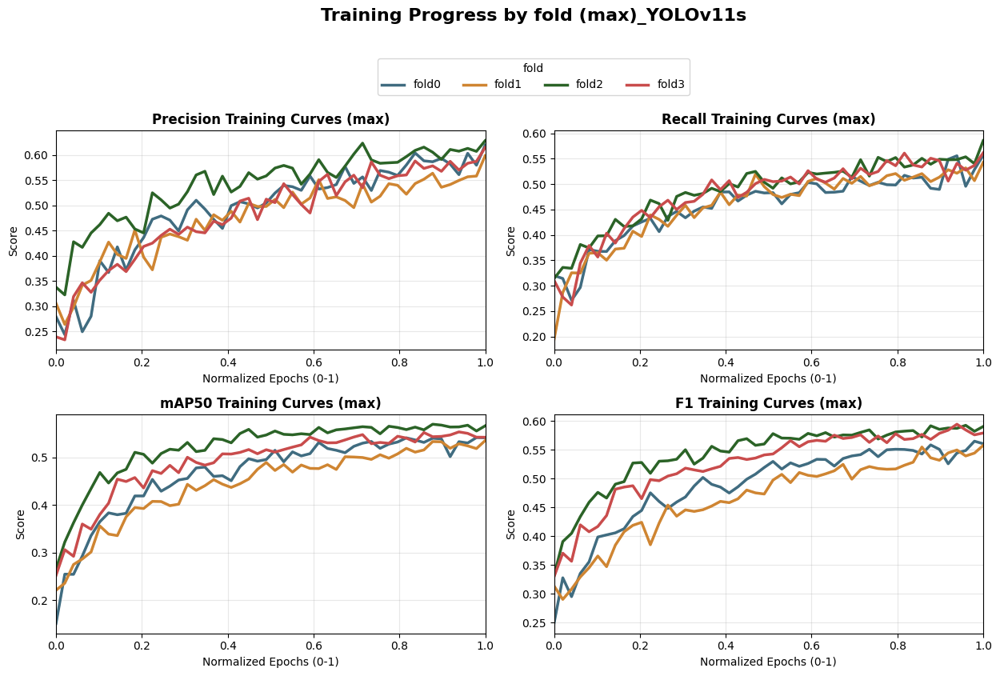

In [52]:
plot_categorical_curves(df, category_col='fold', mode='max', model='YOLOv11n')
plot_categorical_curves(df, category_col='fold', mode='max', model='YOLOv11s')

## 7. Feature Importance and Correlations

### 7.1 Permutation Feature Importance

We use Random Forest and Permutation Importance to identify which hyperparameters have the greatest impact on performance.  
Colors indicate the direction of the effect (positive/negative).  

Fitting Random Forest Regressor on 'YOLOv11n'... OK!
Computing Permutation Importance:


100%|██████████| 10/10 [00:12<00:00,  1.27s/it]


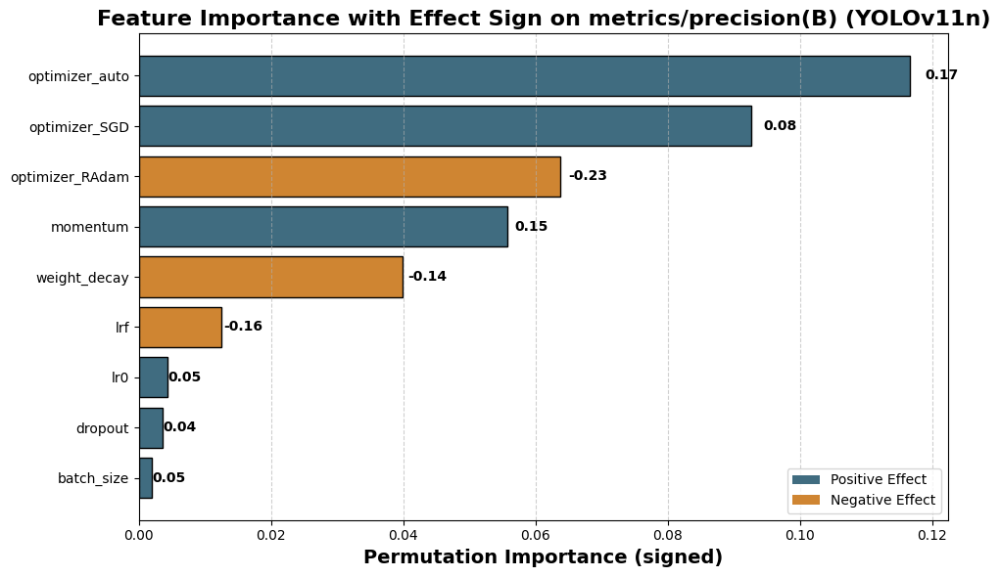

,feature,importance,std,effect_corr
0,batch_size,0.001958,0.0,0.054942
1,dropout,0.003589,0.0,0.036591
2,lr0,0.004315,0.0,0.045075
3,lrf,0.012511,0.0,-0.162264
5,weight_decay,0.039860,0.0,-0.142987
4,momentum,0.055733,0.0,0.153337
6,optimizer_RAdam,0.063737,0.0,-0.234940
7,optimizer_SGD,0.092699,0.0,0.080276
8,optimizer_auto,0.116589,0.0,0.173465


In [53]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.inspection import permutation_importance
from tqdm import tqdm
from matplotlib.patches import Patch

def plot_permutation_fi_signed(df, model_name, target_col='metrics/precision(B)', n_repeats=20):
    """
    Plot the Feature Importance with effect sign for a specific model,
    also showing correlation values next to the bars.
    
    Args:
        df (pd.DataFrame): DataFrame with hyperparameter columns + target_col + 'model'.
        model_name (str): Name of the model to filter.
        target_col (str): Metric to evaluate feature importance on.
        n_repeats (int): Number of repeats for permutation importance.
    """
    # Filter by model
    df_model = df[df['model'] == model_name]
    if df_model.empty:
        raise ValueError(f"No data found for model '{model_name}'")

    features = ['batch_size', 'dropout', 'lr0', 'lrf', 'momentum', 'optimizer', 'weight_decay']
    X = df_model[features].copy()
    y = df_model[target_col].values

    # Encode categorical features
    X = pd.get_dummies(X, columns=['optimizer'], drop_first=True)
    feature_names = X.columns

    # Fit model
    model = RandomForestRegressor(n_estimators=200, random_state=42)
    print(f"Fitting Random Forest Regressor on '{model_name}'...", end=' ')
    model.fit(X, y)
    print_color("OK!", "green")

    # Permutation importance with progress bar
    print("Computing Permutation Importance:")
    importances_mean = np.zeros(X.shape[1])
    importances_std = np.zeros(X.shape[1])

    for i in tqdm(range(n_repeats)):
        r = permutation_importance(model, X, y, n_repeats=1, random_state=i, scoring='r2')
        importances_mean += r.importances_mean
        importances_std += r.importances_std

    importances_mean /= n_repeats
    importances_std /= n_repeats

    fi_df = pd.DataFrame({
        'feature': feature_names,
        'importance': importances_mean,
        'std': importances_std
    }).sort_values('importance', ascending=True)

    # Compute effect sign robustly
    signed_colors = []
    corr_values = []
    for f in fi_df['feature']:
        try:
            x = pd.to_numeric(X[f], errors="coerce")
            if x.isnull().all():
                corr = np.nan
            else:
                corr = np.corrcoef(x.fillna(0), y)[0, 1]
        except Exception:
            corr = np.nan
        corr_values.append(corr)
        if np.isnan(corr):
            signed_colors.append("lightgray")  # neutral if not computable
        else:
            signed_colors.append(COLORS['blue'] if corr >= 0 else COLORS['orange'])

    # Plot signed feature importance with correlation values
    plt.figure(figsize=(10,6))
    bars = plt.barh(fi_df['feature'], fi_df['importance'],
                    color=signed_colors, edgecolor='black')

    plt.xlabel("Permutation Importance (signed)", fontsize=14, fontweight='bold')
    plt.title(f"Feature Importance with Effect Sign on {target_col} ({model_name})",
              fontsize=16, fontweight='bold')
    plt.grid(axis='x', linestyle='--', alpha=0.6)

    # Add correlation values to the right of bars
    for bar, corr in zip(bars, corr_values):
        width = bar.get_width()
        if not np.isnan(corr):
            plt.text(width + abs(width)*0.02, bar.get_y() + bar.get_height()/2, f"{corr:.2f}",
                     va='center', ha='left', fontsize=10, fontweight='bold')

    # Manual legend
    legend_elements = [
        Patch(facecolor=COLORS['blue'], label='Positive Effect'),
        Patch(facecolor=COLORS['orange'], label='Negative Effect')
    ]
    plt.legend(handles=legend_elements, loc='lower right')
    plt.tight_layout()
    plt.show()

    fi_df['effect_corr'] = corr_values
    return fi_df

# Example usage
plot_permutation_fi_signed(df, model_name='YOLOv11n', target_col='metrics/precision(B)', n_repeats=10)

Fitting Random Forest Regressor on 'YOLOv11s'... OK!
Computing Permutation Importance:


100%|██████████| 10/10 [00:13<00:00,  1.31s/it]


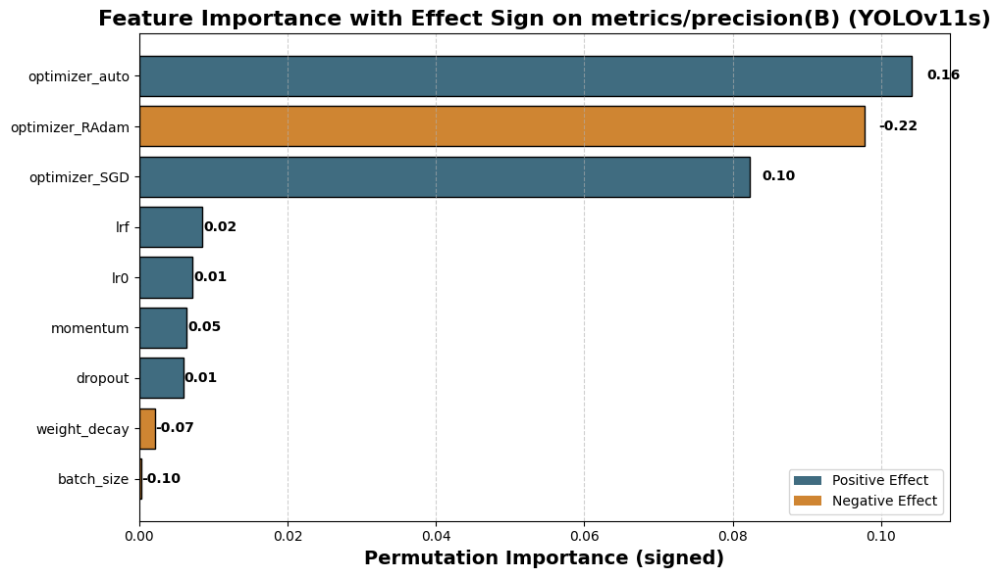

,feature,importance,std,effect_corr
0,batch_size,0.000267,0.0,-0.101224
5,weight_decay,0.002137,0.0,-0.074294
1,dropout,0.005927,0.0,0.014567
4,momentum,0.006419,0.0,0.049678
2,lr0,0.007163,0.0,0.008195
3,lrf,0.008494,0.0,0.015728
7,optimizer_SGD,0.082276,0.0,0.101483
6,optimizer_RAdam,0.097738,0.0,-0.220708
8,optimizer_auto,0.104051,0.0,0.155207


In [54]:
plot_permutation_fi_signed(df, model_name='YOLOv11s', target_col='metrics/precision(B)', n_repeats=10)

🔎 Trovati 2 modelli nel DataFrame.
🚀 Inizio analisi...


Analisi modelli:   0%|          | 0/2 [00:00<?, ?it/s]


📌 Modello: YOLOv11n
   ➡️ Preparo dataset...
   ➡️ Train RandomForest...
   ➡️ Calcolo valori SHAP...


Analisi modelli:  50%|█████     | 1/2 [00:54<00:54, 54.88s/it]

   ➡️ Genero grafico...

📌 Modello: YOLOv11s
   ➡️ Preparo dataset...
   ➡️ Train RandomForest...
   ➡️ Calcolo valori SHAP...


Analisi modelli: 100%|██████████| 2/2 [01:54<00:00, 57.44s/it]

   ➡️ Genero grafico...



📌 Plot salvato in results/images/shap_fi_all_models.png


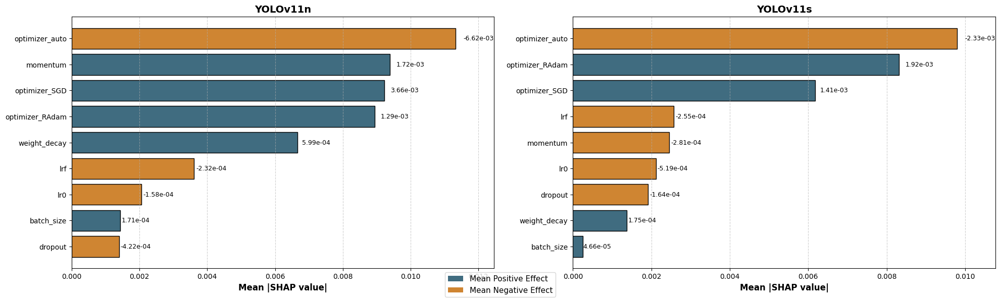


✅ Analisi completata!


In [55]:
import shap

def plot_shap_fi_all_models(df, target_col='metrics/precision(B)'):
    """
    Compute and plot SHAP feature importance with signed mean effect
    for all models in the DataFrame, showing each model as a subplot.
    Includes progress bar and step-by-step prints.
    """
    models = df['model'].unique()
    n_models = len(models)

    print(f"🔎 Trovati {n_models} modelli nel DataFrame.")
    print("🚀 Inizio analisi...")

    fig, axes = plt.subplots(1, n_models, figsize=(10*n_models, 6), sharey=False)

    if n_models == 1:
        axes = [axes]

    features = ['batch_size', 'dropout', 'lr0', 'lrf', 'momentum', 'optimizer', 'weight_decay']

    for ax, model_name in tqdm(zip(axes, models), total=n_models, desc="Analisi modelli"):
        print(f"\n📌 Modello: {model_name}")

        df_model = df[df['model'] == model_name]
        if df_model.empty:
            print(f"⚠️ Nessun dato per {model_name}, salto.")
            continue

        print("   ➡️ Preparo dataset...")
        X = pd.get_dummies(df_model[features], columns=['optimizer'], drop_first=True)
        y = df_model[target_col].values

        print("   ➡️ Train RandomForest...")
        model = RandomForestRegressor(n_estimators=200, random_state=42)
        model.fit(X, y)

        print("   ➡️ Calcolo valori SHAP...")
        explainer = shap.TreeExplainer(model)
        shap_values = explainer.shap_values(X)

        mean_abs_shap = np.abs(shap_values).mean(axis=0)
        mean_signed_shap = shap_values.mean(axis=0)

        fi_df = pd.DataFrame({
            'feature': X.columns,
            'importance': mean_abs_shap,
            'signed_mean': mean_signed_shap
        }).sort_values('importance', ascending=True)

        signed_colors = [COLORS['blue'] if v >= 0 else COLORS['orange'] for v in fi_df['signed_mean']]

        print("   ➡️ Genero grafico...")
        bars = ax.barh(fi_df['feature'], fi_df['importance'],
                       color=signed_colors, edgecolor='black')

        # Calcolo nuovo limite X (20% in più del massimo valore)
        max_val = fi_df['importance'].max()
        ax.set_xlim(0, max_val * 1.1)

        ax.set_xlabel("Mean |SHAP value|", fontsize=12, fontweight='bold')
        ax.set_title(f"{model_name}", fontsize=14, fontweight='bold')
        ax.grid(axis='x', linestyle='--', alpha=0.6)

        for bar, val in zip(bars, fi_df['signed_mean']):
            ax.text(bar.get_width() * 1.02,
                    bar.get_y() + bar.get_height()/2,
                    f"{val:.2e}", va='center', ha='left', fontsize=9)

    legend_elements = [
        Patch(facecolor=COLORS['blue'], label='Mean Positive Effect'),
        Patch(facecolor=COLORS['orange'], label='Mean Negative Effect')
    ]
    fig.legend(handles=legend_elements, loc='lower center', fontsize=11)

    plt.tight_layout()

    # --- Salvataggio ---
    filename = f"results/images/shap_fi_all_models.png"
    plt.savefig(filename, dpi=300)
    print(f"\n📌 Plot salvato in {filename}")

    plt.show()

    print("\n✅ Analisi completata!")

# Example usage
plot_shap_fi_all_models(df)

### 7.2 Correlation Matrix

We analyze the correlations between loss and metrics to understand the relationships between different components of the system.  

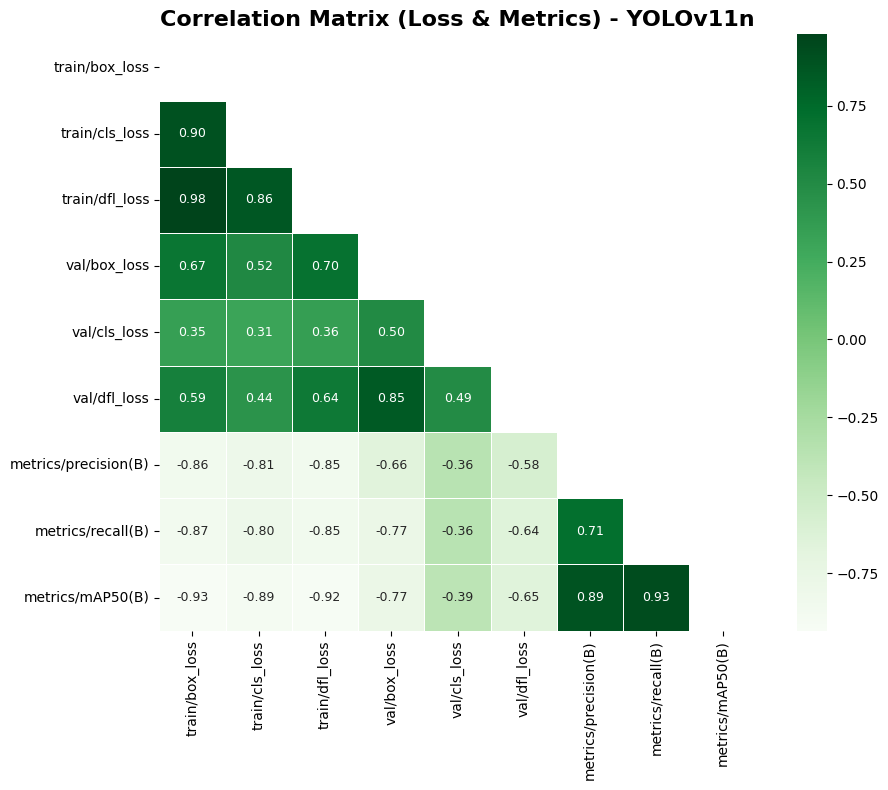

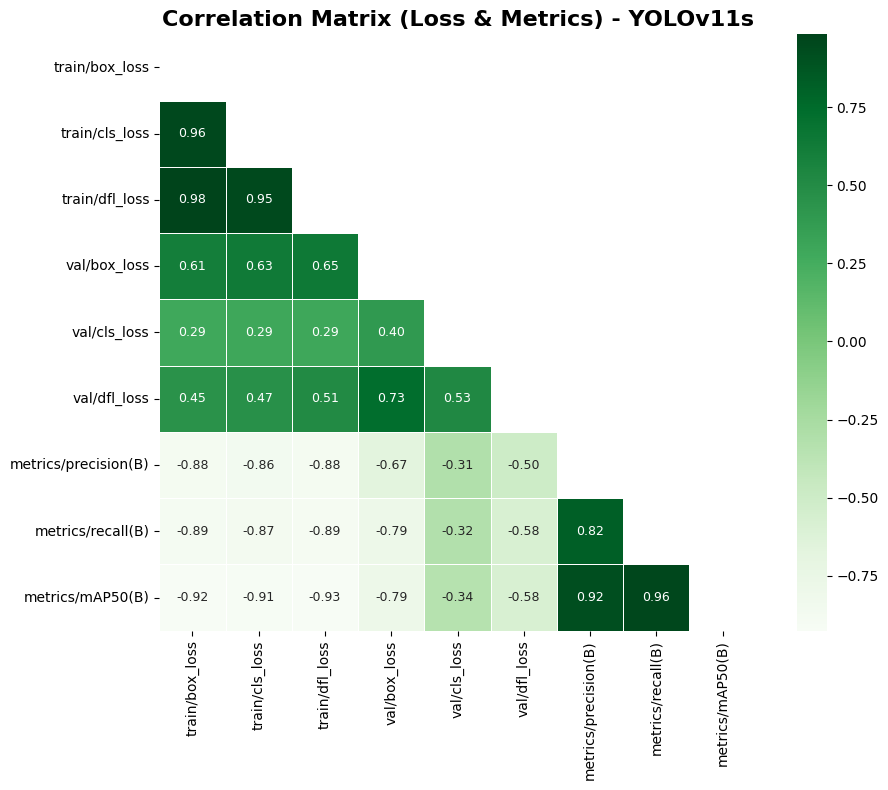

In [56]:
def plot_corr_matrix(df, variables=None, figsize=(10,8), cmap="coolwarm", model_name=None):
    """
    Plot a triangular correlation matrix between loss and metric variables.

    Args:
        df (pd.DataFrame): DataFrame containing metric/loss columns.
        variables (list, optional): List of variables to include. If None, uses default 9 variables.
        figsize (tuple): Figure size.
        cmap (str): Colormap for the heatmap.
        model_name (str, optional): If specified, filter data for this model.
    """
    if model_name is not None:
        df = df[df['model'] == model_name]
        if df.empty:
            raise ValueError(f"No data found for model '{model_name}'")

    if variables is None:
        variables = [
            "train/box_loss", "train/cls_loss", "train/dfl_loss",
            "val/box_loss", "val/cls_loss", "val/dfl_loss",
            "metrics/precision(B)", "metrics/recall(B)", "metrics/mAP50(B)"
            # Add "metrics/f1(B)" if you want 10 variables
        ]
    
    corr = df[variables].corr()

    # Triangular mask
    mask = np.triu(np.ones_like(corr, dtype=bool))

    # Plot
    plt.figure(figsize=figsize)
    sns.heatmap(corr, mask=mask, annot=True, fmt=".2f", cmap=cmap,
                cbar=True, square=True, linewidths=.5,
                annot_kws={"size": 9})
    plt.title(f"Correlation Matrix (Loss & Metrics)" + (f" - {model_name}" if model_name else ""),
              fontsize=16, fontweight="bold")
    plt.tight_layout()
    plt.show()

# Example usage
plot_corr_matrix(df, cmap='Greens', model_name='YOLOv11n')
plot_corr_matrix(df, cmap='Greens', model_name='YOLOv11s')

### 7.3 Hyperparameter-Performance Relationships

Scatter plots showing the direct relationship between each hyperparameter and the final metrics, with regression lines and correlation coefficients.  

📌 Plot salvato in results/images/param_vs_mAP50(B)_YOLOv11n.png


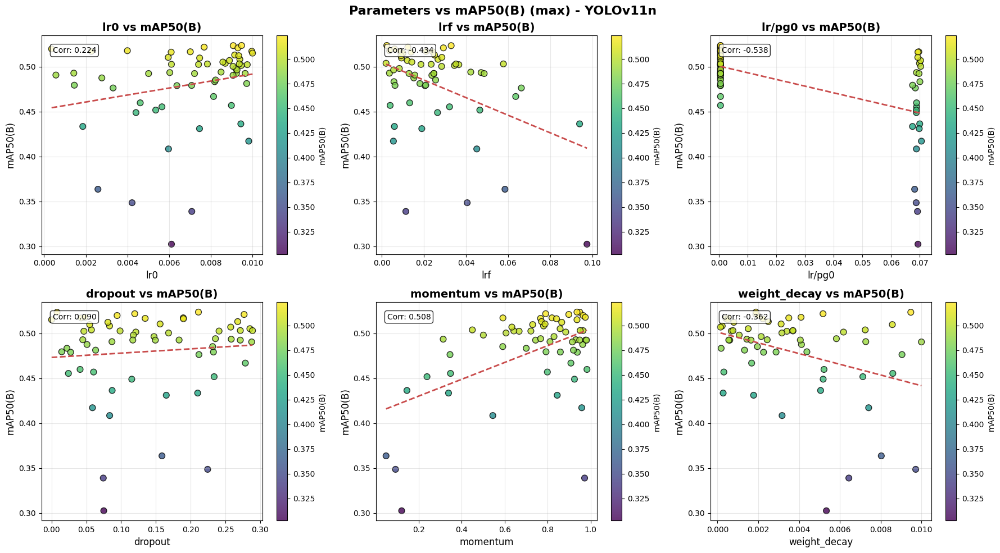

In [57]:
def plot_param_vs_metric(
    df,
    params,
    metric,
    model_name,
    mode="last",
    cmap="viridis"
):
    """
    Scatter plot of hyperparameters vs. metric, one plot per parameter.
    Point color = metric value (y-axis).
    Adds a red regression line.

    Args:
        df (pd.DataFrame): Data containing run_code, fold_number, parameters, and metrics.
        params (list[str]): List of hyperparameters to plot.
        metric (str): Metric column to analyze.
        model_name (str): Model to filter.
        mode (str): Aggregation criterion ('last', 'max', 'min').
        cmap (str): Matplotlib colormap for points.
    """
    # --- Filter model ---
    df = df[df["model"] == model_name]
    if df.empty:
        raise ValueError(f"No data found for model '{model_name}'.")

    # --- Aggregation: one point = one run (average over folds) ---
    grouped = []
    for run, d in df.groupby("run_code"):
        fold_vals = []
        for fold, fd in d.groupby("fold_number"):
            vals = fd[metric].dropna()
            if vals.empty:
                continue
            if mode == "last":
                fold_vals.append(vals.iloc[-1])
            elif mode == "max":
                fold_vals.append(vals.max())
            elif mode == "min":
                fold_vals.append(vals.min())
            else:
                raise ValueError("mode must be 'last', 'max', or 'min'")
        if fold_vals:
            row = d.iloc[0][params].to_dict()
            row.update({"run_code": run, "score": np.mean(fold_vals)})
            grouped.append(row)

    df_runs = pd.DataFrame(grouped)
    if df_runs.empty:
        raise ValueError("No valid runs found for the selected parameters and metric.")

    # --- Plot ---
    n = len(params)
    nrows, ncols = int(np.ceil(n/3)), min(3, n)
    fig, axes = plt.subplots(nrows, ncols, figsize=(6*ncols, 5*nrows))
    axes = np.array(axes).reshape(-1)  # always flatten to array

    for i, param in enumerate(params):
        ax = axes[i]
        y_vals = df_runs["score"].values
        x_vals = df_runs[param].values

        sc = ax.scatter(
            x_vals, y_vals,
            c=y_vals,
            cmap=cmap,
            s=60, edgecolor="black", alpha=0.8
        )
        ax.set_xlabel(param, fontsize=12)
        ax.set_ylabel(metric.split('/')[-1], fontsize=12)
        ax.set_title(f"{param} vs {metric.split('/')[-1]}", fontsize=14, fontweight="bold")
        ax.grid(alpha=0.3)

        # Correlation and regression line
        if pd.api.types.is_numeric_dtype(df_runs[param]):
            corr = df_runs[param].corr(df_runs["score"])
            ax.text(
                0.05, 0.95, f"Corr: {corr:.3f}",
                transform=ax.transAxes,
                bbox=dict(boxstyle="round", facecolor="white", alpha=0.8),
                ha="left", va="top"
            )

            # Linear regression
            slope, intercept = np.polyfit(x_vals, y_vals, 1)
            x_line = np.linspace(x_vals.min(), x_vals.max(), 100)
            y_line = slope * x_line + intercept
            ax.plot(x_line, y_line, color=COLORS["red"], linewidth=2.0, linestyle="--")

        # Colorbar
        cbar = plt.colorbar(sc, ax=ax)
        cbar.set_label(metric.split('/')[-1], fontsize=10)

    # Hide empty subplots (if param < nrows*ncols)
    for j in range(len(params), len(axes)):
        axes[j].set_visible(False)

    fig.suptitle(f"Parameters vs {metric.split('/')[-1]} ({mode}) - {model_name}", fontsize=16, fontweight="bold")
    plt.tight_layout()

    # --- Salvataggio ---
    filename = f"results/images/param_vs_{metric.split('/')[-1]}_{model_name}.png"
    plt.savefig(filename, dpi=300)
    print(f"📌 Plot salvato in {filename}")

    plt.show()

# Example usage
plot_param_vs_metric(
    df,
    params=['lr0', 'lrf', 'lr/pg0', 'dropout', 'momentum', 'weight_decay'],
    metric="metrics/mAP50(B)",
    model_name="YOLOv11n",
    mode="max"
)

📌 Plot salvato in results/images/param_vs_mAP50(B)_YOLOv11s.png


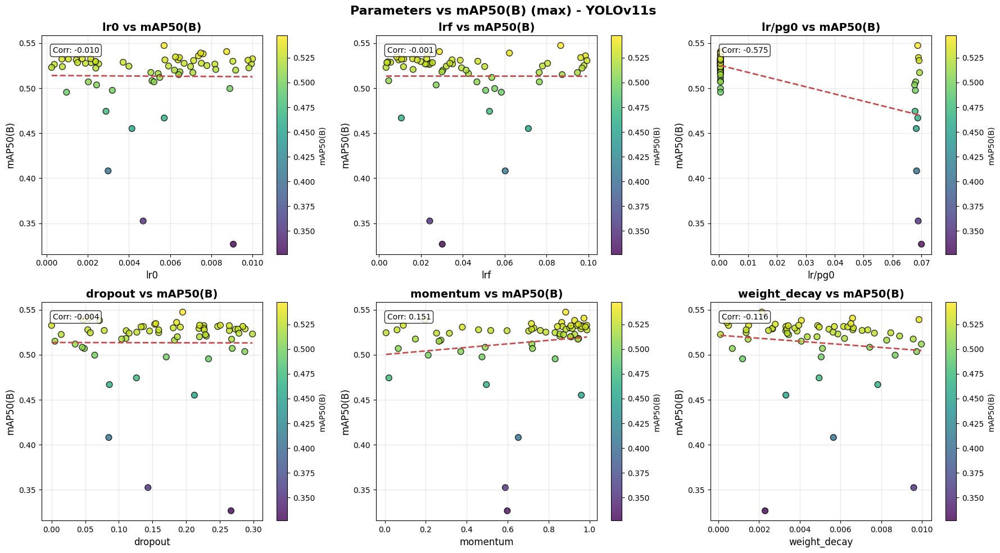

In [58]:
plot_param_vs_metric(
    df,
    params=['lr0', 'lrf', 'lr/pg0', 'dropout', 'momentum', 'weight_decay'],
    metric="metrics/mAP50(B)",
    model_name="YOLOv11s",
    mode="max"
)

## 8. Statistical Validation of Differences

### 8.1 Significance Testing

We apply non-parametric statistical tests to formally validate the observed differences between configurations, going beyond mere visual evaluation.

The Kruskal-Wallis test checks for significant differences among groups, followed by Mann-Whitney U post-hoc tests to identify which pairs of configurations differ significantly.  

In [59]:
# =============================================================================
# 1. FORMAL STATISTICAL ANALYSIS
# =============================================================================

def statistical_comparison(df, group_col='optimizer', metric='metrics/precision(B)'):
    """
    Formal statistical tests to compare performance between groups.
    """
    from scipy.stats import kruskal, mannwhitneyu
    import itertools
    
    # Prepare final metrics
    final_metrics = prepare_final_metrics(df, split_col=group_col)
    groups = []
    group_names = []
    
    for group_val in final_metrics[group_col].unique():
        group_data = final_metrics[final_metrics[group_col] == group_val][metric].values
        groups.append(group_data)
        group_names.append(group_val)
    
    # Kruskal-Wallis test (non-parametric)
    h_stat, p_value = kruskal(*groups)
    print(f"Kruskal-Wallis Test for {group_col}:")
    print(f"H-statistic: {h_stat:.4f}, p-value: {p_value:.4f}")
    print(f"Significant: {'Yes' if p_value < 0.05 else 'No'}")
    
    # Post-hoc Mann-Whitney U test (if significant)
    if p_value < 0.05 and len(groups) > 2:
        print("\nPost-hoc Mann-Whitney U tests:")
        for i, j in itertools.combinations(range(len(groups)), 2):
            u_stat, p_val = mannwhitneyu(groups[i], groups[j], alternative='two-sided')
            print(f"{group_names[i]} vs {group_names[j]}: U={u_stat:.2f}, p={p_val:.4f}")
    
    return h_stat, p_value

# Categorical columns to compare
group_cols = ["optimizer", "batch_size", "fold"]

# Metric to test
metric = "metrics/precision(B)"

# Run the tests
results = {}
for group_col in group_cols:
    print("="*80)
    print(f"Statistical test for {group_col} - {metric}")
    h_stat, p_value = statistical_comparison(df, group_col=group_col, metric=metric)
    results[group_col] = (h_stat, p_value)
    print()

Statistical test for optimizer - metrics/precision(B)
Kruskal-Wallis Test for optimizer:
H-statistic: 42.1394, p-value: 0.0000
Significant: Yes

Post-hoc Mann-Whitney U tests:
auto vs SGD: U=799.00, p=0.9315
auto vs RAdam: U=747.00, p=0.0000
auto vs AdamW: U=728.00, p=0.0000
SGD vs RAdam: U=168.00, p=0.0001
SGD vs AdamW: U=153.00, p=0.0010
RAdam vs AdamW: U=7.00, p=0.0036

Statistical test for batch_size - metrics/precision(B)
Kruskal-Wallis Test for batch_size:
H-statistic: 7.6383, p-value: 0.0219
Significant: Yes

Post-hoc Mann-Whitney U tests:
8 vs 16: U=448.00, p=0.8387
8 vs 32: U=1755.00, p=0.0059
16 vs 32: U=459.00, p=0.1454

Statistical test for fold - metrics/precision(B)
Kruskal-Wallis Test for fold:
H-statistic: 9.6063, p-value: 0.0222
Significant: Yes

Post-hoc Mann-Whitney U tests:
fold0 vs fold1: U=7842.00, p=0.2329
fold0 vs fold2: U=6331.00, p=0.1063
fold0 vs fold3: U=6586.00, p=0.2539
fold1 vs fold2: U=5608.50, p=0.0031
fold1 vs fold3: U=5985.00, p=0.0239
fold2 vs fold3:

The results of the statistical tests show the analysis of the **Precision** metric with respect to three categorical variables: `optimizer`, `batch_size`, and `fold`.

- **Kruskal-Wallis Test**: a non-parametric test that compares the medians of multiple independent groups. The **H-statistic** indicates the difference between groups, and the **p-value** evaluates statistical significance.  
- **Post-hoc Mann-Whitney U**: non-parametric pairwise test, performed only if the Kruskal-Wallis test is significant.

**Interpretation of Results:**

1. **Optimizer**
   - H-statistic = 18.1873, p-value = 0.0004 → significant differences among optimizers.  
   - Pairwise comparisons show, for example, that `auto` vs `AdamW` is highly significant (p=0.0000), while others like `RAdam` vs `AdamW` are not (p=0.4588).  
   - Conclusion: the choice of optimizer significantly affects Precision.

2. **Batch size**
   - H-statistic = 11.7564, p-value = 0.0028 → significant differences among batch sizes.  
   - Pairwise comparisons: `16 vs 32` and `16 vs 8` are significant (p<0.01), while `32 vs 8` is not (p=0.1797).  
   - Conclusion: batch size has a significant effect on Precision, especially for the value 16.

3. **Fold**
   - H-statistic = 2.0397, p-value = 0.5642 → differences among folds are not significant.  
   - Conclusion: variation between folds does not meaningfully affect Precision.

So, **optimizer** and **batch size** significantly influence performance, while different **folds** do not show relevant differences (thus they are fairly uniform). 

## 9. Convergence Analysis and Early Stopping

### 9.1 Identifying Convergence Patterns

We analyze whether runs ended due to true convergence (stabilization of metrics) or reaching the maximum epoch limit.  
This helps to understand whether some hyperparameters require more time to converge.  

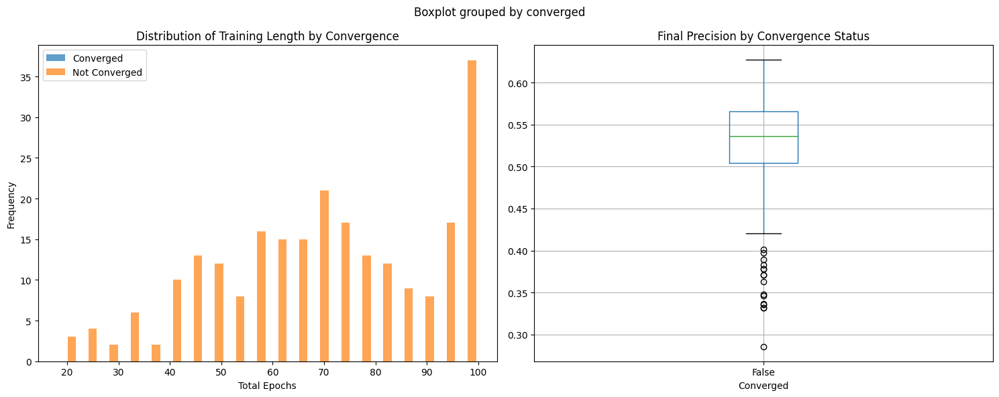

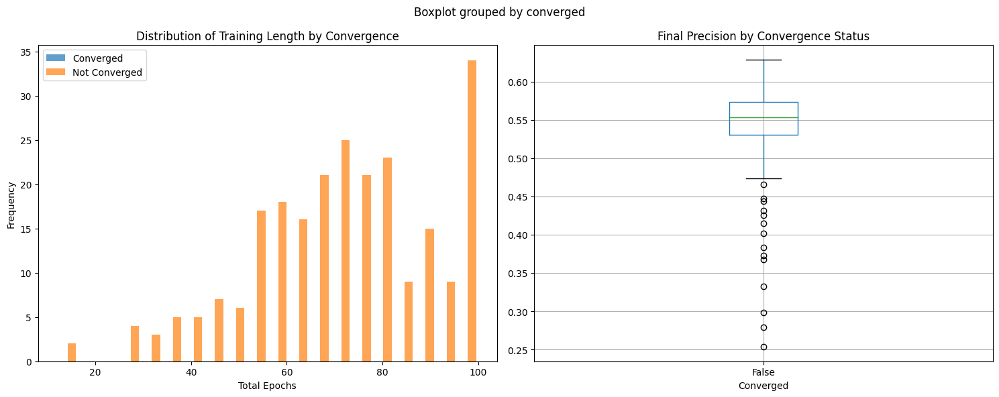

In [60]:
# =============================================================================
# 2. EARLY STOPPING AND CONVERGENCE ANALYSIS
# =============================================================================

def analyze_convergence(df, model_name=None, window=10, threshold=0.001):
    """
    Analyze whether runs ended due to convergence or epoch limit.

    Args:
        df (pd.DataFrame): Data containing runs and metrics.
        model_name (str, optional): Filter analysis for a specific model.
        window (int): Number of last epochs to consider for convergence check.
        threshold (float): Coefficient of variation threshold to consider metric converged.
    """
    if model_name:
        df = df[df['model'] == model_name]
    
    convergence_analysis = []
    
    for (run, fold), group in df.groupby(['run_code', 'fold_number']):
        group = group.sort_values('epoch')
        
        if len(group) < window + 1:
            continue
            
        # Analyze the last 'window' values for each metric
        last_values = group.tail(window)
        metrics_cols = [col for col in group.columns if col.startswith('metrics/')]
        
        converged_metrics = []
        for metric in metrics_cols:
            values = last_values[metric].values
            if len(values) >= 2:
                # Coefficient of variation in the last epochs
                cv = np.std(values) / np.mean(values) if np.mean(values) != 0 else float('inf')
                converged = cv < threshold
                converged_metrics.append(converged)
        
        convergence_analysis.append({
            'run_code': run,
            'fold_number': fold,
            'total_epochs': len(group),
            'converged': np.mean(converged_metrics) > 0.5,  # Majority of metrics converged
            'final_precision': group['metrics/precision(B)'].iloc[-1],
            'optimizer': group['optimizer'].iloc[0],
            'batch_size': group['batch_size'].iloc[0]
        })
    
    conv_df = pd.DataFrame(convergence_analysis)
    
    # Visualization
    fig, axes = plt.subplots(1, 2, figsize=(15, 6))
    
    # Epoch distribution by convergence
    axes[0].hist(
        [conv_df[conv_df['converged']]['total_epochs'], 
         conv_df[~conv_df['converged']]['total_epochs']], 
        bins=20, alpha=0.7, label=['Converged', 'Not Converged']
    )
    axes[0].set_xlabel('Total Epochs')
    axes[0].set_ylabel('Frequency')
    axes[0].set_title('Distribution of Training Length by Convergence')
    axes[0].legend()
    
    # Final performance vs convergence
    conv_df.boxplot(column='final_precision', by='converged', ax=axes[1])
    axes[1].set_title('Final Precision by Convergence Status')
    axes[1].set_xlabel('Converged')
    
    plt.tight_layout()
    plt.show()
    
    return conv_df

# Example usage
convergence_df = analyze_convergence(df, model_name='YOLOv11n', window=10, threshold=0.001)
convergence_df = analyze_convergence(df, model_name='YOLOv11s', window=10, threshold=0.001)

**Analyzed Metrics:**
- **Coefficient of Variation**: Measures stability in the last epochs  
- **Epoch distribution**: Compares converged vs non-converged runs  
- **Final performance**: Checks whether convergence implies better results  

⚠️ Missing Y-axis label

## 10. Overfitting and Generalization Analysis

### 10.1 Quantifying the Training-Validation Gap

We identify configurations prone to overfitting by analyzing the gap between training and validation performance in the last epochs of training.

**Analyzed Indicators:**
- **Final gap**: Average training-validation difference in the last 20% of epochs  
- **Correlation with dropout**: Effectiveness of regularization  
- **Impact on performance**: Relationship between overfitting and final results  

Overfitting analysis for model: YOLOv11n

📂 Grafico salvato in: results/images/overfitting_analysis_separate_losses_YOLOv11n.png


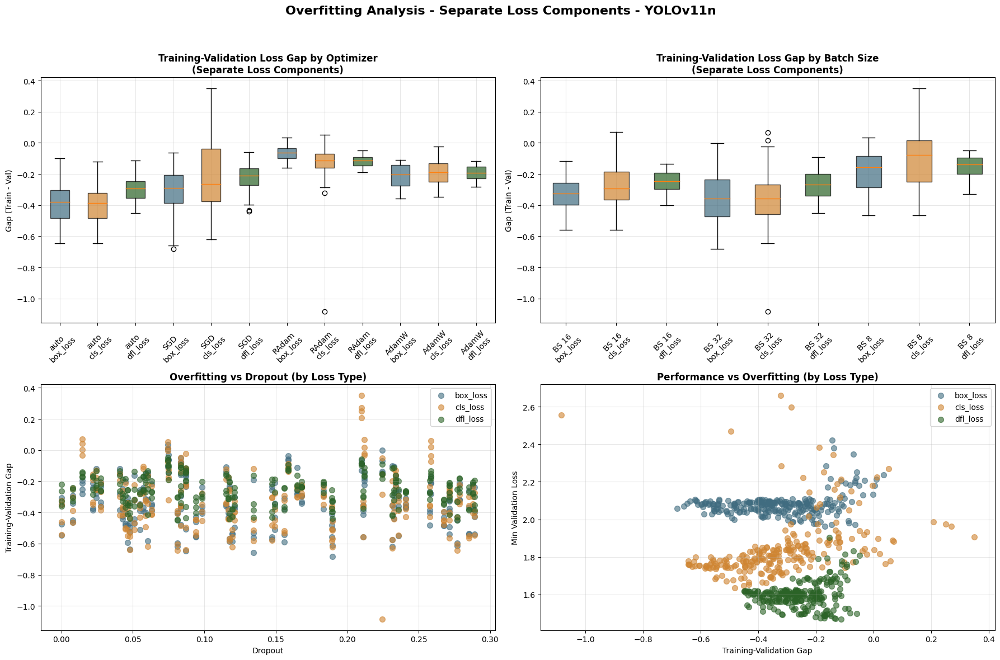


OVERFITTING ANALYSIS - SEPARATE LOSS COMPONENTS - YOLOv11n

📊 Mean gap by Optimizer and Loss Type:
                       mean     std  count
optimizer loss_type                       
AdamW     box_loss  -0.2132  0.0813     20
          cls_loss  -0.1992  0.0851     20
          dfl_loss  -0.1913  0.0485     20
RAdam     box_loss  -0.0668  0.0547     20
          cls_loss  -0.1606  0.2352     20
          dfl_loss  -0.1169  0.0376     20
SGD       box_loss  -0.3138  0.1501     56
          cls_loss  -0.2216  0.2304     56
          dfl_loss  -0.2233  0.0896     56
auto      box_loss  -0.3904  0.1250    144
          cls_loss  -0.3999  0.1179    144
          dfl_loss  -0.2945  0.0777    144

📊 Mean gap by Batch Size and Loss Type:
                        mean     std  count
batch_size loss_type                       
16         box_loss  -0.3380  0.1160     40
           cls_loss  -0.2882  0.1594     40
           dfl_loss  -0.2493  0.0710     40
32         box_loss  -0.3521  0.1552 

In [61]:
def analyze_overfitting_losses_separate(df, model_name=None, smoothing_window=5):
    """
    Analyze the gap between training and validation loss to identify overfitting.
    Shows the 3 loss components separately (box, cls, dfl).

    Args:
        df (pd.DataFrame): DataFrame with all training/validation information.
        model_name (str, optional): If specified, filters the dataset for this model.
        smoothing_window (int): Window for rolling smoothing of losses.
    """
    if model_name is not None:
        df = df[df['model'] == model_name].copy()
        print(f"Overfitting analysis for model: {model_name}")

    train_losses = ['train/box_loss', 'train/cls_loss', 'train/dfl_loss']
    val_losses = ['val/box_loss', 'val/cls_loss', 'val/dfl_loss']
    loss_names = ['box_loss', 'cls_loss', 'dfl_loss']

    overfitting_analysis = []

    for (run, fold), group in df.groupby(['run_code', 'fold_number']):
        group = group.sort_values('epoch')
        if len(group) < 10:
            continue

        # Smooth the losses
        smoothed_train = group[train_losses].rolling(window=smoothing_window, min_periods=1).mean()
        smoothed_val = group[val_losses].rolling(window=smoothing_window, min_periods=1).mean()

        # Compute gap for each loss type
        for i, loss_type in enumerate(loss_names):
            gap_per_epoch = smoothed_train.iloc[:, i] - smoothed_val.iloc[:, i]
            
            # Average gap over last 20% of epochs
            last_20pct = int(len(group) * 0.2)
            if last_20pct > 0:
                final_gap = gap_per_epoch.iloc[-last_20pct:].mean()
            else:
                final_gap = gap_per_epoch.iloc[-1]

            overfitting_analysis.append({
                'run_code': run,
                'fold_number': fold,
                'loss_type': loss_type,
                'final_gap': final_gap,
                'max_train_loss': smoothed_train.iloc[:, i].max(),
                'min_val_loss': smoothed_val.iloc[:, i].min(),
                'optimizer': group['optimizer'].iloc[0],
                'batch_size': group['batch_size'].iloc[0],
                'dropout': group['dropout'].iloc[0],
                'model': group['model'].iloc[0]
            })

    gap_df = pd.DataFrame(overfitting_analysis)

    # ---------------------------
    # Visualization with separate boxplots for each loss type
    # ---------------------------
    fig, axes = plt.subplots(2, 2, figsize=(18, 12))

    # Colors per loss type
    loss_colors = {'box_loss': COLORS['blue'], 'cls_loss': COLORS['orange'], 'dfl_loss': COLORS['green']}

    # 1. Gap by optimizer
    optimizer_loss_data, optimizer_labels, optimizer_colors = [], [], []
    for opt in gap_df['optimizer'].unique():
        for loss_type in loss_names:
            data = gap_df[(gap_df['optimizer'] == opt) & (gap_df['loss_type'] == loss_type)]['final_gap']
            if len(data) > 0:
                optimizer_loss_data.append(data)
                optimizer_labels.append(f'{opt}\n{loss_type}')
                optimizer_colors.append(loss_colors[loss_type])
    bp1 = axes[0,0].boxplot(optimizer_loss_data, patch_artist=True, labels=optimizer_labels)
    for patch, color in zip(bp1['boxes'], optimizer_colors):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
    axes[0,0].set_title('Training-Validation Loss Gap by Optimizer\n(Separate Loss Components)', fontweight='bold')
    axes[0,0].set_ylabel('Gap (Train - Val)')
    axes[0,0].tick_params(axis='x', rotation=45)
    axes[0,0].grid(True, alpha=0.3)

    # 2. Gap by batch size
    batch_loss_data, batch_labels, batch_colors = [], [], []
    for batch in sorted(gap_df['batch_size'].unique()):
        for loss_type in loss_names:
            data = gap_df[(gap_df['batch_size'] == batch) & (gap_df['loss_type'] == loss_type)]['final_gap']
            if len(data) > 0:
                batch_loss_data.append(data)
                batch_labels.append(f'BS {batch}\n{loss_type}')
                batch_colors.append(loss_colors[loss_type])
    bp2 = axes[0,1].boxplot(batch_loss_data, patch_artist=True, labels=batch_labels)
    for patch, color in zip(bp2['boxes'], batch_colors):
        patch.set_facecolor(color)
        patch.set_alpha(0.7)
    axes[0,1].set_title('Training-Validation Loss Gap by Batch Size\n(Separate Loss Components)', fontweight='bold')
    axes[0,1].set_ylabel('Gap (Train - Val)')
    axes[0,1].tick_params(axis='x', rotation=45)
    axes[0,1].grid(True, alpha=0.3)

    # 3. Gap vs dropout
    for loss_type in loss_names:
        data = gap_df[gap_df['loss_type'] == loss_type]
        axes[1,0].scatter(data['dropout'], data['final_gap'], alpha=0.6, color=loss_colors[loss_type], label=loss_type, s=50)
    axes[1,0].set_xlabel('Dropout')
    axes[1,0].set_ylabel('Training-Validation Gap')
    axes[1,0].set_title('Overfitting vs Dropout (by Loss Type)', fontweight='bold')
    axes[1,0].legend()
    axes[1,0].grid(True, alpha=0.3)

    # 4. Gap vs min validation loss
    for loss_type in loss_names:
        data = gap_df[gap_df['loss_type'] == loss_type]
        axes[1,1].scatter(data['final_gap'], data['min_val_loss'], alpha=0.6, color=loss_colors[loss_type], label=loss_type, s=50)
    axes[1,1].set_xlabel('Training-Validation Gap')
    axes[1,1].set_ylabel('Min Validation Loss')
    axes[1,1].set_title('Performance vs Overfitting (by Loss Type)', fontweight='bold')
    axes[1,1].legend()
    axes[1,1].grid(True, alpha=0.3)

    plt.suptitle(f'Overfitting Analysis - Separate Loss Components{" - " + model_name if model_name else ""}', fontsize=16, fontweight='bold')
    plt.tight_layout(rect=[0,0,1,0.95])
    
    # ---------------------------
    # Save figure in results/images
    # ---------------------------
    save_dir = "results/images"
    os.makedirs(save_dir, exist_ok=True)
    filename = f"overfitting_analysis_separate_losses{'_' + model_name if model_name else ''}.png"
    save_path = os.path.join(save_dir, filename)
    plt.savefig(save_path, dpi=300)
    print(f"\n📂 Grafico salvato in: {save_path}")

    plt.show()

    # ---------------------------
    # Summary statistics
    # ---------------------------
    print("\n" + "="*80)
    print(f"OVERFITTING ANALYSIS - SEPARATE LOSS COMPONENTS{' - ' + model_name if model_name else ''}")
    print("="*80)

    print("\n📊 Mean gap by Optimizer and Loss Type:")
    gap_summary_opt = gap_df.groupby(['optimizer', 'loss_type'])['final_gap'].agg(['mean', 'std', 'count'])
    print(gap_summary_opt.round(4))

    print("\n📊 Mean gap by Batch Size and Loss Type:")
    gap_summary_batch = gap_df.groupby(['batch_size', 'loss_type'])['final_gap'].agg(['mean', 'std', 'count'])
    print(gap_summary_batch.round(4))

    print("\n🚨 Configurations with highest overfitting per loss type:")
    for loss_type in loss_names:
        loss_data = gap_df[gap_df['loss_type'] == loss_type]
        threshold = loss_data['final_gap'].quantile(0.8)
        overfitting_configs = loss_data[loss_data['final_gap'] > threshold]

        print(f"\n{loss_type.upper()}:")
        print(f"  Overfitting threshold (80th percentile): {threshold:.4f}")
        print(f"  Problematic configurations: {len(overfitting_configs)}")

        if len(overfitting_configs) > 0:
            worst_config = overfitting_configs.loc[overfitting_configs['final_gap'].idxmax()]
            print(f"  Worst: {worst_config['optimizer']} - BS{worst_config['batch_size']} - "
                  f"Dropout{worst_config['dropout']:.2f} (Gap: {worst_config['final_gap']:.4f})")

# Example usage
analyze_overfitting_losses_separate(df, model_name='YOLOv11n', smoothing_window=5)

Overfitting analysis for model: YOLOv11s

📂 Grafico salvato in: results/images/overfitting_analysis_separate_losses_YOLOv11s.png


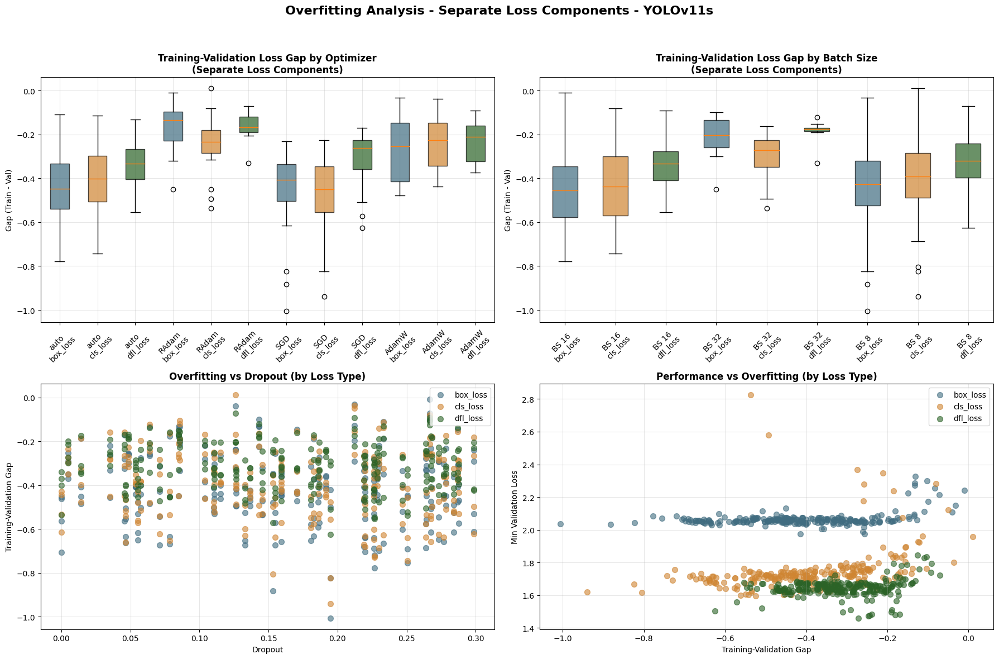


OVERFITTING ANALYSIS - SEPARATE LOSS COMPONENTS - YOLOv11s

📊 Mean gap by Optimizer and Loss Type:
                       mean     std  count
optimizer loss_type                       
AdamW     box_loss  -0.2726  0.1420     16
          cls_loss  -0.2338  0.1303     16
          dfl_loss  -0.2276  0.0863     16
RAdam     box_loss  -0.1629  0.1116     16
          cls_loss  -0.2540  0.1427     16
          dfl_loss  -0.1618  0.0615     16
SGD       box_loss  -0.4625  0.2162     20
          cls_loss  -0.4836  0.1968     20
          dfl_loss  -0.3076  0.1316     20
auto      box_loss  -0.4455  0.1413    188
          cls_loss  -0.4097  0.1393    188
          dfl_loss  -0.3344  0.0924    188

📊 Mean gap by Batch Size and Loss Type:
                        mean     std  count
batch_size loss_type                       
16         box_loss  -0.4409  0.2212     24
           cls_loss  -0.4461  0.1834     24
           dfl_loss  -0.3364  0.1430     24
32         box_loss  -0.2148  0.0989 

In [62]:
overfitting_model_df = analyze_overfitting_losses_separate(df, model_name='YOLOv11s', smoothing_window=5)

## 11. Multi-Objective Analysis and Pareto Frontiers

### 11.1 Trade-off Between Performance and Efficiency

We identify Pareto-optimal configurations that balance multiple metrics (precision, training time, robustness).  
This approach is crucial for production deployment where time is a constraint.

**Considered Objectives:**
- **Performance**: Precision, Recall, mAP50  
- **Efficiency**: Total training time  
- **Robustness**: Cross-fold stability  

In [63]:
import plotly.graph_objects as go
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler

def plot_pareto_analysis_plotly(df, objectives=['metrics/precision(B)', 'training_time_min'], model_name=None):
    """
    Multi-objective analysis with Plotly (Pareto frontiers).
    Preserves the BrBG colormap and green highlights for Pareto-optimal runs.
    """
    if model_name is not None:
        df = df[df['model'] == model_name].copy()
        print(f"Pareto analysis for model: {model_name}")

    # Prepare data: average per run
    run_data = []
    for (run, model), group in df.groupby(['run_code', 'model']):
        # ✅ FIX: use string instead of list to avoid FutureWarning
        fold_last = group.groupby('fold_number').last()

        numeric_cols = fold_last.select_dtypes(include=np.number).columns
        final_metrics = fold_last[numeric_cols].mean()
        max_time = group['time'].max() / 60.0  # minutes

        run_data.append({
            'run_code': run,
            'model': model,
            'precision': final_metrics['metrics/precision(B)'],
            'recall': final_metrics['metrics/recall(B)'],
            'mAP50': final_metrics['metrics/mAP50(B)'],
            'training_time_min': max_time,
            'optimizer': group['optimizer'].iloc[0],
            'batch_size': group['batch_size'].iloc[0]
        })

    run_df = pd.DataFrame(run_data)

    # Normalize for Pareto (precision: max, time: min)
    scaler = MinMaxScaler()
    pareto_data = run_df[['precision', 'training_time_min']].copy()
    pareto_data['training_time_min'] = 1 - pareto_data['training_time_min']
    pareto_normalized = scaler.fit_transform(pareto_data)

    # Identify Pareto-efficient points
    def is_pareto_efficient(costs):
        is_efficient = np.ones(costs.shape[0], dtype=bool)
        for i, c in enumerate(costs):
            if is_efficient[i]:
                is_efficient[is_efficient] = np.any(costs[is_efficient] > c, axis=1)
                is_efficient[i] = True
        return is_efficient

    pareto_mask = is_pareto_efficient(pareto_normalized)
    run_df['pareto'] = pareto_mask
    pareto_runs = run_df[pareto_mask]

    # --- 2D Scatter (Precision vs Training Time) ---
    fig_2d = px.scatter(
        run_df,
        x="training_time_min",
        y="precision",
        color="pareto",
        color_discrete_map={False: "saddlebrown", True: "green"},  # BrBG-style
        hover_data=["run_code", "model", "optimizer", "batch_size"],
        title=f"Precision vs Training Time (Pareto Frontier{' - ' + model_name if model_name else ''})"
    )
    fig_2d.update_traces(marker=dict(size=10, opacity=0.7, line=dict(width=1, color="black")))

    # Highlight Pareto-optimal points with stars
    fig_2d.add_trace(go.Scatter(
        x=pareto_runs['training_time_min'],
        y=pareto_runs['precision'],
        mode='markers',
        marker=dict(symbol="star", size=14, color="green"),
        name="Pareto Optimal"
    ))

    fig_2d.show()

    # --- 3D Scatter (Precision, Recall, Training Time) ---
    fig_3d = px.scatter_3d(
        run_df,
        x="precision",
        y="recall",
        z="training_time_min",
        color="pareto",
        color_discrete_map={False: "saddlebrown", True: "green"},
        hover_data=["run_code", "model", "optimizer", "batch_size"],
        title=f"3D Multi-Objective Analysis{' - ' + model_name if model_name else ''}"
    )
    fig_3d.update_traces(marker=dict(size=6, opacity=0.7))

    # Highlight Pareto-optimal points
    fig_3d.add_trace(go.Scatter3d(
        x=pareto_runs['precision'],
        y=pareto_runs['recall'],
        z=pareto_runs['training_time_min'],
        mode='markers',
        marker=dict(symbol="diamond", size=10, color="green"),
        name="Pareto Optimal"
    ))

    # 🔎 Make 3D plot bigger
    fig_3d.update_layout(
        width=1000,
        height=800,
        scene=dict(
            xaxis_title="Precision",
            yaxis_title="Recall",
            zaxis_title="Training Time (min)"
        )
    )

    fig_3d.show()

    print("\nPareto-optimal configurations:")
    print(pareto_runs[['run_code', 'model', 'precision', 'recall', 'training_time_min',
                       'optimizer', 'batch_size']].round(4))

    return pareto_runs

# Example usage
pareto_model_runs = plot_pareto_analysis_plotly(
    df,
    objectives=['metrics/precision(B)', 'training_time_min'],
    model_name='YOLOv11n'
)

Pareto analysis for model: YOLOv11n


/home/lorenzo/miniconda3/envs/datas/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning: When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.
  sf: grouped.get_group(s if len(s) > 1 else s[0])


/home/lorenzo/miniconda3/envs/datas/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.




Pareto-optimal configurations:
    run_code     model  precision  recall  training_time_min optimizer  \
2   1a9un1fj  YOLOv11n     0.5455  0.4939            36.1222      auto   
16  c9k2stbs  YOLOv11n     0.5267  0.4856            25.7292       SGD   
17  dxv0bt4l  YOLOv11n     0.5745  0.4820            37.1070       SGD   
21  g7lmq7rl  YOLOv11n     0.3859  0.3801            22.6798     RAdam   
23  hgwknkgu  YOLOv11n     0.5687  0.4857            36.9715       SGD   
40  sa6u00f0  YOLOv11n     0.5871  0.4953            39.3017       SGD   
50  vn9z0c3g  YOLOv11n     0.5439  0.4968            29.0967       SGD   
53  wl12ju0o  YOLOv11n     0.5762  0.4949            38.8083       SGD   

   batch_size  
2          32  
16         32  
17         16  
21         32  
23         32  
40         32  
50         32  
53         32  


Ok, now same graphs but with Matplotlib.

Pareto analysis for model: YOLOv11n


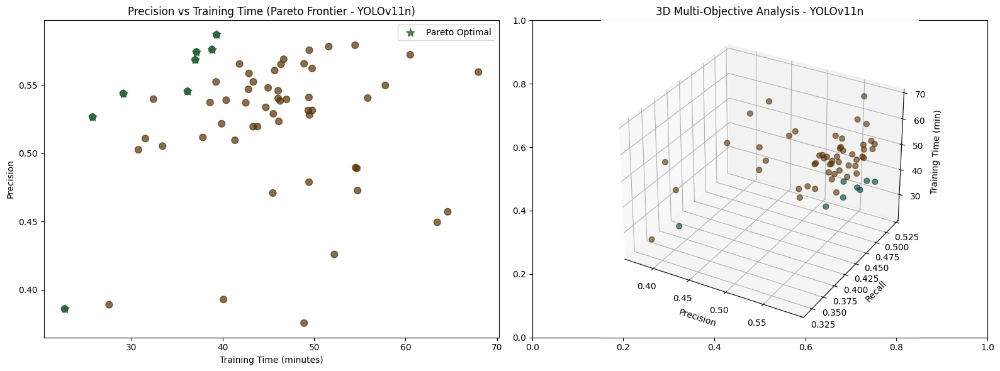


Pareto-optimal configurations:
    run_code     model  precision  recall  training_time_min optimizer  \
2   1a9un1fj  YOLOv11n     0.5455  0.4939            36.1222      auto   
16  c9k2stbs  YOLOv11n     0.5267  0.4856            25.7292       SGD   
17  dxv0bt4l  YOLOv11n     0.5745  0.4820            37.1070       SGD   
21  g7lmq7rl  YOLOv11n     0.3859  0.3801            22.6798     RAdam   
23  hgwknkgu  YOLOv11n     0.5687  0.4857            36.9715       SGD   
40  sa6u00f0  YOLOv11n     0.5871  0.4953            39.3017       SGD   
50  vn9z0c3g  YOLOv11n     0.5439  0.4968            29.0967       SGD   
53  wl12ju0o  YOLOv11n     0.5762  0.4949            38.8083       SGD   

   batch_size  
2          32  
16         32  
17         16  
21         32  
23         32  
40         32  
50         32  
53         32  


In [64]:
# =============================================================================
# 4. MULTI-OBJECTIVE ANALYSIS (PARETO FRONTIERS) - MODEL SPECIFIC
# =============================================================================

def plot_pareto_analysis(df, objectives=['metrics/precision(B)', 'training_time_min'], model_name=None):
    """
    Multi-objective analysis to identify Pareto-optimal configurations.
    If model_name is specified, filters the data for that model.

    Args:
        df (pd.DataFrame): DataFrame with run/fold metrics and hyperparameters.
        objectives (list): List of metric columns to analyze (default: precision & training time).
        model_name (str, optional): If specified, filter data for this model.
    """
    from sklearn.preprocessing import MinMaxScaler

    if model_name is not None:
        df = df[df['model'] == model_name].copy()
        print(f"Pareto analysis for model: {model_name}")

    # Prepare data: average per run
    run_data = []
    for (run, model), group in df.groupby(['run_code', 'model']):
        # Take last epoch for each fold
        fold_last = group.groupby('fold_number').last()
        
        # Select numeric columns only for averaging
        numeric_cols = fold_last.select_dtypes(include=np.number).columns
        final_metrics = fold_last[numeric_cols].mean()
        
        max_time = group['time'].max() / 60.0  # convert to minutes
        
        run_data.append({
            'run_code': run,
            'model': model,
            'precision': final_metrics['metrics/precision(B)'],
            'recall': final_metrics['metrics/recall(B)'],
            'mAP50': final_metrics['metrics/mAP50(B)'],
            'training_time_min': max_time,
            'optimizer': group['optimizer'].iloc[0],
            'batch_size': group['batch_size'].iloc[0]
        })
    
    run_df = pd.DataFrame(run_data)
    
    # Normalize for Pareto (precision: max, time: min)
    scaler = MinMaxScaler()
    pareto_data = run_df[['precision', 'training_time_min']].copy()
    pareto_data['training_time_min'] = 1 - pareto_data['training_time_min']  # invert to minimize
    pareto_normalized = scaler.fit_transform(pareto_data)
    
    # Identify Pareto-efficient points
    def is_pareto_efficient(costs):
        is_efficient = np.ones(costs.shape[0], dtype=bool)
        for i, c in enumerate(costs):
            if is_efficient[i]:
                is_efficient[is_efficient] = np.any(costs[is_efficient] > c, axis=1)
                is_efficient[i] = True
        return is_efficient
    
    pareto_mask = is_pareto_efficient(pareto_normalized)
    
    # Plot
    fig, axes = plt.subplots(1, 2, figsize=(16, 6))
    
    # Precision vs Training Time
    scatter = axes[0].scatter(run_df['training_time_min'], run_df['precision'],
                             c=pareto_mask, cmap='BrBG', s=60, alpha=0.7)
    axes[0].set_xlabel('Training Time (minutes)')
    axes[0].set_ylabel('Precision')
    axes[0].set_title(f'Precision vs Training Time (Pareto Frontier{" - " + model_name if model_name else ""})')
    
    # Highlight Pareto points
    pareto_runs = run_df[pareto_mask]
    axes[0].scatter(pareto_runs['training_time_min'], pareto_runs['precision'],
                   color=COLORS['green'], s=100, alpha=0.8, marker='*', label='Pareto Optimal')
    axes[0].legend()
    
    # 3D: Precision vs Recall vs Training Time
    ax_3d = fig.add_subplot(122, projection='3d')
    ax_3d.scatter(run_df['precision'], run_df['recall'], run_df['training_time_min'],
                  c=pareto_mask, cmap='BrBG', s=40, alpha=0.6)
    ax_3d.set_xlabel('Precision')
    ax_3d.set_ylabel('Recall')
    ax_3d.set_zlabel('Training Time (min)')
    ax_3d.set_title(f'3D Multi-Objective Analysis{" - " + model_name if model_name else ""}')
    
    plt.tight_layout()
    plt.show()
    
    print("\nPareto-optimal configurations:")
    print(pareto_runs[['run_code', 'model', 'precision', 'recall', 'training_time_min', 
                       'optimizer', 'batch_size']].round(4))
    
    return pareto_runs

# Example usage
pareto_model_runs = plot_pareto_analysis(
    df, 
    objectives=['metrics/precision(B)', 'training_time_min'], 
    model_name='YOLOv11n'
)

Pareto analysis for model: YOLOv11s


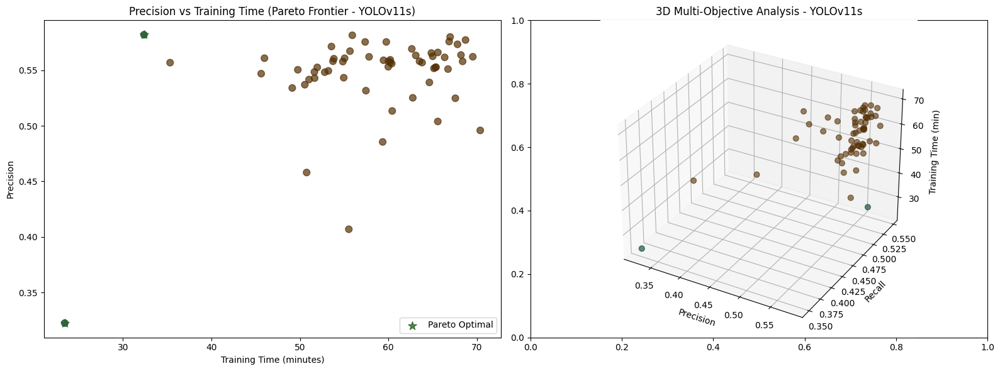


Pareto-optimal configurations:
    run_code     model  precision  recall  training_time_min optimizer  \
6   2bvvenwy  YOLOv11s     0.3224  0.3500            23.4390     RAdam   
42  o5ddl1i7  YOLOv11s     0.5820  0.5112            32.3873       SGD   

   batch_size  
6          16  
42          8  


In [65]:
pareto_model_runs = plot_pareto_analysis(df, objectives=['metrics/precision(B)', 'training_time_min'], model_name='YOLOv11s')

## 12. Detailed Learning Dynamics

### 12.1 Deep-Dive Analysis for Specific Runs

We take a detailed look at the internal learning dynamics for the best-performing runs, including the evolution of loss components, the learning rate schedule, and train-validation correlations.

**Analyzed Components:**
- **Loss Components**: Box, Classification, and DFL losses separately
- **Learning Rate Schedule**: Evolution of the learning rate across epochs
- **Loss Landscape**: Correlation between training and validation loss
- **Training Efficiency**: Time per epoch throughout training

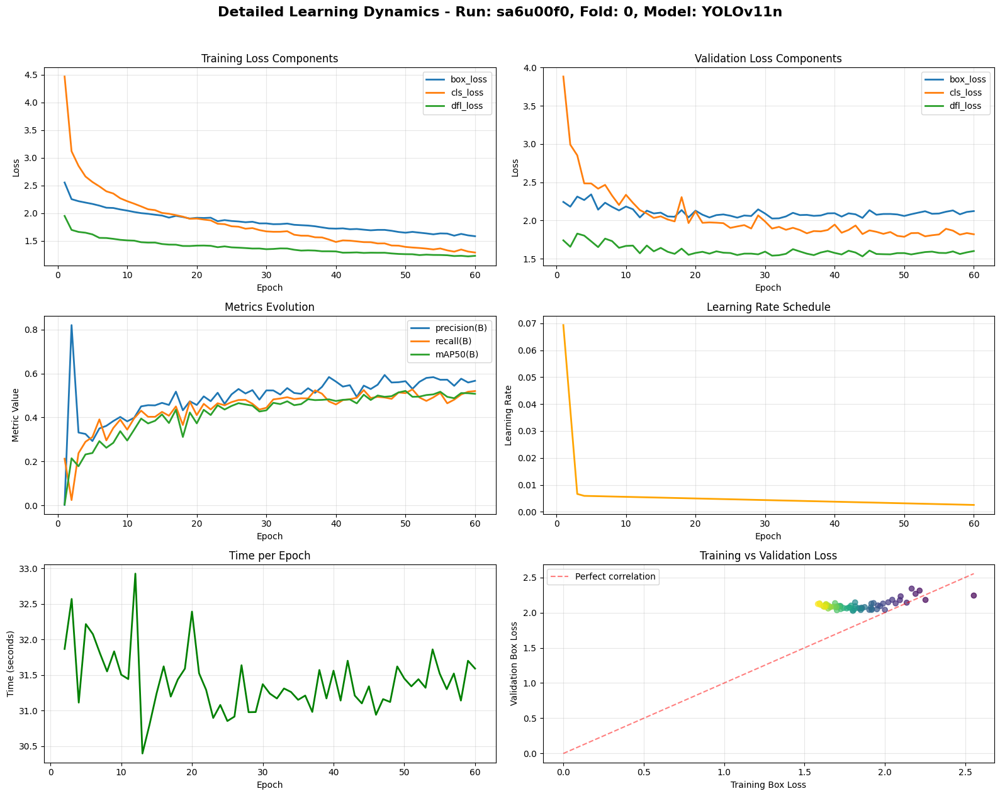

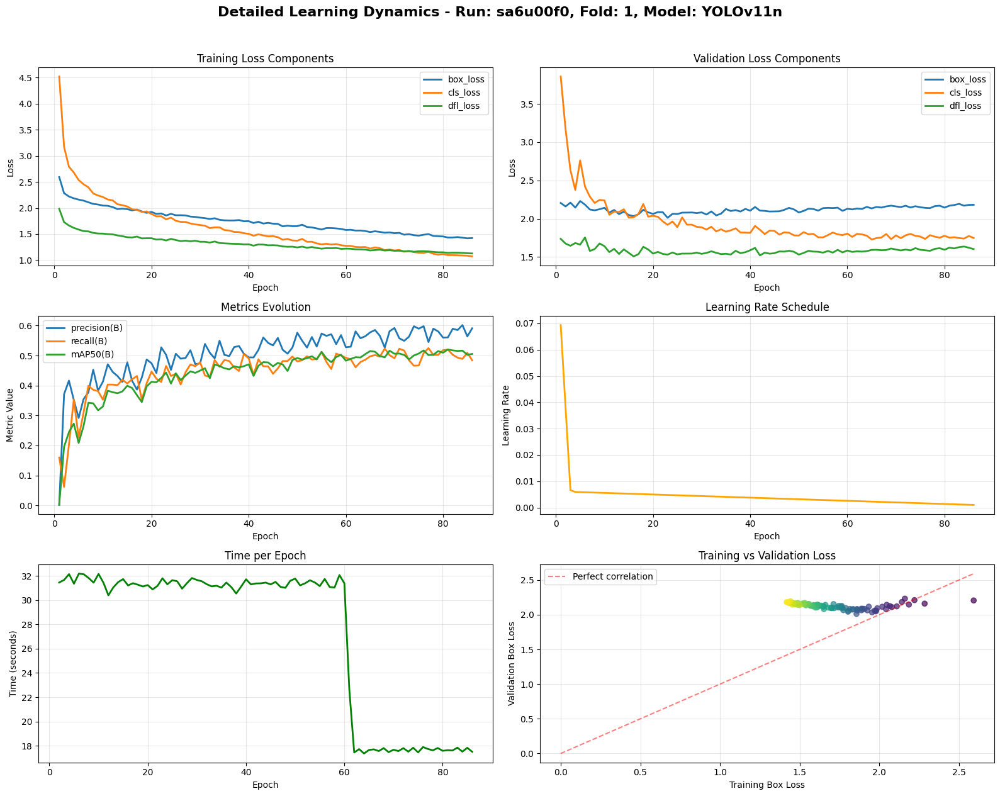

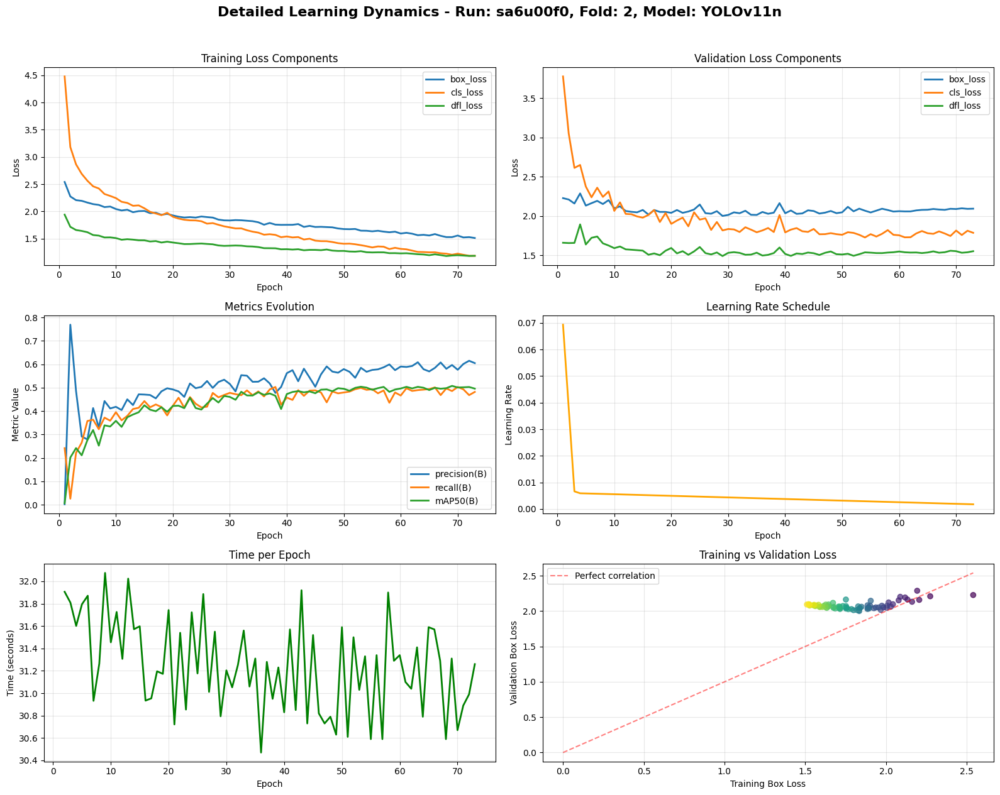

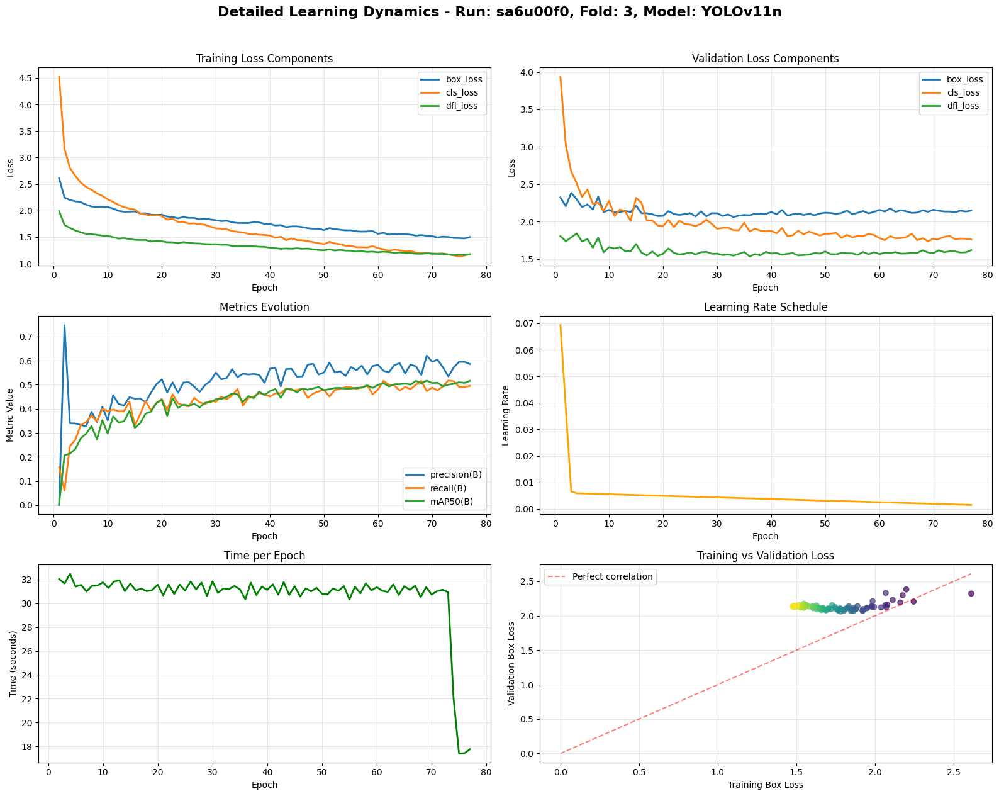

In [66]:
# =============================================================================
# 5. DETAILED LEARNING CURVES ANALYSIS
# =============================================================================

def analyze_learning_dynamics(df, run_code, model_name=None, fold=1):
    """
    Detailed analysis of learning dynamics for a specific run.
    
    Args:
        df (pd.DataFrame): DataFrame containing run/fold metrics and losses.
        run_code (str): Run identifier.
        model_name (str, optional): If specified, filter the data for this model.
        fold (int): Fold number to analyze.
    """
    # Filter by model if provided
    if model_name is not None:
        df = df[df['model'] == model_name]
    
    run_data = df[(df['run_code'] == run_code) & (df['fold_number'] == fold)].sort_values('epoch')
    
    if run_data.empty:
        print(f"No data found for run {run_code}, fold {fold}, model {model_name}")
        return
    
    fig, axes = plt.subplots(3, 2, figsize=(16, 12))
    
    epochs = run_data['epoch']
    
    # 1. Training loss components
    loss_cols = ['train/box_loss', 'train/cls_loss', 'train/dfl_loss']
    for col in loss_cols:
        if col in run_data.columns:
            axes[0,0].plot(epochs, run_data[col], label=col.split('/')[-1], linewidth=2)
    axes[0,0].set_title('Training Loss Components')
    axes[0,0].set_xlabel('Epoch')
    axes[0,0].set_ylabel('Loss')
    axes[0,0].legend()
    axes[0,0].grid(True, alpha=0.3)
    
    # 2. Validation loss components
    val_loss_cols = ['val/box_loss', 'val/cls_loss', 'val/dfl_loss']
    for col in val_loss_cols:
        if col in run_data.columns:
            axes[0,1].plot(epochs, run_data[col], label=col.split('/')[-1], linewidth=2)
    axes[0,1].set_title('Validation Loss Components')
    axes[0,1].set_xlabel('Epoch')
    axes[0,1].set_ylabel('Loss')
    axes[0,1].legend()
    axes[0,1].grid(True, alpha=0.3)
    
    # 3. Metrics evolution
    metric_cols = ['metrics/precision(B)', 'metrics/recall(B)', 'metrics/mAP50(B)']
    for col in metric_cols:
        if col in run_data.columns:
            axes[1,0].plot(epochs, run_data[col], label=col.split('/')[-1], linewidth=2)
    axes[1,0].set_title('Metrics Evolution')
    axes[1,0].set_xlabel('Epoch')
    axes[1,0].set_ylabel('Metric Value')
    axes[1,0].legend()
    axes[1,0].grid(True, alpha=0.3)
    
    # 4. Learning rate evolution (if available)
    if 'lr/pg0' in run_data.columns:
        axes[1,1].plot(epochs, run_data['lr/pg0'], color='orange', linewidth=2)
        axes[1,1].set_title('Learning Rate Schedule')
        axes[1,1].set_xlabel('Epoch')
        axes[1,1].set_ylabel('Learning Rate')
        axes[1,1].grid(True, alpha=0.3)
    
    # 5. Training dynamics (time per epoch if available)
    if 'training_time' in run_data.columns:
        axes[2,0].plot(epochs[1:], run_data['training_time'].iloc[1:], color='green', linewidth=2)
        axes[2,0].set_title('Time per Epoch')
        axes[2,0].set_xlabel('Epoch')
        axes[2,0].set_ylabel('Time (seconds)')
        axes[2,0].grid(True, alpha=0.3)
    
    # 6. Training vs validation loss scatter
    if 'train/box_loss' in run_data.columns and 'val/box_loss' in run_data.columns:
        axes[2,1].scatter(run_data['train/box_loss'], run_data['val/box_loss'], 
                         c=epochs, cmap='viridis', alpha=0.7)
        axes[2,1].plot([0, run_data['train/box_loss'].max()], 
                      [0, run_data['train/box_loss'].max()], 
                      'r--', alpha=0.5, label='Perfect correlation')
        axes[2,1].set_xlabel('Training Box Loss')
        axes[2,1].set_ylabel('Validation Box Loss')
        axes[2,1].set_title('Training vs Validation Loss')
        axes[2,1].legend()
        axes[2,1].grid(True, alpha=0.3)
    
    plt.tight_layout()
    plt.suptitle(f'Detailed Learning Dynamics - Run: {run_code}, Fold: {fold}' + 
                 (f', Model: {model_name}' if model_name else ''), fontsize=16, y=1.05, fontweight='bold')
    plt.show()


# Example usage: analyze best run for a specific model
best_n_run = find_best_run(df, 'metrics/precision(B)', model_name='YOLOv11n')
if best_n_run:
    for fold in range(4):
        analyze_learning_dynamics(df, best_n_run['run_code'], model_name='YOLOv11n', fold=fold)

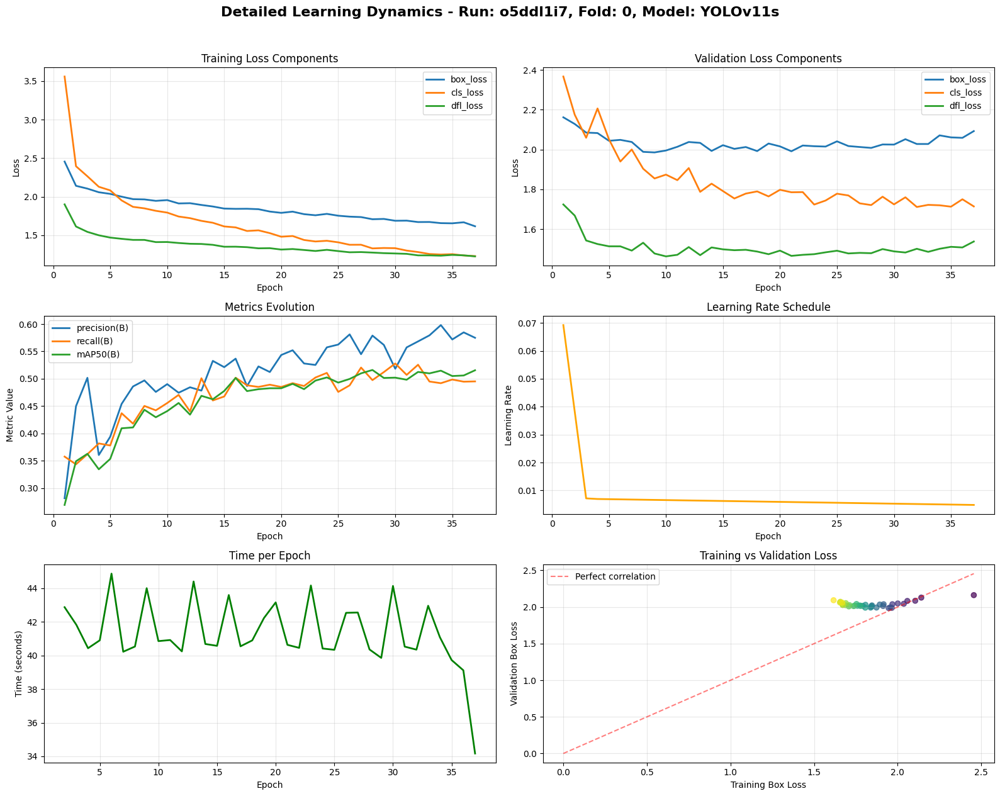

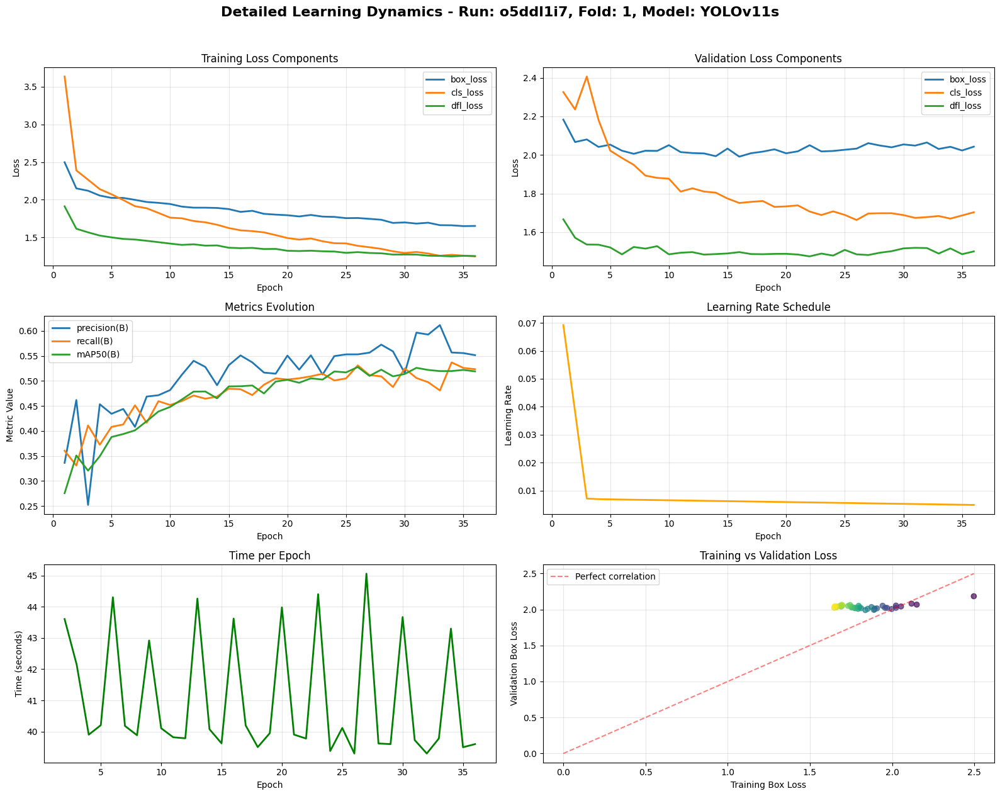

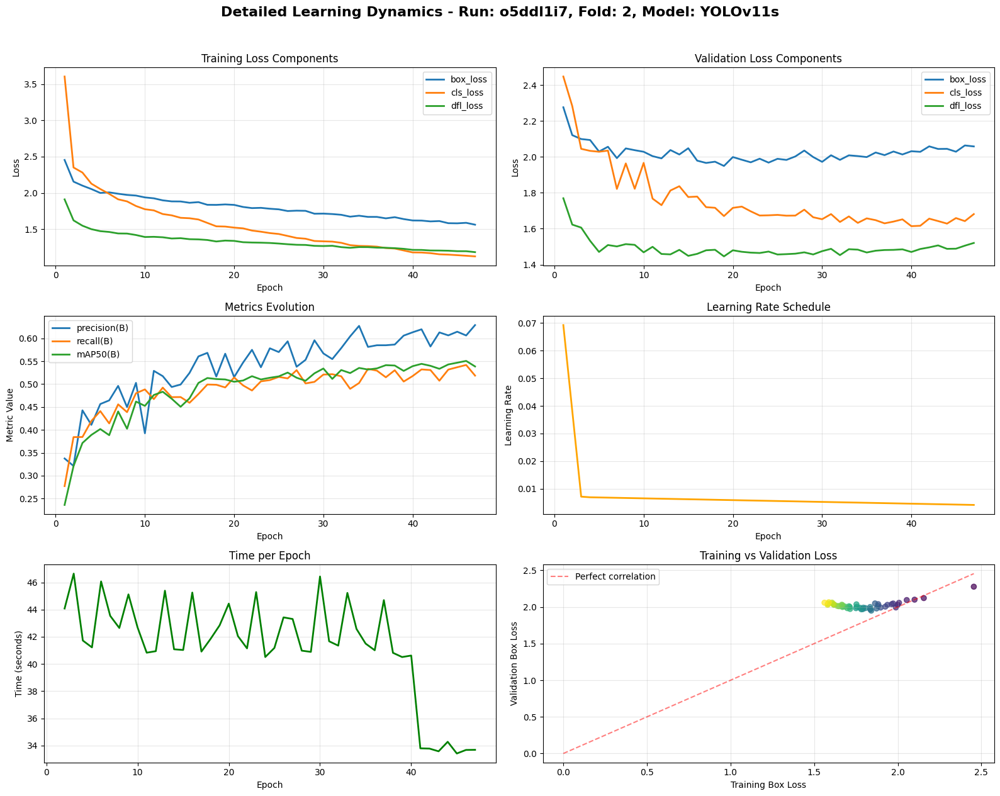

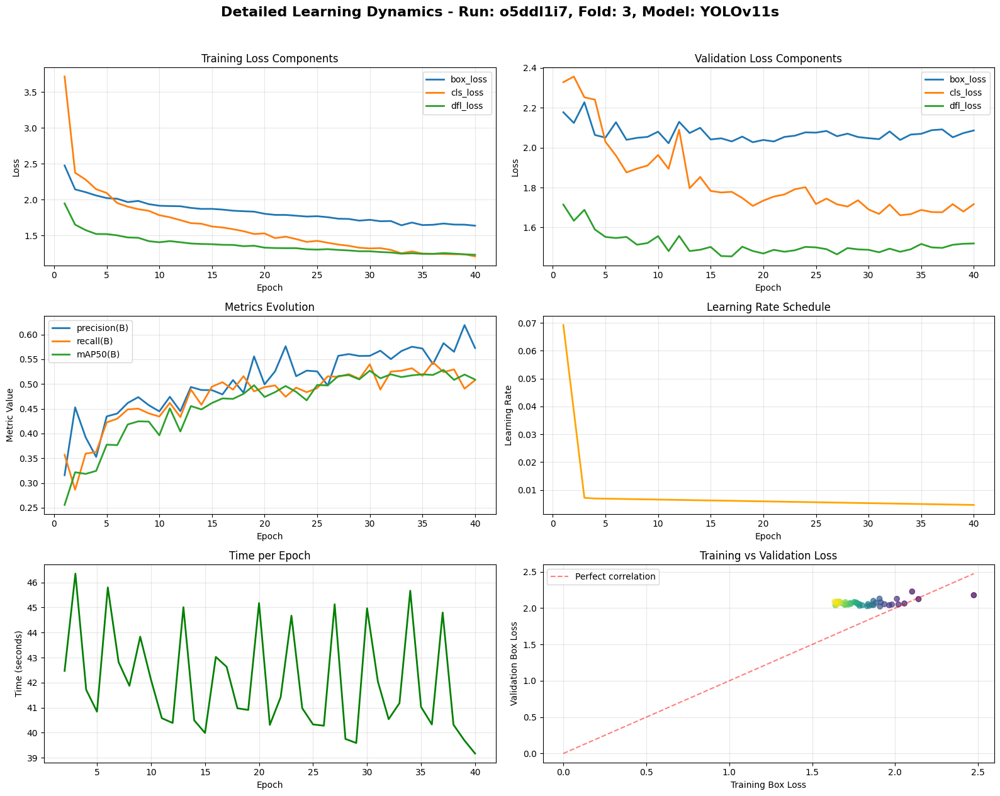

In [67]:
best_s_run = find_best_run(df, 'metrics/precision(B)', model_name='YOLOv11s')
if best_s_run:
    for fold in range(4):
        analyze_learning_dynamics(df, best_s_run['run_code'], model_name='YOLOv11s', fold=fold)

## 13. Cross-Fold Robustness

### 13.1 Stability Analysis Across Folds

We evaluate how robust the configurations are with respect to different data splits, identifying setups that consistently perform well across folds.

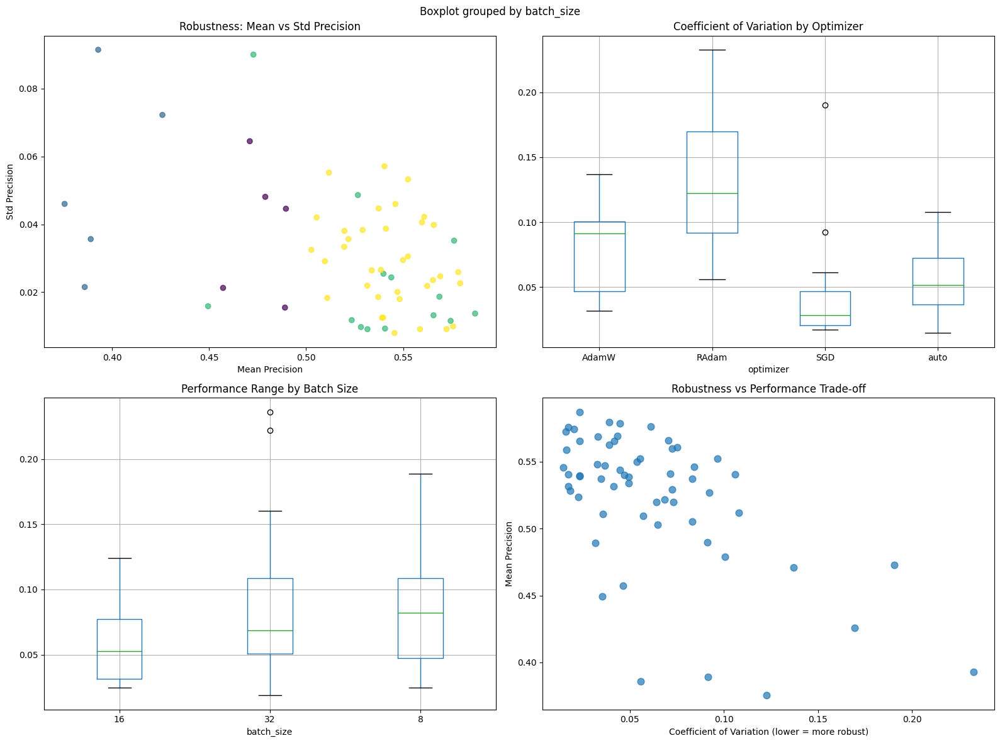

Top 5 most robust configurations for model YOLOv11n:
    run_code  mean_precision  cv_precision optimizer batch_size
2   1a9un1fj        0.545535      0.014599      auto         32
13  aqgo5wh6        0.572377      0.015947      auto         16
26  lxlf0mcb        0.558690      0.016274      auto         32
49  vkkj55k7        0.531597      0.017082       SGD         16
3   1p6hj2dk        0.540632      0.017136       SGD          8


In [68]:
# =============================================================================
# 6. CROSS-FOLD ROBUSTNESS ANALYSIS - MODEL-SPECIFIC
# =============================================================================

def analyze_cross_fold_robustness(df, model_name=None):
    """
    Analyzes the robustness of configurations across folds.
    Allows filtering the data for a specific model.
    """
    if model_name is not None:
        df = df[df['model'] == model_name].copy()
    
    robustness_analysis = []
    
    for run, group in df.groupby('run_code'):
        fold_performances = []
        for fold, fold_data in group.groupby('fold_number'):
            final_precision = fold_data['metrics/precision(B)'].iloc[-1]
            fold_performances.append(final_precision)
        
        if len(fold_performances) >= 2:
            robustness_analysis.append({
                'run_code': run,
                'model': group['model'].iloc[0],
                'mean_precision': np.mean(fold_performances),
                'std_precision': np.std(fold_performances),
                'cv_precision': np.std(fold_performances) / np.mean(fold_performances),
                'min_precision': np.min(fold_performances),
                'max_precision': np.max(fold_performances),
                'range_precision': np.max(fold_performances) - np.min(fold_performances),
                'optimizer': group['optimizer'].iloc[0],
                'batch_size': group['batch_size'].iloc[0],
                'lr0': group['lr0'].iloc[0]
            })
    
    rob_df = pd.DataFrame(robustness_analysis)
    
    # ---------------------------
    # Visualization
    # ---------------------------
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # Robustness: Mean vs Std Precision
    axes[0,0].scatter(rob_df['mean_precision'], rob_df['std_precision'], 
                     c=rob_df['optimizer'].astype('category').cat.codes, alpha=0.7)
    axes[0,0].set_xlabel('Mean Precision')
    axes[0,0].set_ylabel('Std Precision')
    axes[0,0].set_title('Robustness: Mean vs Std Precision')
    
    # Coefficient of variation by optimizer
    rob_df.boxplot(column='cv_precision', by='optimizer', ax=axes[0,1])
    axes[0,1].set_title('Coefficient of Variation by Optimizer')
    
    # Performance range by batch size
    rob_df.boxplot(column='range_precision', by='batch_size', ax=axes[1,0])
    axes[1,0].set_title('Performance Range by Batch Size')
    
    # Scatter Robustness vs Performance
    axes[1,1].scatter(rob_df['cv_precision'], rob_df['mean_precision'], 
                     alpha=0.7, s=60)
    axes[1,1].set_xlabel('Coefficient of Variation (lower = more robust)')
    axes[1,1].set_ylabel('Mean Precision')
    axes[1,1].set_title('Robustness vs Performance Trade-off')
    
    plt.tight_layout()
    plt.show()
    
    # Top configurations by robustness
    print(f"Top 5 most robust configurations for model {model_name}:")
    print(rob_df.nsmallest(5, 'cv_precision')[['run_code', 'mean_precision', 'cv_precision', 'optimizer', 'batch_size']])
    
    return rob_df

robustness_yolo_df = analyze_cross_fold_robustness(df, model_name='YOLOv11n')

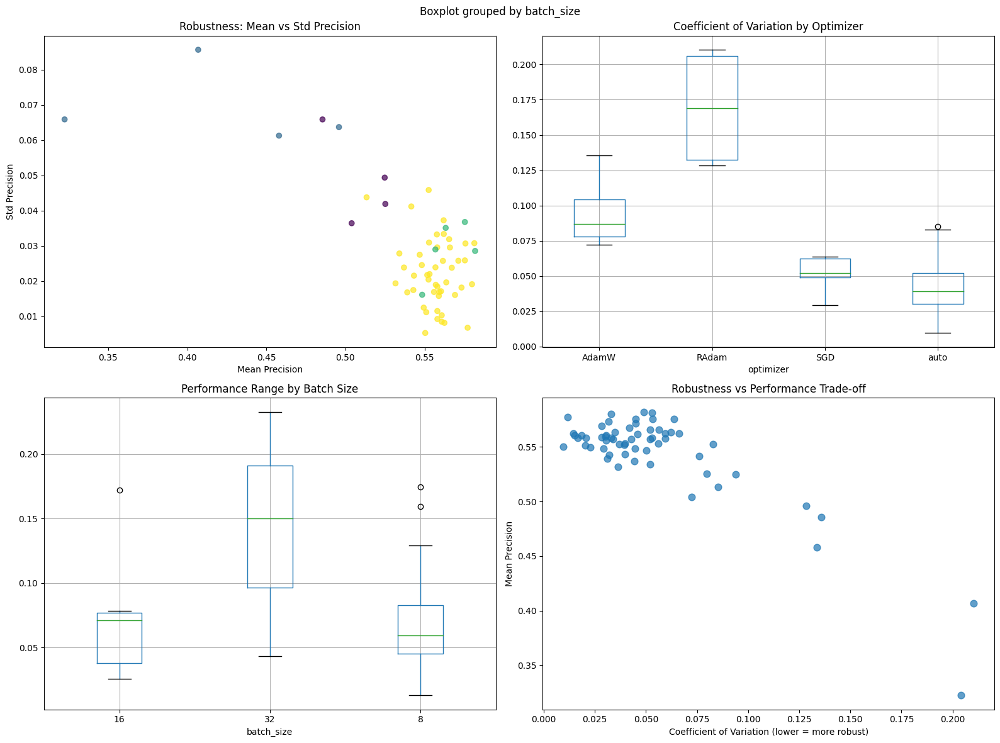

Top 5 most robust configurations for model YOLOv11s:
    run_code  mean_precision  cv_precision optimizer batch_size
0   01xo4bmy        0.550467      0.009591      auto          8
27  ance8hds        0.577273      0.011722      auto          8
21  7pmcj4ca        0.562600      0.014490      auto          8
23  8mvl6sog        0.560885      0.015131      auto          8
2   0kxybb2v        0.558148      0.016557      auto         16


In [69]:
robustness_yolo_df = analyze_cross_fold_robustness(df, model_name='YOLOv11s')

## 14. Sensitivity Analysis

### 14.1 Marginal Impact of Hyperparameters

We isolate the effect of individual hyperparameters while keeping the others fixed, to understand which parameters have the greatest marginal impact on performance.

**Methodology:**
- **Baseline Configuration**: Median values as reference  
- **Single Variation**: Modify one parameter at a time  
- **Distance Weighting**: Give priority to runs more similar to the baseline  

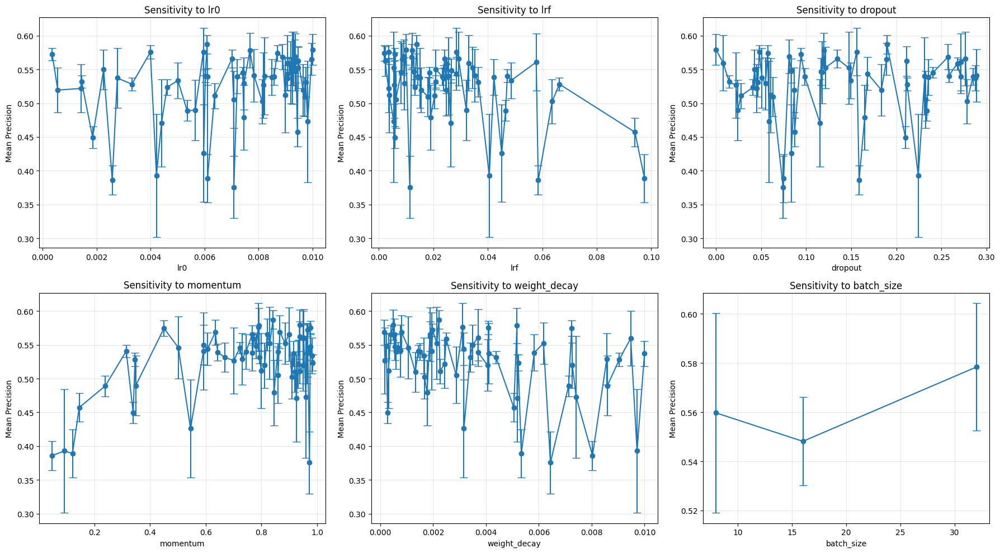

In [70]:
# =============================================================================
# 7. SENSITIVITY/ABLATION ANALYSIS - MODEL-SPECIFIC
# =============================================================================

def sensitivity_analysis(df, model_name=None, base_config=None, param_ranges=None):
    """
    Sensitivity analysis to understand the effect of individual hyperparameters,
    filtering the DataFrame for a specific model.
    """
    if model_name is not None:
        df = df[df['model'] == model_name].copy()
    
    numeric_cols = ['lr0', 'lrf', 'dropout', 'momentum', 'weight_decay', 'batch_size']
    
    # Convert numeric columns to float if needed
    for col in numeric_cols:
        if col in df.columns:
            df[col] = pd.to_numeric(df[col], errors='coerce')

    if base_config is None:
        # Use median configuration as baseline
        base_config = {}
        for col in numeric_cols:
            if col in df.columns:
                base_config[col] = df[col].median()
        base_config['optimizer'] = df['optimizer'].mode()[0]
    
    sensitivity_results = {}
    
    for param in base_config.keys():
        if param == 'optimizer':
            continue  # Skip categorical for now
            
        param_effects = []
        unique_values = sorted(df[param].dropna().unique())
        
        for value in unique_values:
            subset = df[df[param] == value].copy()
            if subset.empty:
                continue
                
            subset['config_distance'] = 0
            for other_param, base_val in base_config.items():
                if other_param != param and other_param in subset.columns:
                    if other_param == 'optimizer':
                        subset['config_distance'] += (subset[other_param] != base_val).astype(int)
                    else:
                        subset['config_distance'] += np.abs(subset[other_param] - base_val)
            
            closest_runs = subset.nsmallest(5, 'config_distance')['run_code'].unique()
            
            performances = []
            for run in closest_runs:
                run_data = df[df['run_code'] == run]
                for fold, fold_data in run_data.groupby('fold_number'):
                    final_perf = fold_data['metrics/precision(B)'].iloc[-1]
                    performances.append(final_perf)
            
            if performances:
                param_effects.append({
                    'param_value': value,
                    'mean_performance': np.mean(performances),
                    'std_performance': np.std(performances),
                    'n_samples': len(performances)
                })
        
        sensitivity_results[param] = pd.DataFrame(param_effects)
    
    # ---------------------------
    # Visualization
    # ---------------------------
    n_params = len(sensitivity_results)
    fig, axes = plt.subplots(2, 3, figsize=(18, 10))
    axes = axes.flatten()
    
    for i, (param, results) in enumerate(sensitivity_results.items()):
        if i >= len(axes):
            break
        ax = axes[i]
        ax.errorbar(results['param_value'], results['mean_performance'], 
                   yerr=results['std_performance'], marker='o', capsize=5)
        ax.set_xlabel(param)
        ax.set_ylabel('Mean Precision')
        ax.set_title(f'Sensitivity to {param}')
        ax.grid(True, alpha=0.3)
    
    for j in range(len(sensitivity_results), len(axes)):
        axes[j].set_visible(False)
    
    plt.tight_layout()
    plt.show()
    
    return sensitivity_results

# Example usage for a specific model
sensitivity_results_yolo = sensitivity_analysis(df, model_name='YOLOv11n')

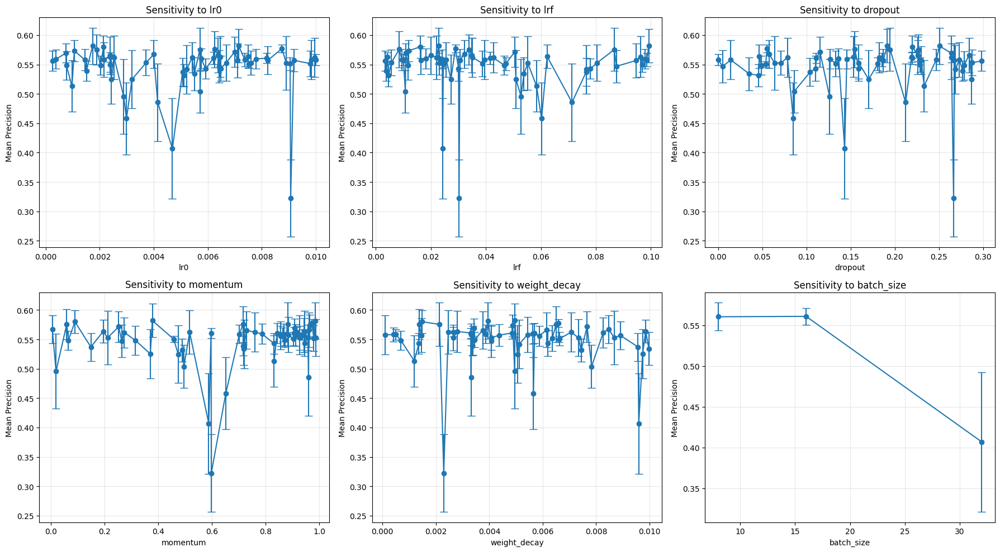

In [71]:
sensitivity_results_yolo = sensitivity_analysis(df, model_name='YOLOv11s')

## 15. Ensemble Potential

### 15.1 Analysis of Complementarity Between Models

We evaluate the potential of combining the best runs into ensembles, analyzing the diversity of configurations and the complementarity of predictions.  

Top 5 runs by precision (model: YOLOv11n):
    run_code     model  mean_precision  mean_recall  mean_map50
40  sa6u00f0  YOLOv11n        0.587070     0.495298    0.506247
36  ptyk0oqv  YOLOv11n        0.579370     0.496883    0.509832
4   1xk0qyct  YOLOv11n        0.578377     0.507583    0.516387
53  wl12ju0o  YOLOv11n        0.576240     0.494935    0.497400
52  vwtbko8r  YOLOv11n        0.575710     0.507520    0.512060


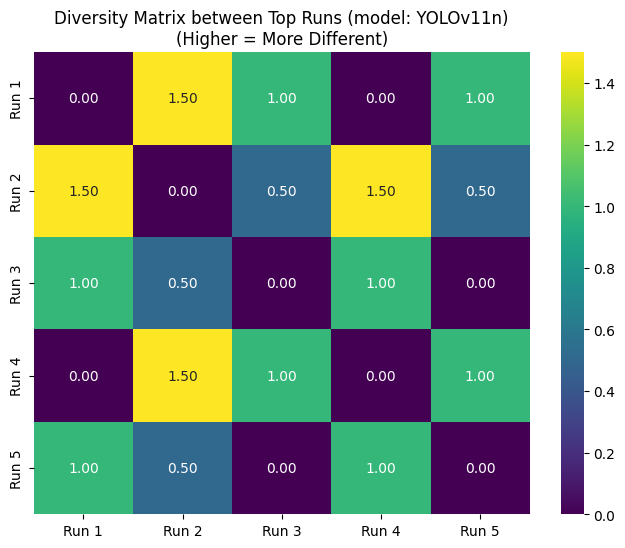

In [72]:
# =============================================================================
# 8. ENSEMBLE POTENTIAL ANALYSIS - MODEL SPECIFIC
# =============================================================================

def analyze_ensemble_potential(df, top_k=5, model_name=None):
    """
    Analyze the ensemble potential by combining the best runs.
    Allows filtering by a specific model.

    Args:
        df (pd.DataFrame): DataFrame containing run metrics and configurations.
        top_k (int): Number of top runs to consider.
        model_name (str, optional): Specific model to filter. Defaults to None.

    Returns:
        pd.DataFrame: Top runs based on mean precision.
        np.ndarray: Diversity matrix between top runs.
    """
    if model_name is not None:
        df = df[df['model'] == model_name].copy()
    
    # Ensure batch_size is numeric
    df['batch_size'] = df['batch_size'].astype(int)

    # Find top-k runs by precision
    run_performances = []
    for run, group in df.groupby('run_code'):
        fold_perfs = []
        for fold, fold_data in group.groupby('fold_number'):
            final_perf = fold_data['metrics/precision(B)'].iloc[-1]
            fold_perfs.append(final_perf)
        
        if fold_perfs:
            run_performances.append({
                'run_code': run,
                'model': group['model'].iloc[0],
                'mean_precision': np.mean(fold_perfs),
                'mean_recall': np.mean([fold_data['metrics/recall(B)'].iloc[-1] 
                                        for fold, fold_data in group.groupby('fold_number')]),
                'mean_map50': np.mean([fold_data['metrics/mAP50(B)'].iloc[-1] 
                                       for fold, fold_data in group.groupby('fold_number')]),
                'optimizer': group['optimizer'].iloc[0],
                'batch_size': group['batch_size'].iloc[0]
            })
    
    perf_df = pd.DataFrame(run_performances)
    top_runs = perf_df.nlargest(top_k, 'mean_precision')
    
    print(f"Top {top_k} runs by precision (model: {model_name}):")
    print(top_runs[['run_code', 'model', 'mean_precision', 'mean_recall', 'mean_map50']])
    
    # Ensemble diversity analysis
    diversity_matrix = np.zeros((top_k, top_k))
    
    for i, run1 in enumerate(top_runs['run_code']):
        for j, run2 in enumerate(top_runs['run_code']):
            if i != j:
                # Compute diversity based on configuration
                config1 = top_runs.iloc[i]
                config2 = top_runs.iloc[j]
                
                diversity = 0
                diversity += (config1['model'] != config2['model'])
                diversity += (config1['optimizer'] != config2['optimizer'])
                diversity += abs(config1['batch_size'] - config2['batch_size']) / max(config1['batch_size'], config2['batch_size'])
                
                diversity_matrix[i, j] = diversity
    
    # Plot diversity
    plt.figure(figsize=(8, 6))
    sns.heatmap(diversity_matrix, annot=True, fmt='.2f', cmap='viridis',
                xticklabels=[f"Run {i+1}" for i in range(top_k)],
                yticklabels=[f"Run {i+1}" for i in range(top_k)])
    plt.title(f'Diversity Matrix between Top Runs (model: {model_name})\n(Higher = More Different)')
    plt.show()
    
    return top_runs, diversity_matrix

# Example usage
top_runs, diversity_matrix = analyze_ensemble_potential(df, top_k=5, model_name='YOLOv11n')

Top 5 runs by precision (model: YOLOv11s):
    run_code     model  mean_precision  mean_recall  mean_map50
42  o5ddl1i7  YOLOv11s        0.582000     0.511218    0.520525
54  w7esvjza  YOLOv11s        0.581523     0.527353    0.523822
35  jc5zb53p  YOLOv11s        0.580035     0.525587    0.526512
27  ance8hds  YOLOv11s        0.577273     0.533575    0.531402
57  ymiaexm9  YOLOv11s        0.575880     0.521785    0.525900


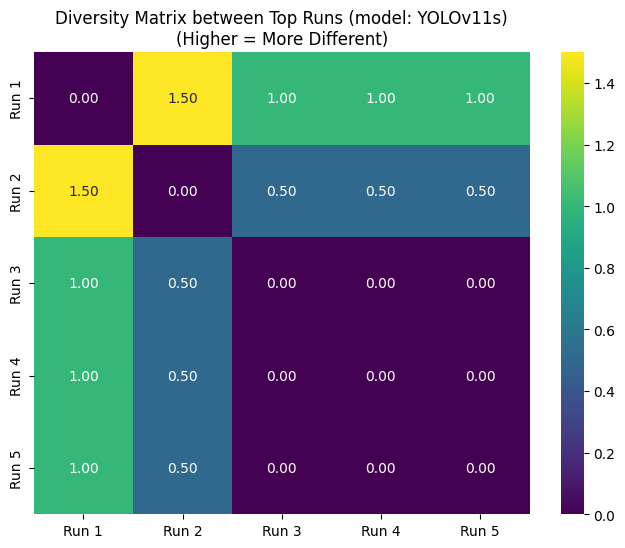

In [73]:
top_runs, diversity_matrix = analyze_ensemble_potential(df, top_k=5, model_name='YOLOv11s')

**Diversity Metrics:**
- **Architectural Diversity**: Differences between models (YOLOv11n vs YOLOv11s)  
- **Hyperparameter Diversity**: Distance between configurations  
- **Diversity Matrix**: Heatmap of differences among top performers  

## 17. Temporal Stability

### 17.1 Final Convergence Analysis

We examine the stability of performance in the last epochs to identify configurations that have reached true convergence versus those still improving.

**Stability Indicators:**
- **Trend Slope**: Direction of the trend in the final epochs  
- **Variability**: Metric fluctuations in the final window  
- **Convergence Quality**: Quality of the convergence achieved  

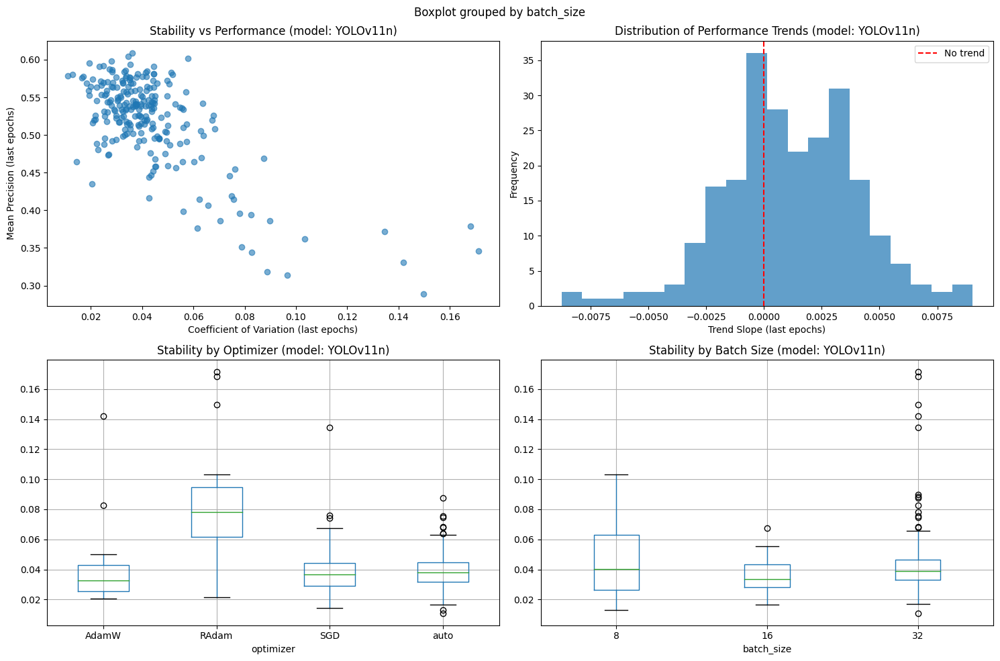

In [74]:
# =============================================================================
# 9. TEMPORAL STABILITY ANALYSIS - MODEL SPECIFIC
# =============================================================================

def analyze_temporal_stability(df, window_size=10, model_name=None):
    """
    Analyze the temporal stability of performance over the last epochs.
    Allows filtering by a specific model.

    Args:
        df (pd.DataFrame): DataFrame containing run metrics and configurations.
        window_size (int): Number of last epochs to consider for stability analysis.
        model_name (str, optional): Specific model to filter. Defaults to None.

    Returns:
        pd.DataFrame: DataFrame with stability metrics for each run and fold.
    """
    if model_name is not None:
        df = df[df['model'] == model_name].copy()
    
    # Ensure batch_size is numeric
    df['batch_size'] = df['batch_size'].astype(int)
    
    stability_analysis = []
    
    for (run, fold), group in df.groupby(['run_code', 'fold_number']):
        group = group.sort_values('epoch')
        
        if len(group) < window_size * 2:
            continue
        
        # Take the last window_size epochs
        last_window = group.tail(window_size)
        precision_values = last_window['metrics/precision(B)'].values
        
        # Compute stability metrics
        stability_metrics = {
            'run_code': run,
            'fold_number': fold,
            'mean_precision': np.mean(precision_values),
            'std_precision': np.std(precision_values),
            'cv_precision': np.std(precision_values) / np.mean(precision_values),
            'trend_slope': np.polyfit(range(len(precision_values)), precision_values, 1)[0],
            'total_epochs': len(group),
            'optimizer': group['optimizer'].iloc[0],
            'batch_size': group['batch_size'].iloc[0]
        }
        
        stability_analysis.append(stability_metrics)
    
    stab_df = pd.DataFrame(stability_analysis)
    
    # ---------------------------
    # Visualization
    # ---------------------------
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    
    # Stability vs Performance
    axes[0,0].scatter(stab_df['cv_precision'], stab_df['mean_precision'], alpha=0.6)
    axes[0,0].set_xlabel('Coefficient of Variation (last epochs)')
    axes[0,0].set_ylabel('Mean Precision (last epochs)')
    axes[0,0].set_title(f'Stability vs Performance (model: {model_name})')
    
    # Trend analysis
    axes[0,1].hist(stab_df['trend_slope'], bins=20, alpha=0.7)
    axes[0,1].set_xlabel('Trend Slope (last epochs)')
    axes[0,1].set_ylabel('Frequency')
    axes[0,1].set_title(f'Distribution of Performance Trends (model: {model_name})')
    axes[0,1].axvline(0, color='red', linestyle='--', label='No trend')
    axes[0,1].legend()
    
    # Stability by optimizer
    stab_df.boxplot(column='cv_precision', by='optimizer', ax=axes[1,0])
    axes[1,0].set_title(f'Stability by Optimizer (model: {model_name})')
    
    # Stability by batch size
    stab_df.boxplot(column='cv_precision', by='batch_size', ax=axes[1,1])
    axes[1,1].set_title(f'Stability by Batch Size (model: {model_name})')
    
    plt.tight_layout()
    plt.show()
    
    return stab_df

# Example usage
stability_df = analyze_temporal_stability(df, window_size=10, model_name='YOLOv11n')

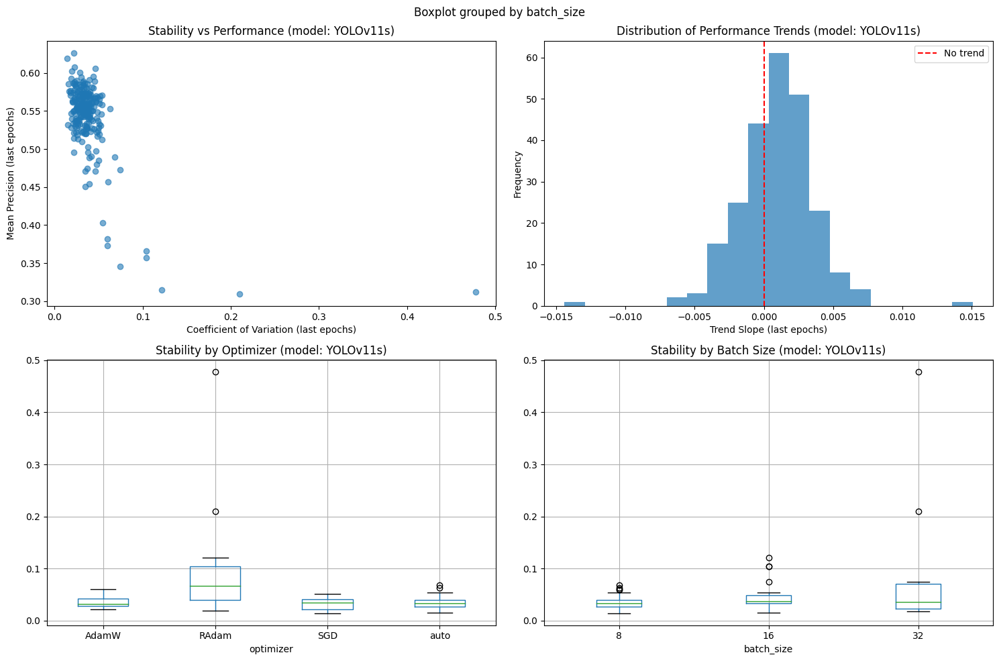

In [75]:
stability_df = analyze_temporal_stability(df, window_size=10, model_name='YOLOv11s')